## Polecenie
Zadanie polega na stworzeniu modelu generatywnego, który generował będzie nowe obrazki przedstawiające znaki drogowe. Zbiór danych ma strukturę zgodną z domyślnymi ustawieniami ImageFolderu. Znaki podzielone są na klasy, które można wykorzystywać do generowania próbek.
Zamiast predykcji konieczne jest zwrócenie przykładowycj 1000 wygenerowanych za pomocą stworzonej metody próbek.
- Wygenerowane obrazki należy zapisać w formie torchowego tensora (na cpu, po detach, czyli np. wykonując komendę torch.save(generated_imgs.cpu().detach(),"nazwa.pt")). Tensor zgodnie z konwencją powinien mieć wymiary [1000,3,32,32].

Ewaluacja:
- Wygenerowane obrazki porównywane będą do zbioru testowego za pomocą metryki Frechet Inception Distance. https://github.com/mseitzer/pytorch-fid
- W zbiorze testowym obrazki mają podobny rozkład klas jak w treningowym.
- Należy pamiętać o denormalizacji próbek.

## Przygotowania

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as Functional
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms
from torch.utils.data import SubsetRandomSampler
from sklearn.model_selection import train_test_split
from collections import Counter
from torchvision.utils import save_image
from pathlib import Path

In [2]:
torch.cuda.set_device(0)
device = torch.device("cuda")
torch.cuda.is_available()

True

In [3]:
if torch.cuda.is_available():
    torch.cuda.manual_seed(500)
    torch.cuda.manual_seed_all(500)

torch.manual_seed(500)

torch.backends.cudnn.determinstic = True
torch.backends.cudnn.benchmark = False

## Zbiór danych

Normalizacja wykonywana będzie na statystykach zebranych bezpośrednio na zbiorze. Do jej zebrania powstała funkcja count_dataset_stats.

In [4]:
def count_dataset_stats(inp_dataset: torchvision.datasets.ImageFolder, n_channels: int = 3, batch_size: int=32) -> tuple[
    list, list]:
    """
    Function counts mean and standard deviation for each channel in dataset
    :param inp_dataset: dataset to count stats on
    :param n_channels: number of channels in dataset
    :param batch_size: size of batch in calculations
    :return:
        means - list of means for each channel
        stds - list of standard deviations for each channel
    """
    inp_dataloader = torch.utils.data.DataLoader(inp_dataset, batch_size=batch_size, shuffle=False)
    sums_sq = [0.0, 0.0, 0.0]
    stds = [0.0, 0.0, 0.0]
    means = [0.0, 0.0, 0.0]
    counts = [0.0, 0.0, 0.0]
    sums = [0.0, 0.0, 0.0]
    for index, data in enumerate(inp_dataloader):
        data_img = data[0]
        for ch_ind in range(n_channels):
            data_img_ch = data_img[:, ch_ind]
            counts[ch_ind] += np.prod(data_img_ch.shape)
            sums[ch_ind] += data_img_ch.sum()
    for ch_ind in range(n_channels):
        means[ch_ind] = sums[ch_ind] / counts[ch_ind]
    for index, data in enumerate(inp_dataloader):
        data_img = data[0]
        for ch_ind in range(n_channels):
            data_img_ch = data_img[:, ch_ind]
            sums_sq[ch_ind] += ((data_img_ch - means[ch_ind])**2).sum()
    for ch_ind in range(n_channels):
        stds[ch_ind] = np.sqrt(sums_sq[ch_ind] / counts[ch_ind]).item()
        means[ch_ind] = means[ch_ind].item()
    return (means, stds)

In [5]:
dataset_not_normalized = torchvision.datasets.ImageFolder("data/", transform=transforms.ToTensor())

In [6]:
mean_dataset, stdd_dataset = count_dataset_stats(dataset_not_normalized)
print(f"Channels means: {mean_dataset}, channels stds: {stdd_dataset}")

Channels means: [0.31852805614471436, 0.29300791025161743, 0.30163708329200745], channels stds: [0.2762238681316376, 0.26541516184806824, 0.26857253909111023]


In [24]:
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize(mean_dataset, stdd_dataset)]
)

Wydzielamy mały zbiór walidacyjny.

In [25]:
VALID_SIZE = 0.05
SEED = 500

In [26]:
full_dataset = torchvision.datasets.ImageFolder("data/", transform=transform)

train_indices, test_indices, _, _ = train_test_split(
    range(len(full_dataset)),
    full_dataset.targets,
    stratify=full_dataset.targets,
    test_size=VALID_SIZE,
    random_state=SEED
)

train_subset = torch.utils.data.Subset(full_dataset, train_indices)
valid_subset = torch.utils.data.Subset(full_dataset, test_indices)


In [27]:
BATCH_SIZE = 128
train_loader = torch.utils.data.DataLoader(train_subset, batch_size=BATCH_SIZE, shuffle=True)
valid_loader = torch.utils.data.DataLoader(valid_subset, batch_size=BATCH_SIZE, shuffle=True)

tensor([10,  3, 14, 30, 10, 31, 19,  4,  1,  1,  1, 33,  9, 36, 35,  3, 13, 20,
         2,  4,  5,  9, 42, 39, 13,  4,  4, 11, 34,  7, 38, 17, 26, 17, 21, 11,
        31, 12,  9, 38, 35,  2, 33,  1,  6, 31, 17, 13, 12,  2, 33, 13, 17,  5,
        16, 33, 13, 25, 20,  1, 31, 35, 23,  5,  1, 19,  7,  3, 12, 40,  3, 32,
        41, 18,  4, 26, 10,  5,  2,  3,  4, 36, 13, 34,  7, 28,  4,  2, 25, 20,
         1,  2,  7,  1,  1, 13, 26,  5, 11, 25, 18,  2, 25,  9, 13, 35, 22, 10,
        35,  2, 14, 13, 12, 28,  7,  2, 32,  9,  1, 35,  7, 14, 13, 31, 18,  2,
         1, 12])


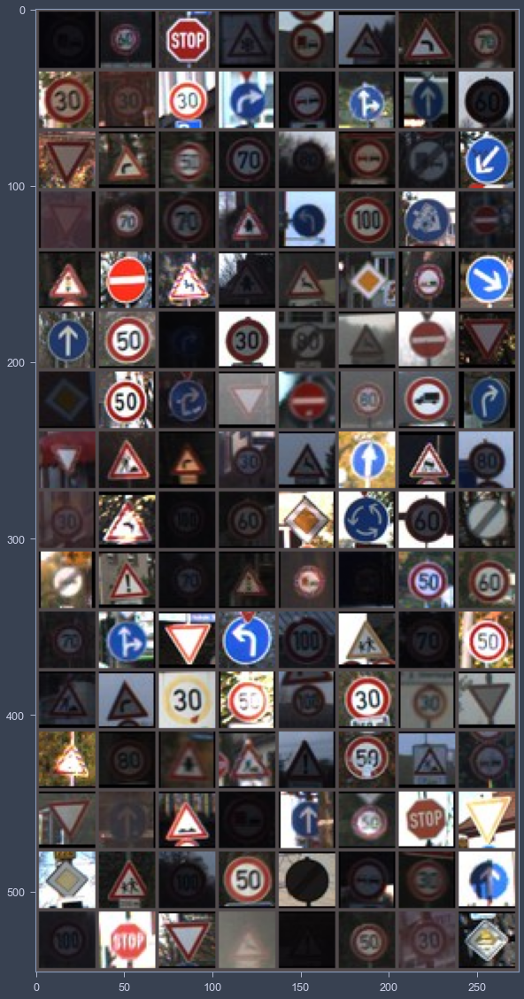

In [28]:
plt.figure(figsize=(10, 20))

def imshow(img):
    for ch in range(3):
        img[ch] = img[ch] * stdd_dataset[ch] + mean_dataset[ch]
    np_img = img.numpy()
    plt.imshow(np.transpose(np_img, (1, 2, 0)))
    plt.show()

dataiter = iter(train_loader)
images, labels = dataiter.next()
print(labels)
imshow(torchvision.utils.make_grid(images))

tensor([11, 18,  4, 10, 39,  2, 32, 15,  3, 38, 12, 19,  9, 32,  4,  3,  4,  2,
         1,  2,  7, 15,  8, 12,  3,  8, 12, 10,  5, 26, 12, 40, 23,  1, 38, 11,
        18, 12, 15, 24, 21, 23, 19, 38, 14,  5, 12, 18,  2, 27, 25,  2, 38, 25,
         3,  8, 38,  2,  2,  3, 17, 36, 11, 27,  5,  2, 18, 13,  0, 11,  7,  2,
         4, 16, 35, 33,  0, 18,  5,  9,  7, 30, 10, 13, 31,  2,  7,  9, 31, 41,
         1,  7, 22, 13, 38, 15, 17, 35, 38, 30,  7, 21, 12, 19, 14, 28, 12, 23,
         1,  3,  8,  2,  8, 38, 12,  8, 12, 25, 28, 40, 14, 17, 42, 22, 34, 20,
        11, 12])


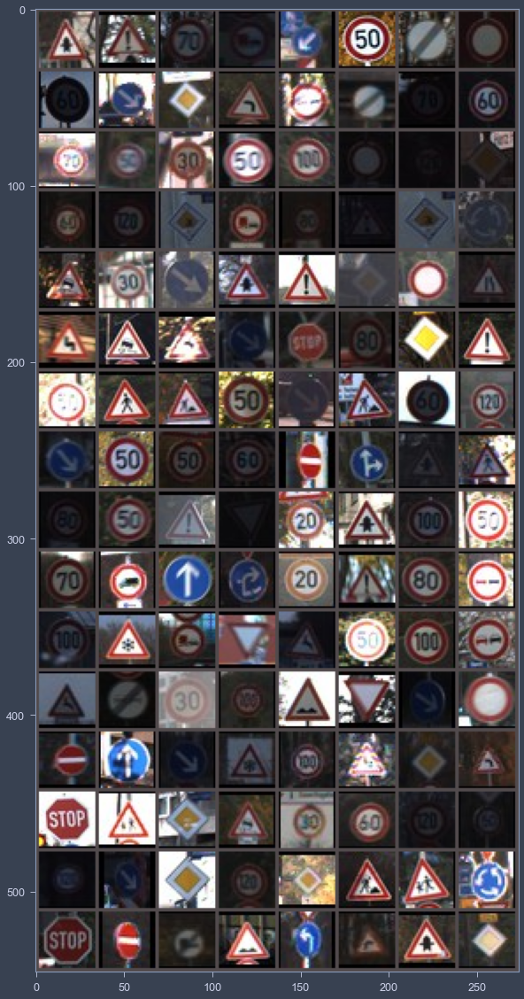

In [29]:
plt.figure(figsize=(10, 20))
dataiter = iter(valid_loader)
images, labels = dataiter.next()
print(labels)
imshow(torchvision.utils.make_grid(images))

## Model

In [30]:
numb_classess = len(full_dataset.classes)
numb_classess

43

In [31]:
class SignsEncoder(nn.Module):

    def __init__(self, latent_dim, n_of_classess):
        super().__init__()
        self.conv1 = nn.Conv2d(in_channels=3, out_channels=20, kernel_size=(2,2), stride=(2,2)) # 32x32 -> 16x16

        self.conv2 = nn.Conv2d(in_channels=20, out_channels=50, kernel_size=(2,2), stride=(1,1)) # 16x16 -> 14x14

        self.conv3 = nn.Conv2d(in_channels=50, out_channels=80, kernel_size=(2,2), stride=(2,2)) # 15x15 -> 7x7

        self.conv4 = nn.Conv2d(in_channels=80, out_channels=128, kernel_size=(2,2)) # 7x7 -> 6x6

        self.conv5 = nn.Conv2d(in_channels=128, out_channels=150, kernel_size=(2,2)) # 6x6 -> 5x5

        self.fc_1 = nn.Linear(5*5*150 + n_of_classess, 2000)
        self.fc_2 = nn.Linear(2000, 500)

        self.fc_mean = nn.Linear(500, latent_dim)
        self.fc_var = nn.Linear(500, latent_dim)


    def forward(self, x, class_onehot):
        x=Functional.relu(self.conv1(x))
        x=Functional.relu(self.conv2(x))
        x=Functional.relu(self.conv3(x))
        x=Functional.relu(self.conv4(x))
        x=Functional.relu(self.conv5(x))
        x = torch.flatten(x, 1)
        x = torch.cat([x, class_onehot],dim=1)
        x = Functional.relu(self.fc_1(x))
        x = self.fc_2(x)
        mean = self.fc_mean(x)
        log_var = torch.tanh(self.fc_var(x))

        return mean, log_var

In [32]:
class SignsDecoder(nn.Module):

    def __init__(self, latent_dim, n_of_classess):
        super().__init__()
        self.linear = nn.Sequential(
            nn.Linear(latent_dim + n_of_classess, 4*4*16),
            nn.ReLU(),
            nn.Linear(4*4*16, 4*4*64)
        )
        # 4x4
        self.conv1 = nn.Conv2d(in_channels=64, out_channels=128, kernel_size=(3,3), padding=(1,1), stride=(1,1))


        self.convt1 = nn.ConvTranspose2d(in_channels=128, out_channels=80, kernel_size=(3,3)) # 4x4 -> 6x6
        self.conv2 = nn.Conv2d(in_channels=80, out_channels=80, kernel_size=(3,3), padding=(1,1), stride=(1,1))


        self.convt2 = nn.ConvTranspose2d(in_channels=80, out_channels=45, kernel_size=(3,3)) # 6x6 -> 8x8
        self.conv3 = nn.Conv2d(in_channels=45, out_channels=45, kernel_size=(3,3), padding=(1,1), stride=(1,1))


        self.convt3 = nn.ConvTranspose2d(in_channels=45, out_channels=20, kernel_size=(2,2), stride=(2,2)) # 8x8 -> 16x16
        self.conv4 = nn.Conv2d(in_channels=20, out_channels=20, kernel_size=(3,3), padding=(1,1), stride=(1,1))


        self.convt4 = nn.ConvTranspose2d(in_channels=20, out_channels=3, kernel_size=(2,2), stride=(2,2)) # 16x16 -> 32x32
        self.act_conv = nn.GELU()
        self.act_convt = nn.LeakyReLU(0.2)

    def forward(self, x, class_onehot):
        x = torch.cat([x, class_onehot], dim=1)
        x = self.linear(x)
        x = x.reshape(x.shape[0], 64, 4, 4)
        x = Functional.relu(self.conv1(x))
        x = self.act_convt(self.convt1(x))
        x = self.act_conv(self.conv2(x))
        x = self.act_convt(self.convt2(x))
        x = self.act_conv(self.conv3(x))
        x = self.act_convt(self.convt3(x))
        x = self.act_conv(self.conv4(x))
        x_hat = self.convt4(x)
        return x_hat

In [33]:
class SignsVAE(nn.Module):

    def __init__(self, latent_dim, classess_size):
        super().__init__()
        self.encoder = SignsEncoder(latent_dim, classess_size)
        self.decoder = SignsDecoder(latent_dim, classess_size)

    def reparameterization(self, mean, std):
        z = torch.randn_like(mean).to(device) * std + mean
        return z

    def forward(self, x, class_onehot):
        mean, log_var = self.encoder(x, class_onehot)
        z = self.reparameterization(mean, torch.exp(0.5*log_var))
        x_hat = self.decoder(z, class_onehot)
        return x_hat, mean, log_var

In [34]:
def vae_loss_function(x, x_hat, mean, log_var):
    # print(f"LOG VAR: {log_var}")
    reproduction_loss = nn.functional.mse_loss(x_hat, x, reduction='mean')
    # print(f"REPRO LOSS: {reproduction_loss}")
    KLD = -0.5 *torch.sum(1+log_var - mean.pow(2) - log_var.exp())
    # print(f"KLD LOSS: {KLD}")
    return reproduction_loss + KLD

W ramach zadania wykonaliśmy sprawdzenie działania modelu w zależności od takich hiperparametrów (rozmiar przestrzeni ukrytej, learning rate):
- (128, 0.0001), (128, 0.001), (128, 0.01), (128, 0.1);
- (64, 0.0001), (64, 0.001), (64, 0.01), (64, 0.1);
- (32, 0.0001), (32, 0.001), (32, 0.01), (32, 0.1);
- (256, 0.0001), (256, 0.001), (256, 0.01), (256, 0.1);
- (512, 0.0001), (512, 0.001), (512, 0.01), (512, 0.1).

Ze względu na to, że zbyt dużo miejsca zajmowałby plik jupytera, wybralismy naszym zdaniem najlepsze generacje, i je nauczylismy na większej liczbie epok.

In [35]:
tens_mean = torch.Tensor(mean_dataset)
tens_std = torch.Tensor(stdd_dataset)
denormalize = transforms.Normalize((-1 * tens_mean / tens_std).tolist(), (1.0 / tens_std).tolist())

In [36]:
# h_params = [(128,0.001), (64,0.01), (64, 0.001), (64, 0.1),(256, 0.001), (256, 0.01), (512, 0.1)]
h_params = [(16,0.001), (16,0.01), (16, 0.0001), (32,0.001), (32,0.01), (32, 0.0001), (64,0.001), (64,0.01), (64, 0.0001)]

In [37]:
def validate_vae_training(vae_model, vae_optimizer, vae_train_loader, vae_valid_loader, vae_scheduler,
                              test_fixed_noise, test_fixed_labels_one_hot, test_fixed_labels, latent_size, num_epochs=81):
    for epoch in range(num_epochs):
        losses_epoch = []
        for x, y in iter(vae_train_loader):
            x = x.to(device)
            y = Functional.one_hot(y, numb_classess).to(device).float()
            out, means, log_var = vae_model(x, y)
            loss = vae_loss_function(x, out, means, log_var)
            losses_epoch.append(loss.item())
            loss.backward()
            vae_optimizer.step()
            vae_optimizer.zero_grad()
        L1_list = []
        with torch.no_grad():
            for x, y in iter(vae_valid_loader):
                x = x.to(device)
                y = Functional.one_hot(y, numb_classess).to(device).float()
                out, _, _ = vae_model(x, y)
                L1_list.append(torch.mean(torch.abs(out - x)).item())
            print(f"Epoch {epoch} loss {np.mean(np.array(losses_epoch))}, test L1 = {np.mean(L1_list)}")
            if epoch % 5 == 0:
                print(f"{test_fixed_labels=}")
                fake_gens = vae_model.decoder(test_fixed_noise[:,:latent_size], test_fixed_labels_one_hot).detach().cpu()
                denormalize(fake_gens)
                grid = torchvision.utils.make_grid(fake_gens)
                grid = grid.permute(1, 2, 0)
                plt.figure(figsize=(10, 10))
                plt.title(f"Generations")
                plt.imshow(grid)
                plt.axis('off')
                plt.show()

        vae_scheduler.step()


In [38]:
N_OF_CLASSESS = numb_classess
val_fixed_noise = torch.randn(32, 512, device=device)
val_fixed_labels = next(iter(train_loader))[1]
val_fixed_labels = val_fixed_labels[:32].to(device)
val_fixed_labels_one_hot = Functional.one_hot(val_fixed_labels, N_OF_CLASSESS).float()

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=16 | LR=0.001
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 1.085759319800282, test L1 = 0.7321679964661598
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


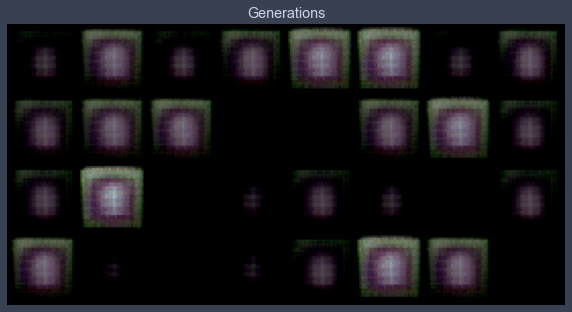

Epoch 1 loss 0.8930792103927979, test L1 = 0.7460443936288357
Epoch 2 loss 0.8794911577529514, test L1 = 0.7387845255434513
Epoch 3 loss 0.8646145585885981, test L1 = 0.702986728399992
Epoch 4 loss 0.8510585449815206, test L1 = 0.7032459191977978


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 0.8462475235109886, test L1 = 0.704878531396389
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


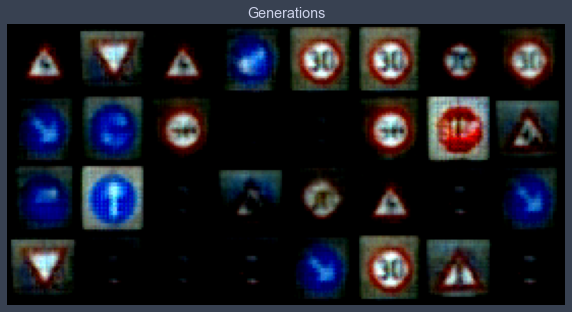

Epoch 6 loss 0.8415964034824437, test L1 = 0.699582576751709
Epoch 7 loss 0.8394703742155095, test L1 = 0.7077157720923424
Epoch 8 loss 0.8376594040402022, test L1 = 0.7050034888088703
Epoch 9 loss 0.8368041507157263, test L1 = 0.6922752410173416


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 0.8357934109943429, test L1 = 0.7098986990749836
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


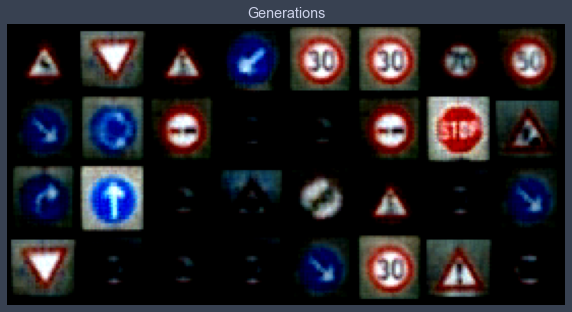

Epoch 11 loss 0.8354119252912777, test L1 = 0.7211169525980949
Epoch 12 loss 0.8345320626222801, test L1 = 0.6998873800039291
Epoch 13 loss 0.8338799853505138, test L1 = 0.7172760106623173
Epoch 14 loss 0.8334300020306381, test L1 = 0.7120568715035915


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 0.8337556811952099, test L1 = 0.6966259554028511
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


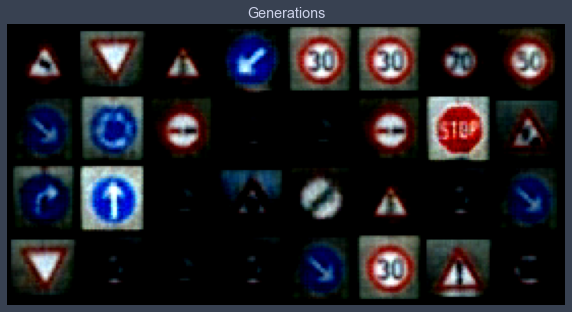

Epoch 16 loss 0.8338056507798814, test L1 = 0.708486519753933
Epoch 17 loss 0.8331020671067778, test L1 = 0.7079980298876762
Epoch 18 loss 0.8324872404848996, test L1 = 0.7081891857087612
Epoch 19 loss 0.8323680125560957, test L1 = 0.7028800398111343


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 0.8323918443774849, test L1 = 0.7072261944413185
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


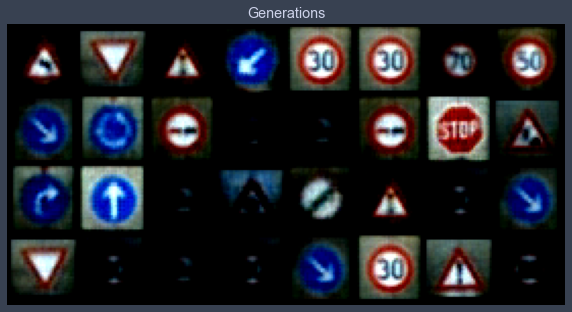

Epoch 21 loss 0.8319576902897498, test L1 = 0.699779212474823
Epoch 22 loss 0.8320297342805109, test L1 = 0.7018890827894211
Epoch 23 loss 0.8320911958864874, test L1 = 0.6992464438080788
Epoch 24 loss 0.8320192313685859, test L1 = 0.7088564001023769


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 0.8314019742700243, test L1 = 0.6963152997195721
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


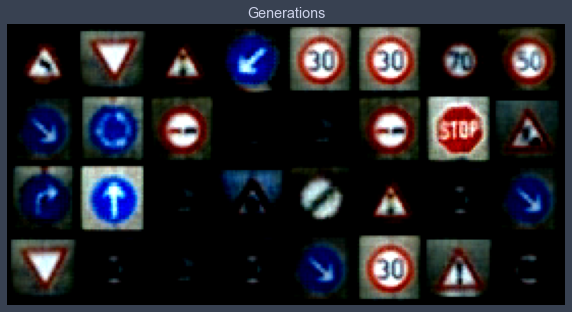

Epoch 26 loss 0.8317835765196285, test L1 = 0.7172394171357155
Epoch 27 loss 0.831333056143469, test L1 = 0.7040662169456482
Epoch 28 loss 0.8314912296652385, test L1 = 0.7105294391512871
Epoch 29 loss 0.8313116597146103, test L1 = 0.7067259103059769


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 0.8314588373059669, test L1 = 0.7059320099651814
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


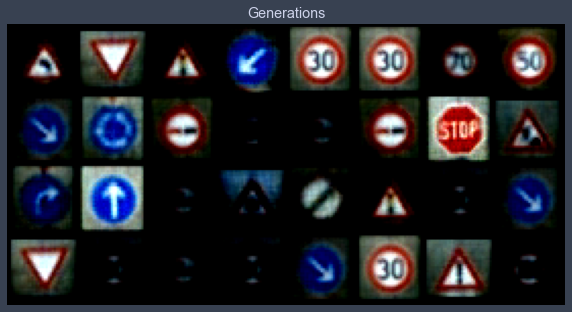

Epoch 31 loss 0.8310732714498985, test L1 = 0.7035444602370262
Epoch 32 loss 0.8309537123159035, test L1 = 0.7033980786800385
Epoch 33 loss 0.8309606076106173, test L1 = 0.7144652269780636
Epoch 34 loss 0.8307098592679525, test L1 = 0.7105848602950573


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 0.8306976640757007, test L1 = 0.7112329117953777
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


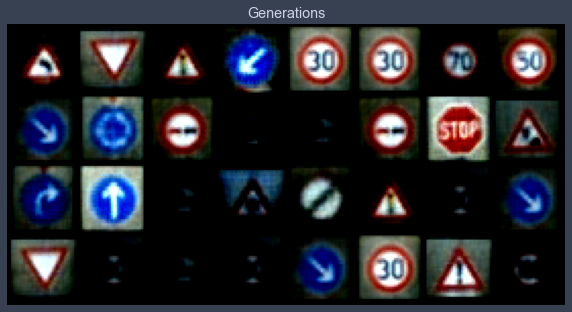

Epoch 36 loss 0.8303870528014665, test L1 = 0.7069655060768127
Epoch 37 loss 0.8305788656690276, test L1 = 0.704681821167469
Epoch 38 loss 0.830363890354576, test L1 = 0.7075643874704838
Epoch 39 loss 0.8304310027266696, test L1 = 0.7071234509348869


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 0.8306176789437782, test L1 = 0.7061144299805164
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


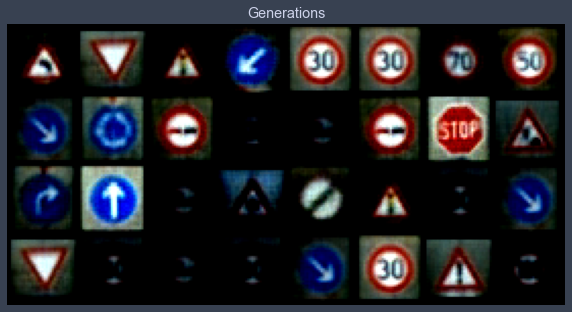

Epoch 41 loss 0.8302459751617458, test L1 = 0.710286121815443
Epoch 42 loss 0.8300625003899905, test L1 = 0.706674475222826
Epoch 43 loss 0.8302275718692242, test L1 = 0.6962321810424328
Epoch 44 loss 0.8300728654533727, test L1 = 0.7146974019706249


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 0.8300912933251292, test L1 = 0.7048131488263607
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


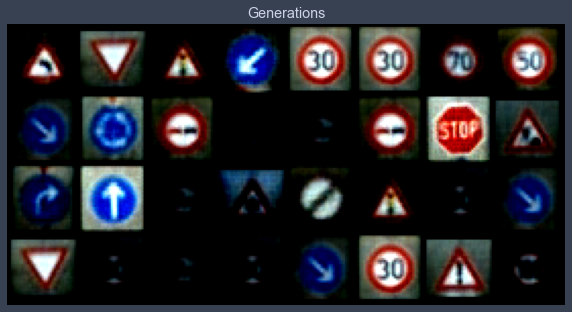







~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=16 | LR=0.01
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 34137.91103258985, test L1 = 0.7889219783246517
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


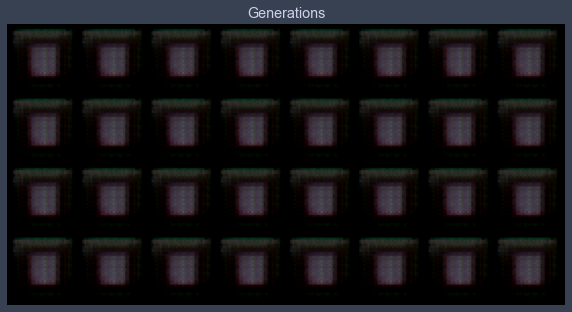

Epoch 1 loss 0.9770462553935362, test L1 = 0.7812387645244598
Epoch 2 loss 0.9744629536297723, test L1 = 0.7712516710162163
Epoch 3 loss 0.9705144572503788, test L1 = 0.7787737809121609
Epoch 4 loss 0.9941712005441541, test L1 = 0.8108176104724407


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 1.0276968051068152, test L1 = 0.8038036376237869
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


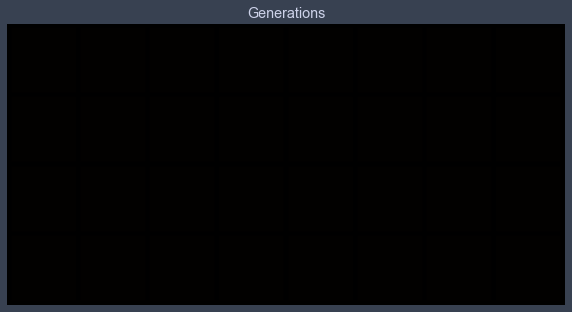

Epoch 6 loss 1.0123360552328968, test L1 = 0.806013360619545
Epoch 7 loss 1.0024035052745204, test L1 = 0.8134816475212574
Epoch 8 loss 1.0175627947263293, test L1 = 0.8033278062939644
Epoch 9 loss 1.0033144961108047, test L1 = 0.8023477345705032


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 1.014248783850588, test L1 = 0.8064964674413204
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


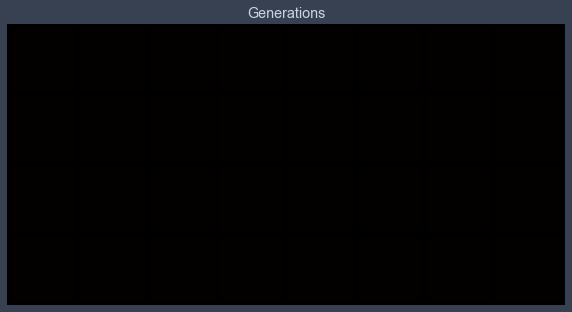

Epoch 11 loss 1.0156190655485462, test L1 = 0.8015218339860439
Epoch 12 loss 1.0133821235079945, test L1 = 0.810333851724863
Epoch 13 loss 1.004328405939017, test L1 = 0.8020305447280407
Epoch 14 loss 1.0098588075424797, test L1 = 0.8011179342865944


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 1.0084527384784214, test L1 = 0.8050377294421196
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


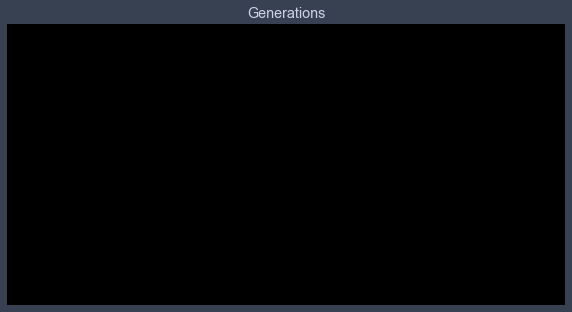

Epoch 16 loss 1.010189818762422, test L1 = 0.8022320680320263
Epoch 17 loss 1.0114613824693608, test L1 = 0.7986093387007713
Epoch 18 loss 1.0048260901801775, test L1 = 0.8049955517053604
Epoch 19 loss 4786372.731814915, test L1 = 0.8056980110704899


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 99.30465729703609, test L1 = 0.8004078678786755
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


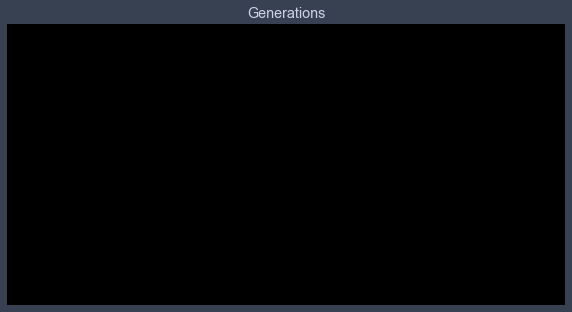

Epoch 21 loss 75.6941949641172, test L1 = 0.8125749118626118
Epoch 22 loss 66.13023558678906, test L1 = 0.8005442172288895
Epoch 23 loss 49.15959138640833, test L1 = 0.8005727715790272
Epoch 24 loss 48.66017352756356, test L1 = 0.8001025132834911
Epoch 25 loss 25.88808030852747, test L1 = 0.8097458109259605
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


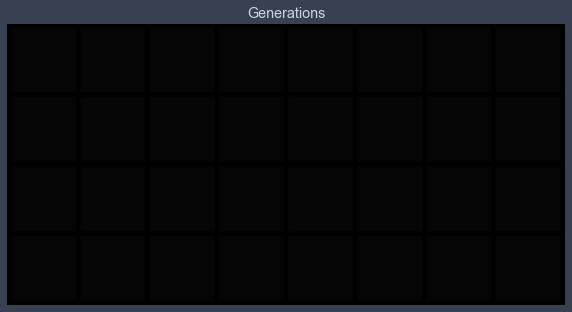

Epoch 26 loss 24.678063035420944, test L1 = 0.8052290417253971
Epoch 27 loss 24.59930715528141, test L1 = 0.8040713146328926
Epoch 28 loss 24.564147510069752, test L1 = 0.8070978596806526
Epoch 29 loss 24.550468090883236, test L1 = 0.7983204238116741


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 24.545653425131466, test L1 = 0.8005901426076889
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


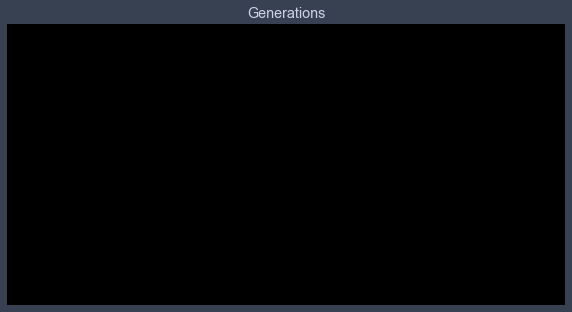

Epoch 31 loss 24.54500921976935, test L1 = 0.8100067377090454
Epoch 32 loss 24.544492393834485, test L1 = 0.7978934459388256
Epoch 33 loss 24.545204359231537, test L1 = 0.8210497610270977
Epoch 34 loss 24.547074603051254, test L1 = 0.800322387367487


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 24.55072818507034, test L1 = 0.7996008917689323
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


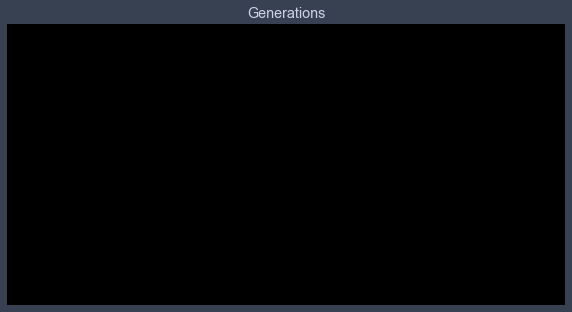

Epoch 36 loss 25.096383701075393, test L1 = 0.800438467413187
Epoch 37 loss 42.45446908433003, test L1 = 0.8082662336528301
Epoch 38 loss 52.664722966983966, test L1 = 0.8117563277482986
Epoch 39 loss 45.49886335785856, test L1 = 0.8034975752234459
Epoch 40 loss 63.31559626261393, test L1 = 0.8036052361130714
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


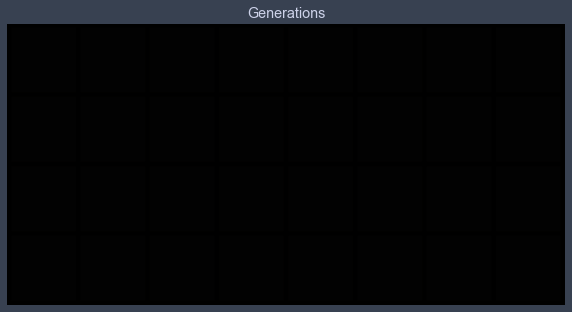

Epoch 41 loss 42.5689443476831, test L1 = 0.8019274435937405
Epoch 42 loss 37.30676044713181, test L1 = 0.8012659288942814
Epoch 43 loss 49.1644457525404, test L1 = 0.7961362637579441
Epoch 44 loss 41.949278775769, test L1 = 0.8109451420605183
Epoch 45 loss 35.160994447793335, test L1 = 0.8081630654633045
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


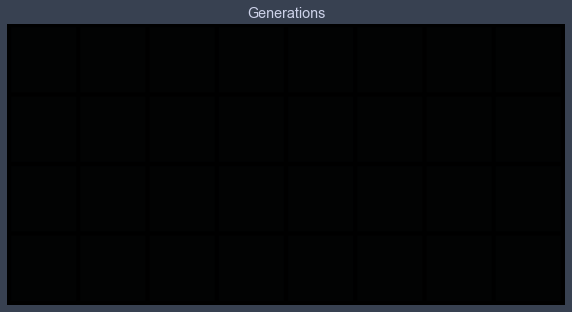







~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=16 | LR=0.0001
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 0.9906980491585747, test L1 = 0.7835102267563343
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


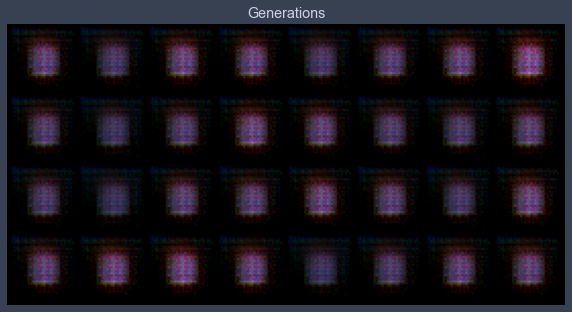

Epoch 1 loss 0.9462619806892684, test L1 = 0.7527295015752316
Epoch 2 loss 0.908584436190497, test L1 = 0.7363331168889999
Epoch 3 loss 0.8959402640660604, test L1 = 0.7312474884092808
Epoch 4 loss 0.8908196155148274, test L1 = 0.708883710205555


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 0.8866842452603108, test L1 = 0.7230269946157932
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


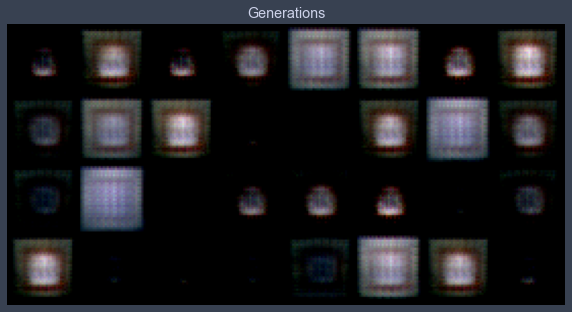

Epoch 6 loss 0.8827657603316291, test L1 = 0.7392375208437443
Epoch 7 loss 0.8803938285182022, test L1 = 0.7337317802011967
Epoch 8 loss 0.8771633948247457, test L1 = 0.7328644506633282
Epoch 9 loss 0.8750555883977831, test L1 = 0.7274130061268806


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 0.8729585603750039, test L1 = 0.7444209232926369
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


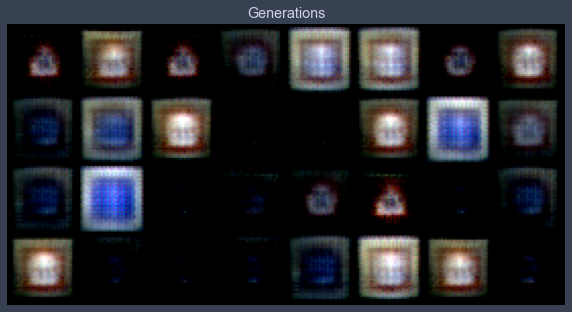

Epoch 11 loss 0.8707574747272373, test L1 = 0.7242056056857109
Epoch 12 loss 0.8689169781314549, test L1 = 0.7114777751266956
Epoch 13 loss 0.8673673956254914, test L1 = 0.7201191857457161
Epoch 14 loss 0.8661210239957698, test L1 = 0.7213261500000954


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 0.8645602939874446, test L1 = 0.7470901012420654
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


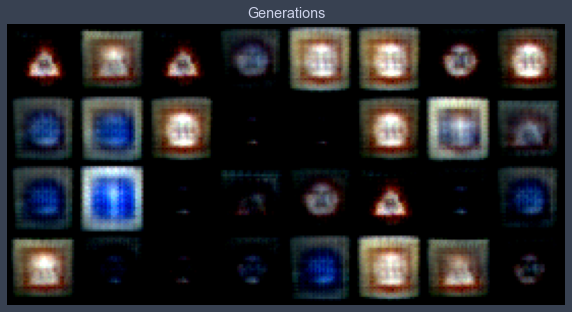

Epoch 16 loss 0.861764234980357, test L1 = 0.7047715298831463
Epoch 17 loss 0.8607459043719105, test L1 = 0.7238009013235569
Epoch 18 loss 0.859451203411797, test L1 = 0.7242659106850624
Epoch 19 loss 0.857499736486022, test L1 = 0.7233042307198048


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 0.8569639493100012, test L1 = 0.7335486188530922
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


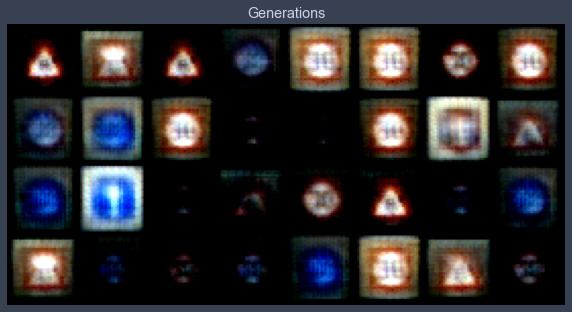

Epoch 21 loss 0.8556940901730069, test L1 = 0.7169203571975231
Epoch 22 loss 0.8553367763040811, test L1 = 0.7045051641762257
Epoch 23 loss 0.8541604216975445, test L1 = 0.7205648571252823
Epoch 24 loss 0.8532536128132614, test L1 = 0.7226568423211575


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 0.8521439709614232, test L1 = 0.734065119177103
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


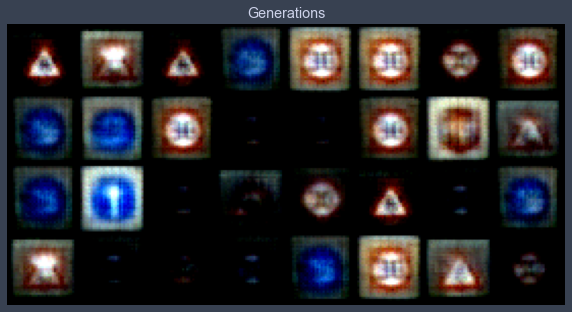

Epoch 26 loss 0.8512276236953604, test L1 = 0.7048636302351952
Epoch 27 loss 0.8510297280816278, test L1 = 0.7065846659243107
Epoch 28 loss 0.850091761330149, test L1 = 0.7292305715382099
Epoch 29 loss 0.8495305745872026, test L1 = 0.7259216494858265


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 0.8489283825114011, test L1 = 0.7211825549602509
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


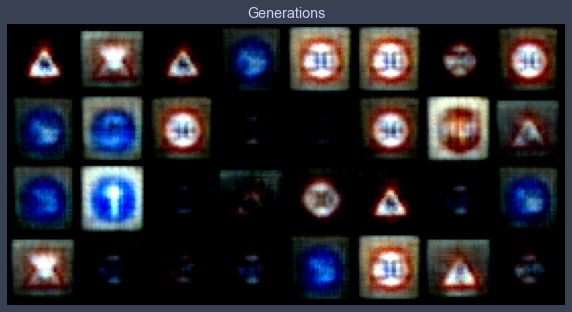

Epoch 31 loss 0.8480047440201146, test L1 = 0.7162386998534203
Epoch 32 loss 0.8476703826504475, test L1 = 0.7074329294264317
Epoch 33 loss 0.847020982876676, test L1 = 0.7341603226959705
Epoch 34 loss 0.846567676239407, test L1 = 0.7164975702762604


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 0.8463591785775018, test L1 = 0.7143488526344299
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


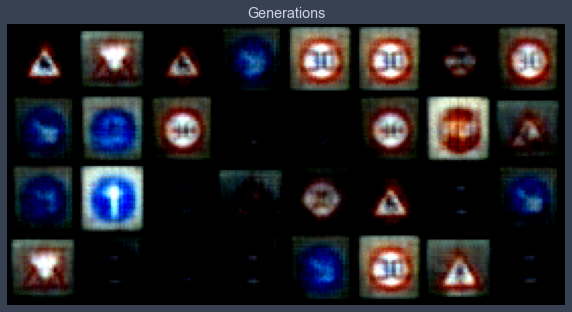

Epoch 36 loss 0.845562219414924, test L1 = 0.7063238881528378
Epoch 37 loss 0.8448804510418082, test L1 = 0.7290573269128799
Epoch 38 loss 0.8447516064873266, test L1 = 0.709286991506815
Epoch 39 loss 0.8440891930327792, test L1 = 0.7161659263074398


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 0.8439574677919605, test L1 = 0.7186364009976387
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


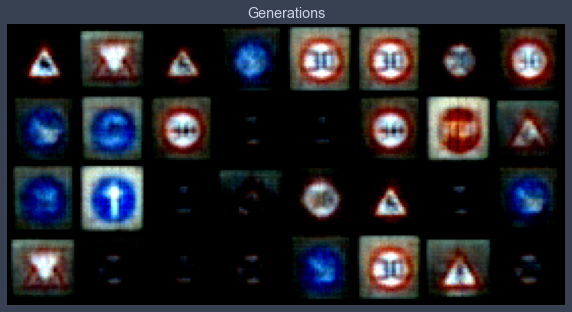

Epoch 41 loss 0.8437684897294978, test L1 = 0.7092682644724846
Epoch 42 loss 0.8434395816727602, test L1 = 0.7160454802215099
Epoch 43 loss 0.8427888181611025, test L1 = 0.7125598751008511
Epoch 44 loss 0.8421089870413554, test L1 = 0.71480792760849


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 0.842076287031993, test L1 = 0.7184537686407566
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


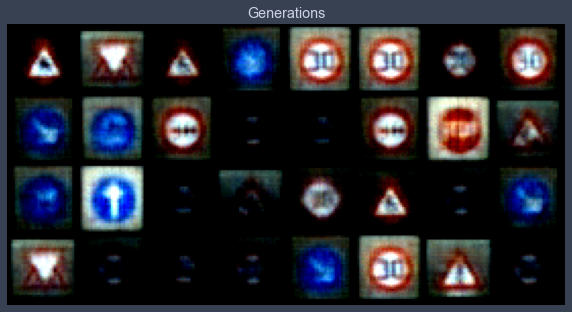







~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=32 | LR=0.001
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 1.0572075008117046, test L1 = 0.7405299656093121
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


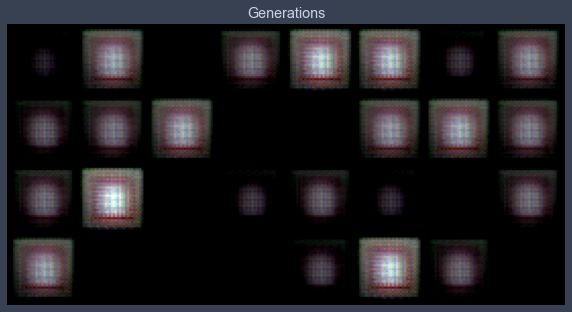

Epoch 1 loss 0.8973895944270891, test L1 = 0.7229116223752499
Epoch 2 loss 0.8879949575437304, test L1 = 0.7252819575369358
Epoch 3 loss 0.8752367508780096, test L1 = 0.7215475104749203
Epoch 4 loss 0.8614862350254124, test L1 = 0.7109524719417095


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 0.8519882760506725, test L1 = 0.7131233625113964
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


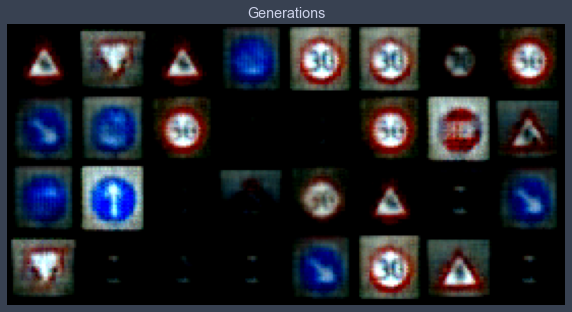

Epoch 6 loss 0.845482729759413, test L1 = 0.7169193960726261
Epoch 7 loss 0.8430732064640399, test L1 = 0.703321386128664
Epoch 8 loss 0.8398070996979258, test L1 = 0.7136757373809814
Epoch 9 loss 0.8387750292971372, test L1 = 0.704633355140686


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 0.8376031540513448, test L1 = 0.7097936421632767
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


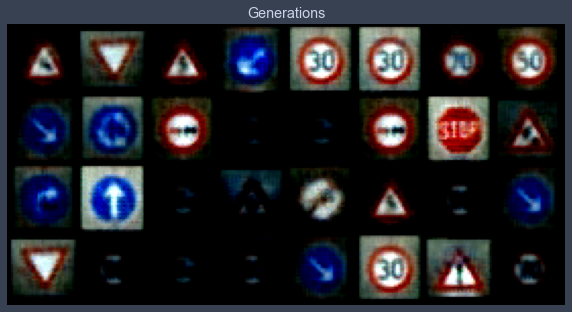

Epoch 11 loss 0.8368421047413882, test L1 = 0.7046720832586288
Epoch 12 loss 0.8358639648689847, test L1 = 0.7149466685950756
Epoch 13 loss 0.8353378428626306, test L1 = 0.7168814428150654
Epoch 14 loss 0.8349725059217604, test L1 = 0.708769965916872


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 0.8338705321767486, test L1 = 0.7059927992522717
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


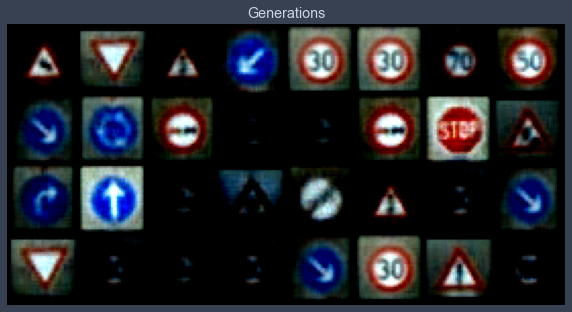

Epoch 16 loss 0.8340934701391921, test L1 = 0.7008299976587296
Epoch 17 loss 0.8338629515310333, test L1 = 0.707251712679863
Epoch 18 loss 0.8338886470729133, test L1 = 0.7016757428646088
Epoch 19 loss 0.8330677469161778, test L1 = 0.7030159309506416


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 0.8329782653920019, test L1 = 0.7103074267506599
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


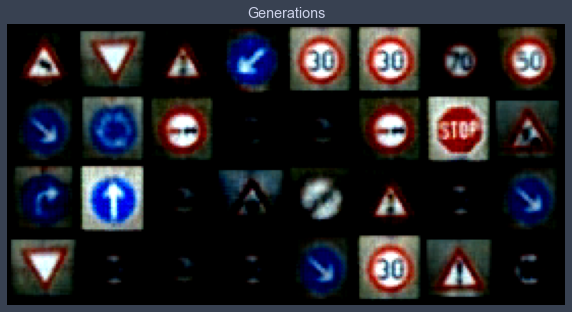

Epoch 21 loss 0.8326124712773615, test L1 = 0.7089364267885685
Epoch 22 loss 0.8324417783222657, test L1 = 0.7102921605110168
Epoch 23 loss 0.8323444425035588, test L1 = 0.7051982991397381
Epoch 24 loss 0.8320267188180354, test L1 = 0.6985986642539501


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 0.8319434695637103, test L1 = 0.7050901912152767
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


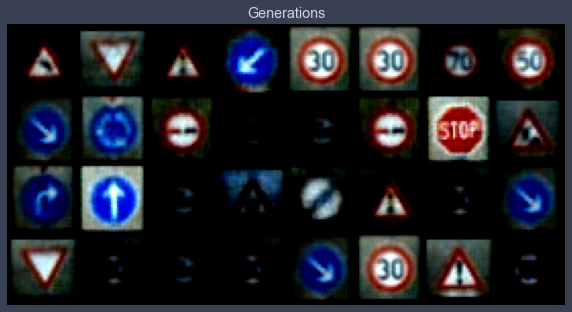

Epoch 26 loss 0.8320477236177504, test L1 = 0.7141957245767117
Epoch 27 loss 0.8316373956162495, test L1 = 0.7030180431902409
Epoch 28 loss 0.8315689993887833, test L1 = 0.7071270011365414
Epoch 29 loss 0.831454814299685, test L1 = 0.701701745390892


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 0.8315925811164567, test L1 = 0.7027428224682808
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


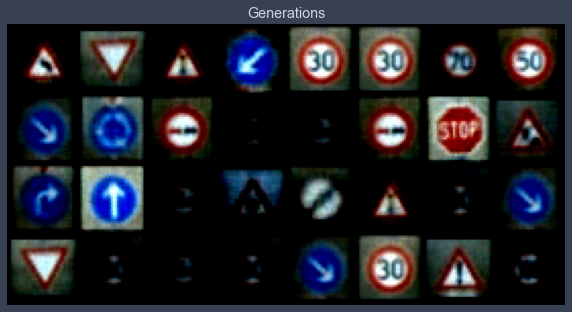

Epoch 31 loss 0.8312831236324769, test L1 = 0.7133789584040642
Epoch 32 loss 0.8309407047799363, test L1 = 0.7033163495361805
Epoch 33 loss 0.8308801718593872, test L1 = 0.7138323821127415
Epoch 34 loss 0.8308988973447138, test L1 = 0.7085149437189102


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 0.8309265815515289, test L1 = 0.7039556950330734
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


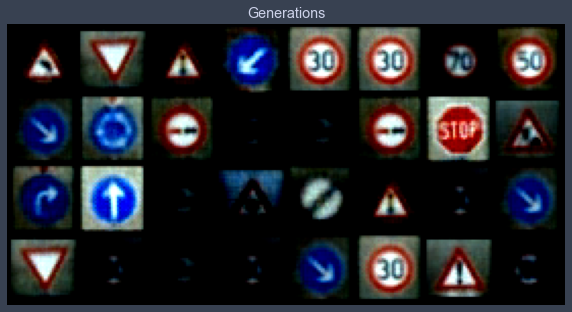

Epoch 36 loss 0.830709886305111, test L1 = 0.702727198600769
Epoch 37 loss 0.8306003012198353, test L1 = 0.7037875354290009
Epoch 38 loss 0.8307413147487182, test L1 = 0.7001807279884815
Epoch 39 loss 0.8309223678513491, test L1 = 0.7013092748820782


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 0.8305040171875577, test L1 = 0.7092041708528996
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


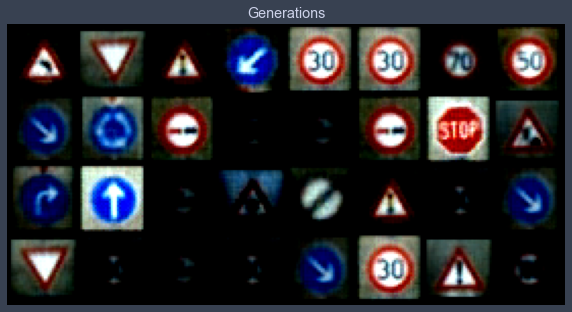

Epoch 41 loss 0.8303296654085114, test L1 = 0.7054928988218307
Epoch 42 loss 0.8302925651016104, test L1 = 0.7018084786832333
Epoch 43 loss 0.8301284057168207, test L1 = 0.7111885212361813
Epoch 44 loss 0.8304490684643644, test L1 = 0.7073323242366314


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 0.8299517946964277, test L1 = 0.7090250514447689
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


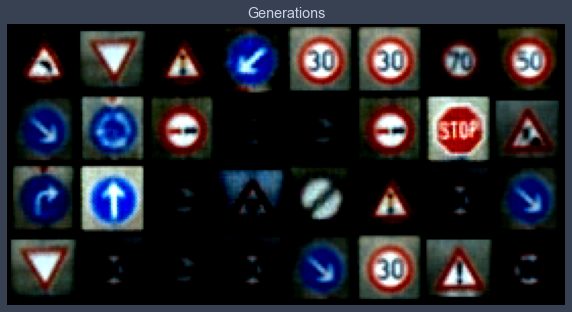







~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=32 | LR=0.01
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 89053.99457646481, test L1 = 0.7804356925189495
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


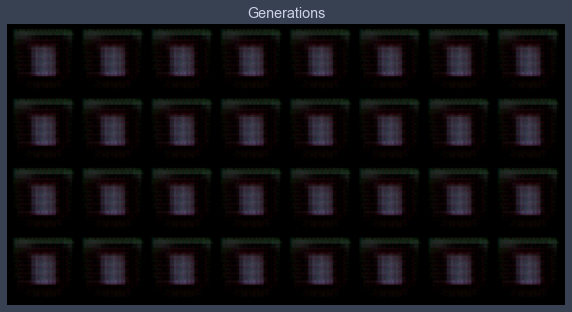

Epoch 1 loss 1.0092496089509262, test L1 = 0.7788528837263584
Epoch 2 loss 0.9938192742387044, test L1 = 0.7948642261326313
Epoch 3 loss 0.9643927958003434, test L1 = 0.7877641879022121
Epoch 4 loss 0.9730282667576242, test L1 = 0.7788542844355106


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 0.9788307074419001, test L1 = 0.7833160646259785
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


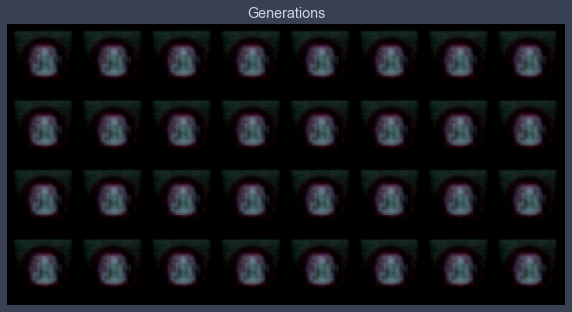

Epoch 6 loss 2.6185482969808414, test L1 = 0.779166042804718
Epoch 7 loss 1.2650141718051688, test L1 = 0.7731349840760231
Epoch 8 loss 0.9644753263168728, test L1 = 0.7774425558745861
Epoch 9 loss 0.9599308797583956, test L1 = 0.7663304209709167


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 0.9564166316871381, test L1 = 0.7920489870011806
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


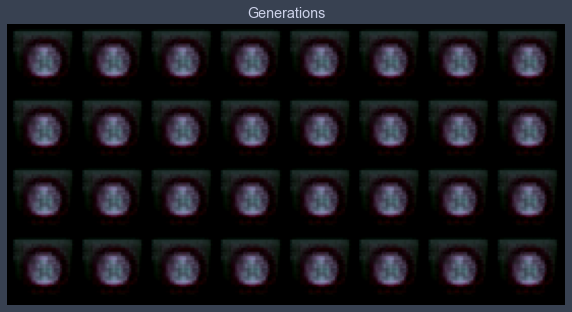

Epoch 11 loss 0.9884805585100889, test L1 = 0.8013225719332695
Epoch 12 loss 0.9990042493105754, test L1 = 0.8028903007507324
Epoch 13 loss 1.0004498141328084, test L1 = 0.814987525343895
Epoch 14 loss 1.0096689780143528, test L1 = 0.8035936914384365
Epoch 15 loss 1.0147466391222584, test L1 = 0.8115849159657955
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


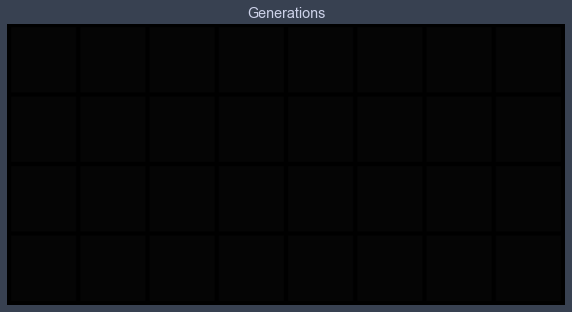

Epoch 16 loss 1.0149488086552965, test L1 = 0.8107311837375164
Epoch 17 loss 1.0118387656932843, test L1 = 0.8127036653459072
Epoch 18 loss 1.011192594197198, test L1 = 0.801165483891964
Epoch 19 loss 1.0110260645548503, test L1 = 0.8023637197911739
Epoch 20 loss 1.0183273062263567, test L1 = 0.8084029518067837
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


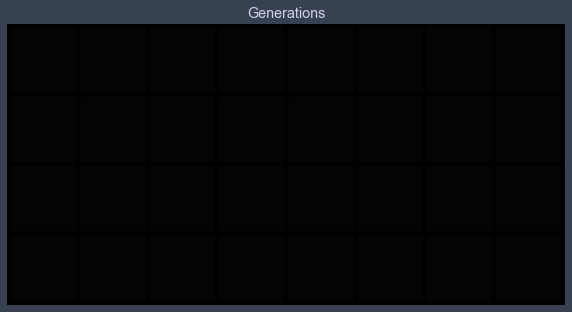

Epoch 21 loss 1.0082752598110343, test L1 = 0.8027507364749908
Epoch 22 loss 1.0077645063809924, test L1 = 0.802127443253994
Epoch 23 loss 1.0088653056482269, test L1 = 0.8027942180633545
Epoch 24 loss 1.0104784838522423, test L1 = 0.8074498809874058
Epoch 25 loss 1.0093505603750956, test L1 = 0.8094193935394287
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


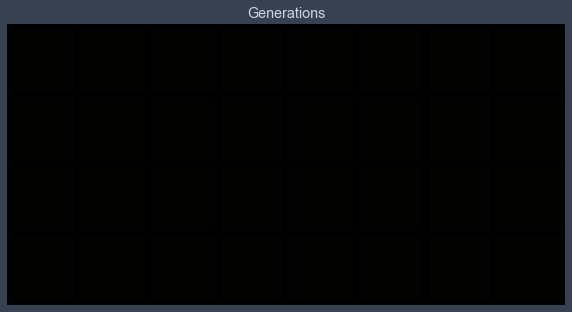

Epoch 26 loss 1.0364079604443817, test L1 = 0.8010835349559784
Epoch 27 loss 1.0170339007967526, test L1 = 0.8034359999001026
Epoch 28 loss 1.0340885253706338, test L1 = 0.8092058338224888
Epoch 29 loss 1.0255973699576257, test L1 = 0.801076851785183


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 1.0426664200845044, test L1 = 0.8056630678474903
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


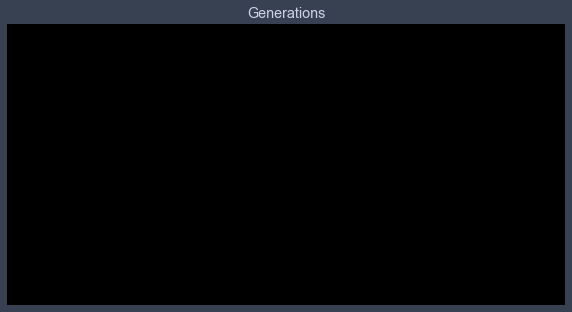

Epoch 31 loss 1.0524812889672637, test L1 = 0.8013366721570492
Epoch 32 loss 1.0342082862591826, test L1 = 0.804016474634409
Epoch 33 loss 1.0490817857771804, test L1 = 0.8006541542708874
Epoch 34 loss 1.0705536120535992, test L1 = 0.8039468489587307
Epoch 35 loss 1.0275304864362342, test L1 = 0.8030754029750824
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


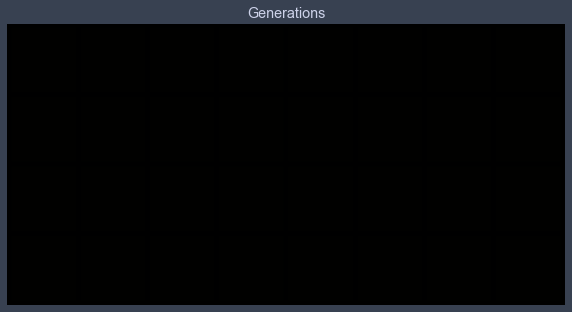

Epoch 36 loss 1.0745826904306706, test L1 = 0.7964985743165016
Epoch 37 loss 1.0587411123452728, test L1 = 0.8136902786791325
Epoch 38 loss 1.0385211230962956, test L1 = 0.8052726313471794
Epoch 39 loss 1.0570756938449295, test L1 = 0.8087624348700047


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 1.0513287803151763, test L1 = 0.8008721806108952
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


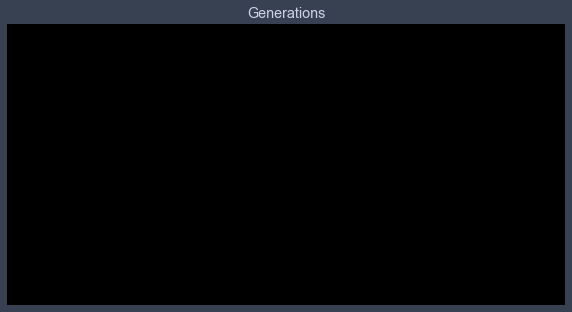

Epoch 41 loss 1.0050892833991558, test L1 = 0.8057797290384769
Epoch 42 loss 1.0441714523174508, test L1 = 0.8082018159329891
Epoch 43 loss 1.0764902277091115, test L1 = 0.8047793619334698
Epoch 44 loss 1.0488035398250593, test L1 = 0.806040558964014


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 1.000684614034043, test L1 = 0.7994024008512497
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


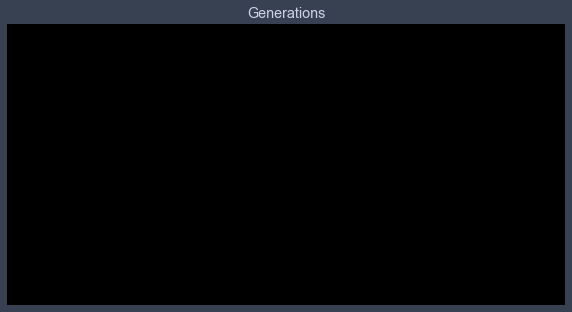







~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=32 | LR=0.0001
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 1.0097026454214377, test L1 = 0.7903907597064972
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


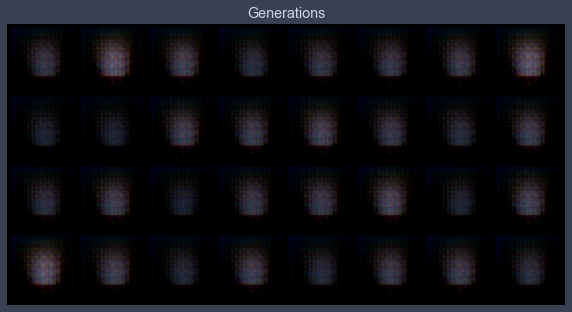

Epoch 1 loss 0.942361218003473, test L1 = 0.7543554976582527
Epoch 2 loss 0.9129002762004682, test L1 = 0.7595169208943844
Epoch 3 loss 0.9041132685245108, test L1 = 0.7518108673393726
Epoch 4 loss 0.8989162553626647, test L1 = 0.7520218044519424


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 0.8962029388680082, test L1 = 0.7333741448819637
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


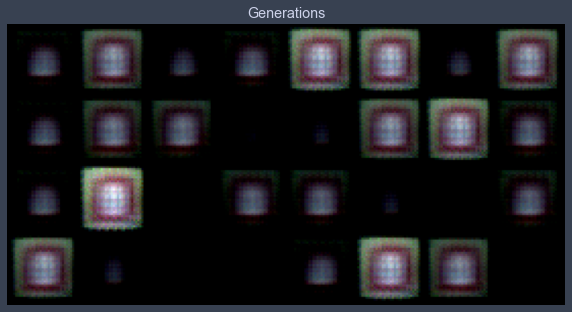

Epoch 6 loss 0.8943823113064586, test L1 = 0.7382769398391247
Epoch 7 loss 0.8915804038752395, test L1 = 0.7379335425794125
Epoch 8 loss 0.8904120602558568, test L1 = 0.7260699011385441
Epoch 9 loss 0.8890371056356791, test L1 = 0.7411960437893867


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 0.886205397315861, test L1 = 0.750236053019762
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


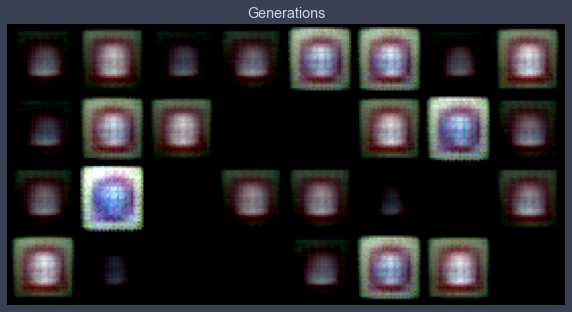

Epoch 11 loss 0.8853291307937649, test L1 = 0.7288891263306141
Epoch 12 loss 0.8844544000641996, test L1 = 0.729565616697073
Epoch 13 loss 0.8828639037830314, test L1 = 0.7360123880207539
Epoch 14 loss 0.8812451555147204, test L1 = 0.732701450586319


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 0.8786588874469508, test L1 = 0.7354803048074245
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


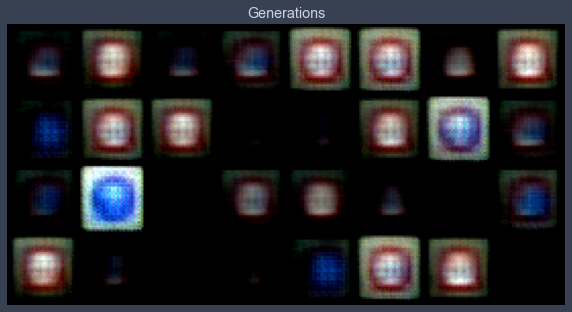

Epoch 16 loss 0.8769612664619262, test L1 = 0.721300981938839
Epoch 17 loss 0.8759070407483995, test L1 = 0.7299340292811394
Epoch 18 loss 0.8740989596573348, test L1 = 0.7408098541200161
Epoch 19 loss 0.8734947031306237, test L1 = 0.7295454479753971


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 0.8714020211262392, test L1 = 0.7109659239649773
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


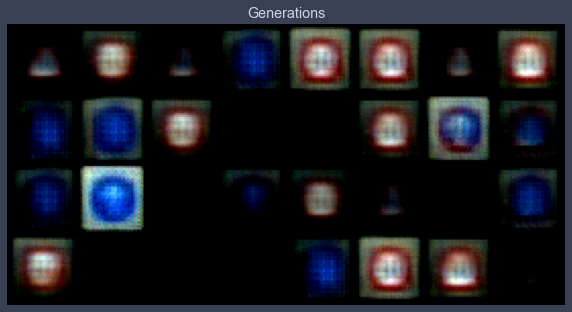

Epoch 21 loss 0.8703317617632679, test L1 = 0.7163867317140102
Epoch 22 loss 0.8707360934555736, test L1 = 0.7413926646113396
Epoch 23 loss 0.8693695008959558, test L1 = 0.737961046397686
Epoch 24 loss 0.8686440048348862, test L1 = 0.7321755811572075


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 0.8680186072985331, test L1 = 0.7281390205025673
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


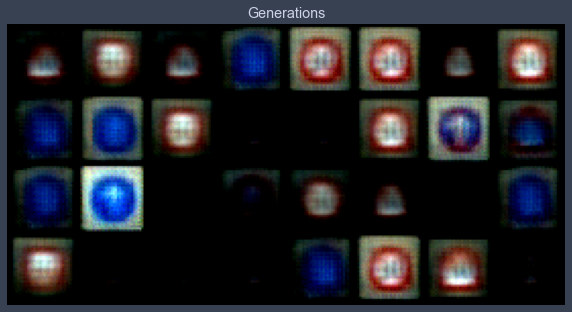

Epoch 26 loss 0.8669179141316626, test L1 = 0.7250337637960911
Epoch 27 loss 0.8663514746013785, test L1 = 0.7204281352460384
Epoch 28 loss 0.8661833579597604, test L1 = 0.7325750142335892
Epoch 29 loss 0.8651503099199013, test L1 = 0.7286500334739685


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 0.8640330859885592, test L1 = 0.7209259010851383
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


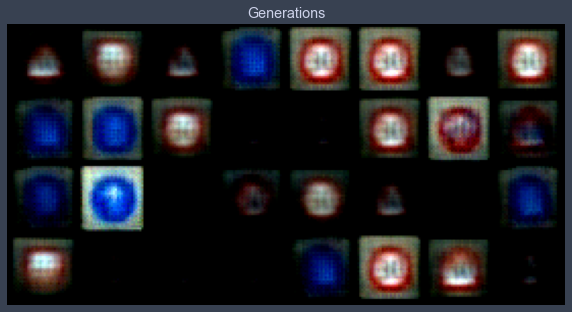

Epoch 31 loss 0.8638595397939387, test L1 = 0.7216099537909031
Epoch 32 loss 0.8631520990243892, test L1 = 0.7238213047385216
Epoch 33 loss 0.8621100623583057, test L1 = 0.7163429819047451
Epoch 34 loss 0.8617203544914928, test L1 = 0.7283625826239586


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 0.8611890038673821, test L1 = 0.7322897426784039
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


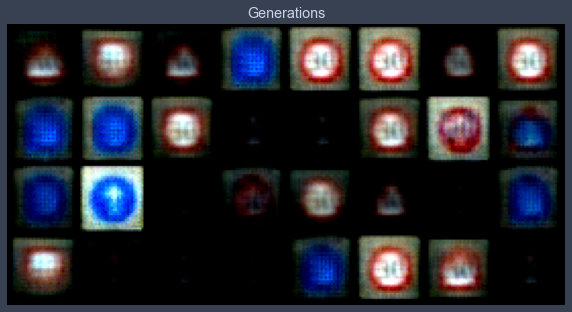

Epoch 36 loss 0.8603508552325141, test L1 = 0.7262379415333271
Epoch 37 loss 0.8592132479464475, test L1 = 0.7184712141752243
Epoch 38 loss 0.858819593678635, test L1 = 0.7228851355612278
Epoch 39 loss 0.858111648420288, test L1 = 0.7133490033447742


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 0.857250442209932, test L1 = 0.7167458981275558
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


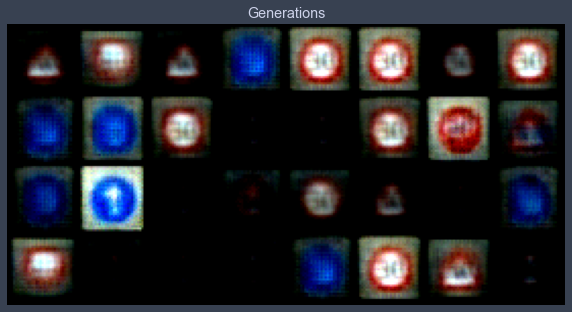

Epoch 41 loss 0.8565022875762887, test L1 = 0.7264575883746147
Epoch 42 loss 0.8557071399033275, test L1 = 0.7167583703994751
Epoch 43 loss 0.8549482482405463, test L1 = 0.7145701460540295
Epoch 44 loss 0.8546687579646552, test L1 = 0.7168671824038029


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 0.8536121505232611, test L1 = 0.7130814306437969
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


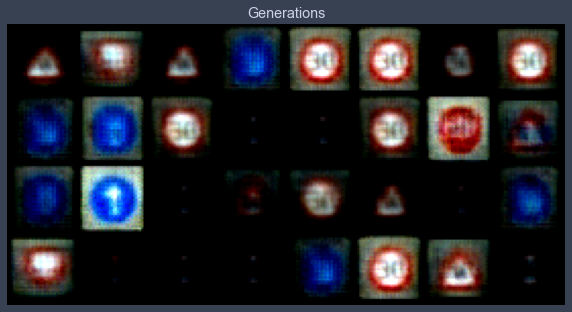







~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=64 | LR=0.001
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 1.180162187499279, test L1 = 0.7607415169477463
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


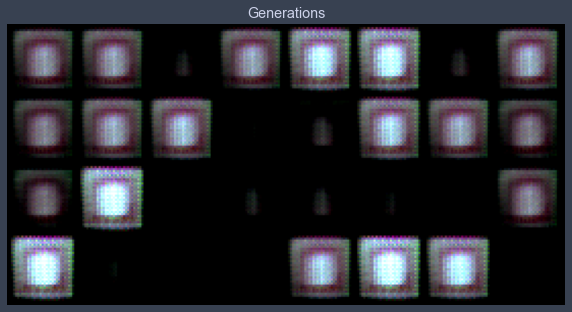

Epoch 1 loss 0.8973285035579065, test L1 = 0.7371051087975502
Epoch 2 loss 0.8906772173557085, test L1 = 0.7317896597087383
Epoch 3 loss 0.8820808011641617, test L1 = 0.7204415462911129
Epoch 4 loss 0.8725806999042681, test L1 = 0.7195972874760628


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 0.8636173358078265, test L1 = 0.7247591651976109
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


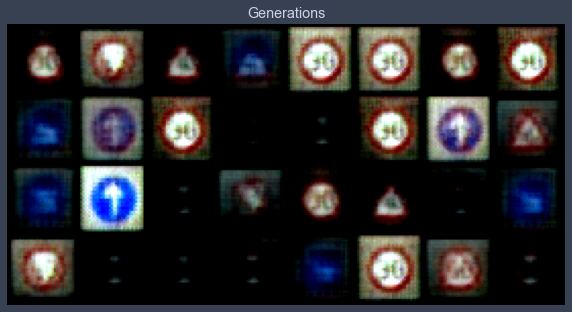

Epoch 6 loss 0.8545124323917008, test L1 = 0.7265900894999504
Epoch 7 loss 0.8480939967525783, test L1 = 0.7153715826570988
Epoch 8 loss 0.8442905866813004, test L1 = 0.7215232886373997
Epoch 9 loss 0.8417502752284414, test L1 = 0.7033367939293385


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 0.8400473692982467, test L1 = 0.713004007935524
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


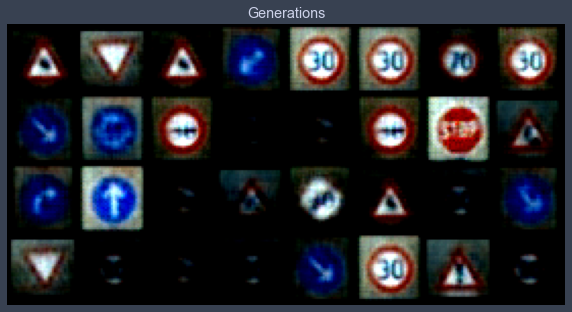

Epoch 11 loss 0.8382985935997718, test L1 = 0.7082128673791885
Epoch 12 loss 0.8368774486571243, test L1 = 0.7148824073374271
Epoch 13 loss 0.8366156263449758, test L1 = 0.710855595767498
Epoch 14 loss 0.8357669026990936, test L1 = 0.7113298326730728


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 0.8351253469785055, test L1 = 0.7090827599167824
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


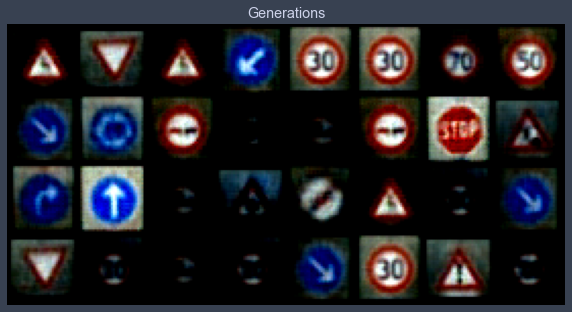

Epoch 16 loss 0.8347638761464673, test L1 = 0.7134911268949509
Epoch 17 loss 0.8344935991919737, test L1 = 0.7070774510502815
Epoch 18 loss 0.8336697583346023, test L1 = 0.708502471446991
Epoch 19 loss 0.8339770817265069, test L1 = 0.6985266171395779


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 0.8334013035207269, test L1 = 0.7010449841618538
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


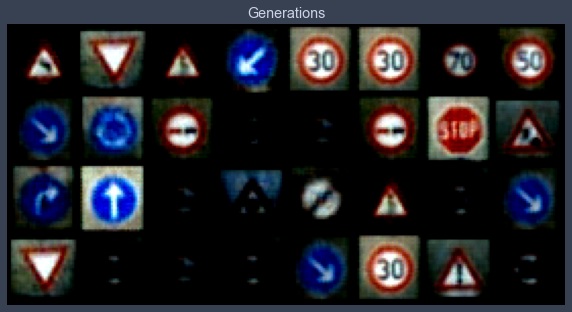

Epoch 21 loss 0.8333297972007305, test L1 = 0.7092818282544613
Epoch 22 loss 0.8327727012617891, test L1 = 0.7077072076499462
Epoch 23 loss 0.833066395467909, test L1 = 0.7169289775192738
Epoch 24 loss 0.8324470757618803, test L1 = 0.7036103196442127


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 0.8322404057709212, test L1 = 0.7065117955207825
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


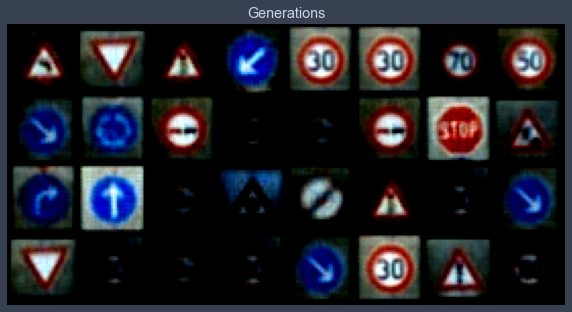

Epoch 26 loss 0.8321787200842526, test L1 = 0.7146151922643185
Epoch 27 loss 0.831751691926386, test L1 = 0.710950393229723
Epoch 28 loss 0.8318860901590065, test L1 = 0.6998983137309551
Epoch 29 loss 0.8316351986422981, test L1 = 0.7022219523787498


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 0.8319082069642765, test L1 = 0.7128092758357525
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


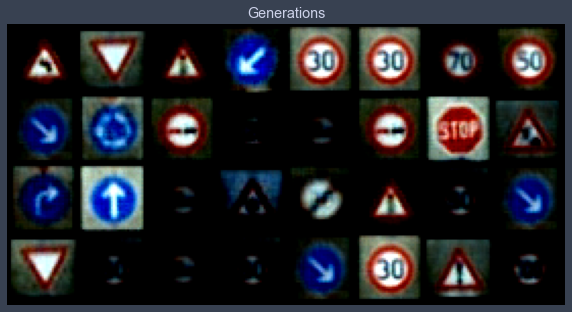

Epoch 31 loss 0.8316411877825498, test L1 = 0.7098917961120605
Epoch 32 loss 0.8319476361536898, test L1 = 0.7118335105478764
Epoch 33 loss 0.8314499787448608, test L1 = 0.7045094966888428
Epoch 34 loss 0.8316414851912928, test L1 = 0.705050602555275


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 0.8312456622156491, test L1 = 0.711502443999052
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


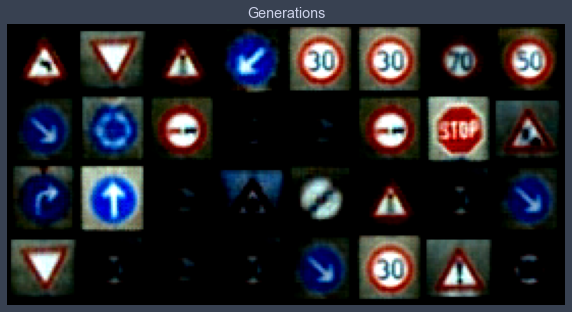

Epoch 36 loss 0.8309318331099048, test L1 = 0.7003068216145039
Epoch 37 loss 0.8308097933166215, test L1 = 0.7091190963983536
Epoch 38 loss 0.8307039532874458, test L1 = 0.7139220684766769
Epoch 39 loss 0.8309229837660118, test L1 = 0.6977366954088211


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 0.8307203490709522, test L1 = 0.7128867618739605
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


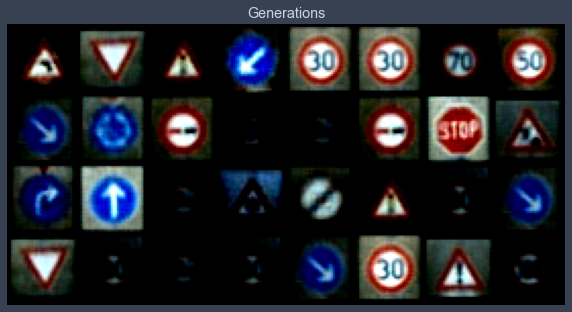

Epoch 41 loss 0.8307055087433648, test L1 = 0.702198214828968
Epoch 42 loss 0.8308196000217163, test L1 = 0.69657202064991
Epoch 43 loss 0.8304837231373868, test L1 = 0.7137562073767185
Epoch 44 loss 0.8302079443259747, test L1 = 0.7112963609397411


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 0.830500524683097, test L1 = 0.6938199512660503
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


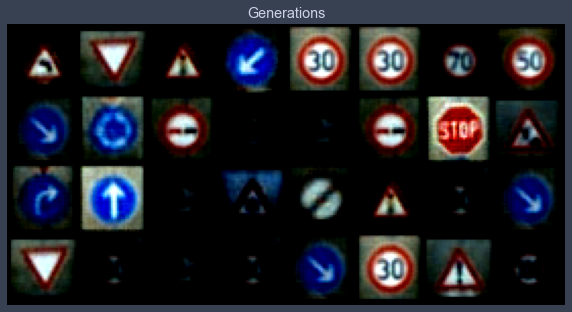







~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=64 | LR=0.01
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 34702.82127026246, test L1 = 0.7793656028807163
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


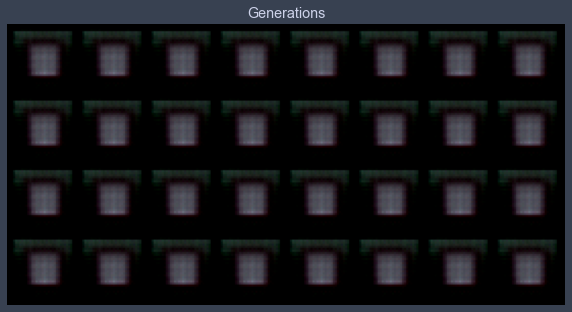

Epoch 1 loss 1.0040331779886358, test L1 = 0.7826242074370384
Epoch 2 loss 1.0051935255732323, test L1 = 0.7824653834104538
Epoch 3 loss 0.99463527391047, test L1 = 0.7853322140872478
Epoch 4 loss 1.0639583124327905, test L1 = 0.8010674528777599
Epoch 5 loss 1.0401819712927252, test L1 = 0.8064153455197811
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


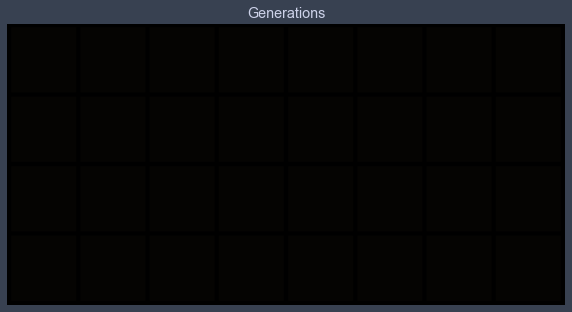

Epoch 6 loss 1.0321839208045775, test L1 = 0.8028683215379715
Epoch 7 loss 759.7083005305009, test L1 = 0.8047925420105457
Epoch 8 loss 1.2457590881491853, test L1 = 0.7968689203262329
Epoch 9 loss 1.0815394877158488, test L1 = 0.7987742274999619
Epoch 10 loss 1.0438377252968727, test L1 = 0.8121590055525303
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


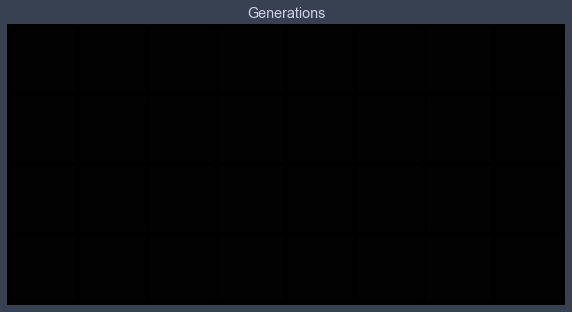

Epoch 11 loss 1.026271880901966, test L1 = 0.807730246335268
Epoch 12 loss 1.0162444893027498, test L1 = 0.8119397684931755
Epoch 13 loss 1.6197707315081173, test L1 = 0.8005584888160229
Epoch 14 loss 1.761737638322758, test L1 = 0.800544548779726
Epoch 15 loss 2.0189508394277382, test L1 = 0.8052344135940075
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


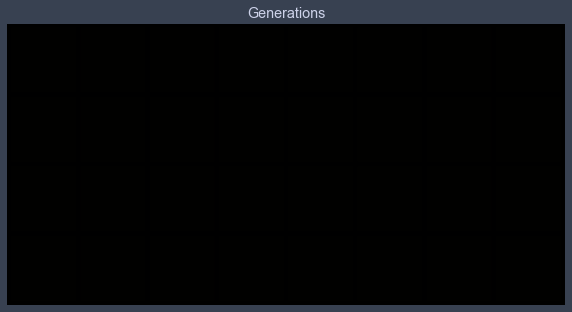

Epoch 16 loss 1.006546841659087, test L1 = 0.7990425676107407
Epoch 17 loss 2.5760635076109897, test L1 = 0.8039538003504276
Epoch 18 loss 1.000265979275261, test L1 = 0.8053320087492466
Epoch 19 loss 2.9984075244759367, test L1 = 0.8067604266107082


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 1.000874677679383, test L1 = 0.8091195560991764
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


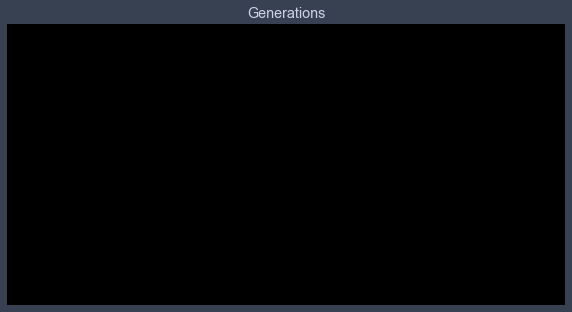

Epoch 21 loss 0.9992997406684246, test L1 = 0.8033899553120136
Epoch 22 loss 2.0742301942966237, test L1 = 0.8092304803431034
Epoch 23 loss 0.9996623702065641, test L1 = 0.8091964647173882
Epoch 24 loss 1.8566434385440604, test L1 = 0.8147410713136196


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 1.5781219679465408, test L1 = 0.8044825904071331
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


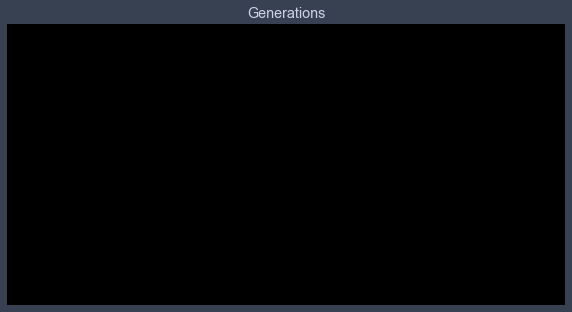

Epoch 26 loss 1.3209227768006604, test L1 = 0.8030340448021889
Epoch 27 loss 1.4007729715907697, test L1 = 0.8002895712852478
Epoch 28 loss 1.9130165908754486, test L1 = 0.8047764152288437
Epoch 29 loss 1.1653342658711463, test L1 = 0.7909857295453548


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 1.440823982876191, test L1 = 0.8046477772295475
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


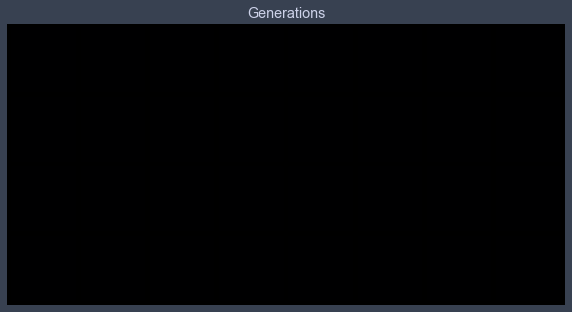

Epoch 31 loss 1.710797023937055, test L1 = 0.8068529367446899
Epoch 32 loss 1.0006602386019074, test L1 = 0.8016234822571278
Epoch 33 loss 1.7725083369160026, test L1 = 0.7942775636911392
Epoch 34 loss 0.99872166000281, test L1 = 0.8015913441777229
Epoch 35 loss 1.3776608732148135, test L1 = 0.8081923648715019
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


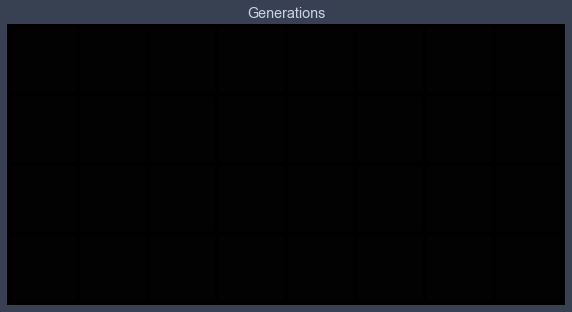

Epoch 36 loss 1.0092190645404697, test L1 = 0.8020553700625896
Epoch 37 loss 1.4592426912891086, test L1 = 0.8079379871487617
Epoch 38 loss 1.2072159770837765, test L1 = 0.8000673688948154
Epoch 39 loss 1.144784186713884, test L1 = 0.8065286725759506


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 1.2309388446644, test L1 = 0.8035427816212177
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


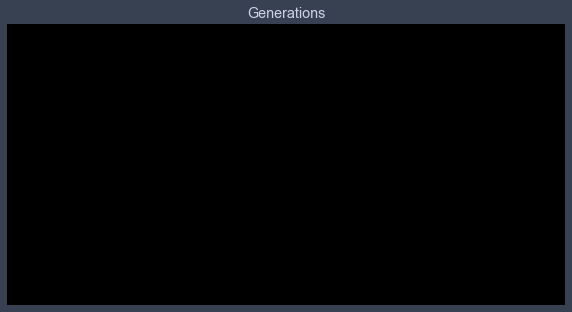

Epoch 41 loss 1.0708955606234443, test L1 = 0.8062194362282753
Epoch 42 loss 1.2769100471460533, test L1 = 0.8079790249466896
Epoch 43 loss 1.1570463262472774, test L1 = 0.8005445450544357
Epoch 44 loss 1.0937037230357272, test L1 = 0.805379144847393
Epoch 45 loss 1.1475347020372082, test L1 = 0.8083497658371925
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


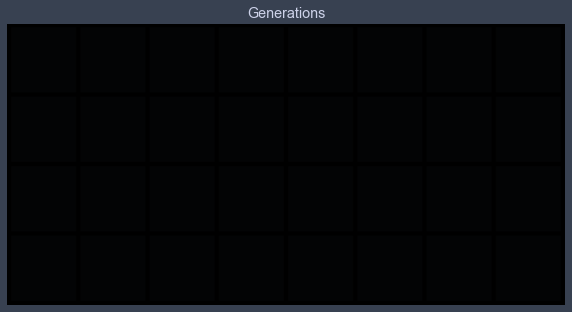







~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=64 | LR=0.0001
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 1.0394623177158053, test L1 = 0.780087523162365
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


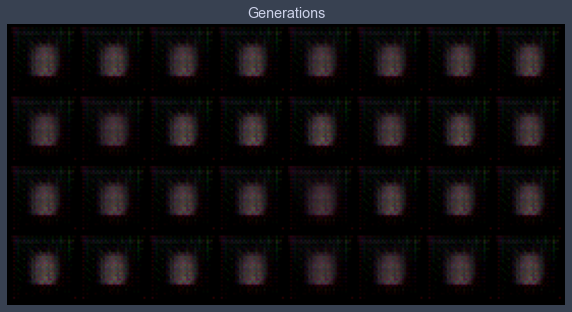

Epoch 1 loss 0.9582482482149839, test L1 = 0.7946555092930794
Epoch 2 loss 0.9414652018612603, test L1 = 0.7317255325615406
Epoch 3 loss 0.9145264932789754, test L1 = 0.7421567104756832
Epoch 4 loss 0.9037745672812576, test L1 = 0.7380928434431553


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 0.8998446401042217, test L1 = 0.743880607187748
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


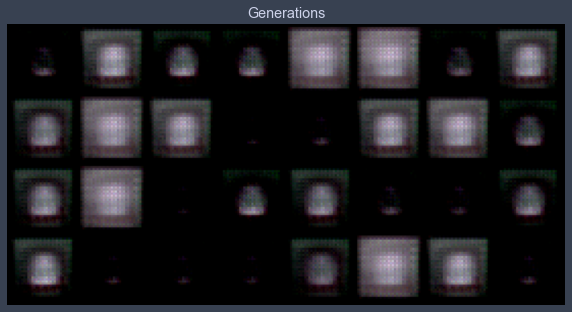

Epoch 6 loss 0.8953706986715704, test L1 = 0.7442748658359051
Epoch 7 loss 0.8925593372472783, test L1 = 0.7418408468365669
Epoch 8 loss 0.8906546216650107, test L1 = 0.7348679527640343
Epoch 9 loss 0.8884832947114899, test L1 = 0.7385955527424812


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 0.8870116580802551, test L1 = 0.7367878779768944
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


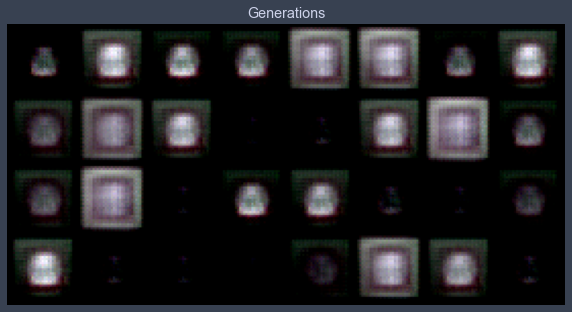

Epoch 11 loss 0.884615265217024, test L1 = 0.7402180321514606
Epoch 12 loss 0.883683701151425, test L1 = 0.738365113735199
Epoch 13 loss 0.8821433061586622, test L1 = 0.7254660576581955
Epoch 14 loss 0.8806645306934606, test L1 = 0.7163725234568119


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 0.8803559273378956, test L1 = 0.7420139536261559
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


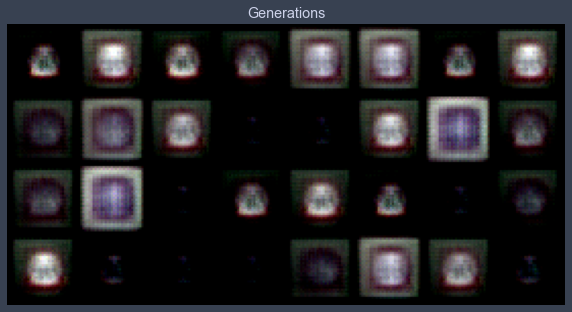

Epoch 16 loss 0.8786914108954754, test L1 = 0.749474186450243
Epoch 17 loss 0.8782301538998318, test L1 = 0.7335432134568691
Epoch 18 loss 0.8773268403875869, test L1 = 0.7432027980685234
Epoch 19 loss 0.8758099834943555, test L1 = 0.7407827749848366


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 0.8756159048309851, test L1 = 0.7218383736908436
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


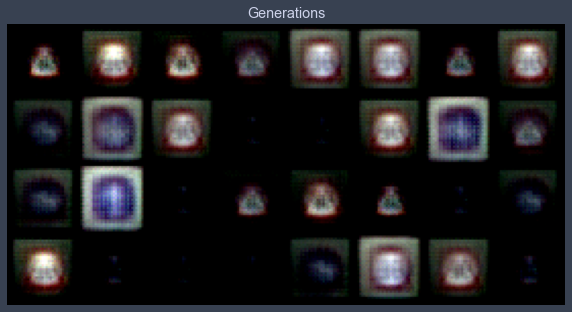

Epoch 21 loss 0.8742448269706411, test L1 = 0.729708980768919
Epoch 22 loss 0.8728616831638559, test L1 = 0.7158903665840626
Epoch 23 loss 0.8724399125043469, test L1 = 0.7379566058516502
Epoch 24 loss 0.870973625338774, test L1 = 0.7220886163413525


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 0.870082671290001, test L1 = 0.7313897646963596
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


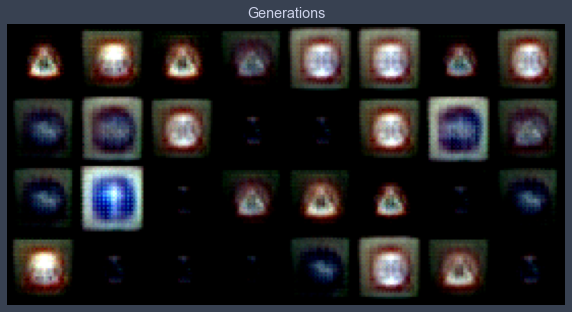

Epoch 26 loss 0.8690035281722078, test L1 = 0.7341479770839214
Epoch 27 loss 0.8686217153604907, test L1 = 0.7214023284614086
Epoch 28 loss 0.8678229637572036, test L1 = 0.7189045436680317
Epoch 29 loss 0.8662131678607455, test L1 = 0.7253883183002472


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 0.864684444112876, test L1 = 0.7202285081148148
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


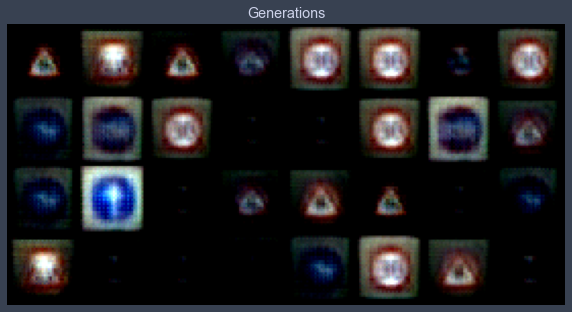

Epoch 31 loss 0.8642950836325839, test L1 = 0.7202114164829254
Epoch 32 loss 0.8631641907790273, test L1 = 0.7118443511426449
Epoch 33 loss 0.8611010059048629, test L1 = 0.7235786728560925
Epoch 34 loss 0.8604349692662557, test L1 = 0.7222166247665882


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 0.8596751116395406, test L1 = 0.7201803624629974
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


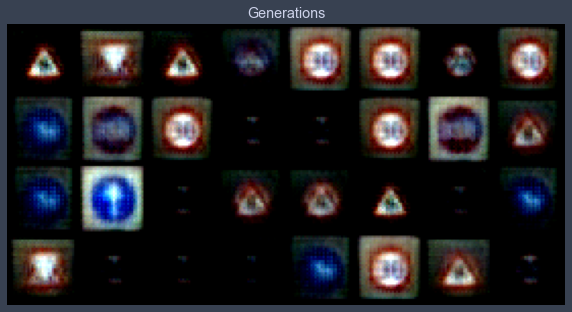

Epoch 36 loss 0.8577854154036217, test L1 = 0.7186304144561291
Epoch 37 loss 0.8571046400315983, test L1 = 0.7218918018043041
Epoch 38 loss 0.8560553547442984, test L1 = 0.718684334307909
Epoch 39 loss 0.8547843319853556, test L1 = 0.7282824739813805


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 0.853928482614432, test L1 = 0.708660650998354
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


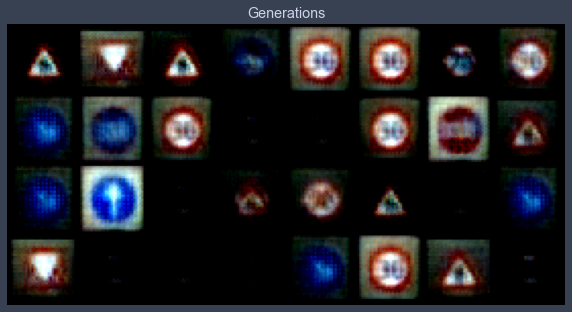

Epoch 41 loss 0.8531155328160709, test L1 = 0.7224323786795139
Epoch 42 loss 0.8532508658789277, test L1 = 0.7128082290291786
Epoch 43 loss 0.8514036642726754, test L1 = 0.7237135879695415
Epoch 44 loss 0.8510600883526491, test L1 = 0.7198607139289379


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 0.8498988010219692, test L1 = 0.718836423009634
test_fixed_labels=tensor([19, 13, 26, 39,  1,  1,  4,  2, 38, 40,  9,  8, 10,  9, 14, 25, 33, 35,
        10, 30, 32, 26,  5, 38, 13,  5, 10,  5, 38,  1, 18,  7],
       device='cuda:0')


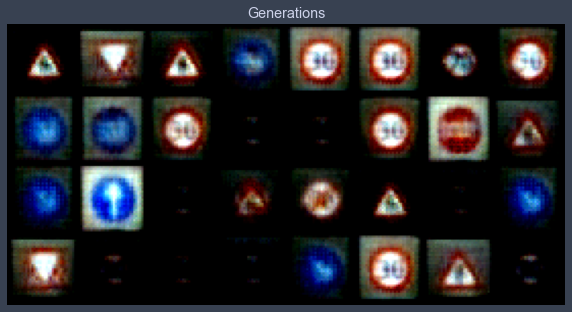

In [39]:
validate_models = []
for val_latent_size, val_lr in h_params:
    val_signs_vae = SignsVAE(latent_dim=val_latent_size, classess_size=N_OF_CLASSESS).to(device)
    val_optimizer = optim.Adam(val_signs_vae.parameters(), lr=val_lr)
    val_scheduler = optim.lr_scheduler.ExponentialLR(optimizer=val_optimizer, gamma=0.99)
    print("~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~")
    print(f"LATENT SIZE={val_latent_size} | LR={val_lr}")
    print("~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~")

    validate_vae_training(vae_model=val_signs_vae, vae_optimizer=val_optimizer, vae_train_loader=train_loader,
                              vae_valid_loader=valid_loader, vae_scheduler=val_scheduler,
                              test_fixed_noise=val_fixed_noise, test_fixed_labels_one_hot=val_fixed_labels_one_hot,
                              test_fixed_labels=val_fixed_labels, latent_size=val_latent_size, num_epochs=46)

    print("\n" * 5)
    state_dict = val_signs_vae.state_dict()
    torch.save(state_dict, f"models/2_lat{val_latent_size}_lr{val_lr}.tar")
    validate_models.append(val_signs_vae)

In [ ]:
def perform_vae_training_val(vae_model, vae_optimizer, vae_train_loader, vae_valid_loader, vae_scheduler, test_fixed_noise, test_fixed_labels_one_hot, test_fixed_labels, num_epochs=50):
    for epoch in range(num_epochs):
        losses_epoch = []
        for x, y in iter(vae_train_loader):
            x = x.to(device)
            y = Functional.one_hot(y, numb_classess).to(device).float()
            out, means, log_var = vae_model(x, y)
            loss = vae_loss_function(x, out, means, log_var)
            losses_epoch.append(loss.item())
            loss.backward()
            vae_optimizer.step()
            vae_optimizer.zero_grad()
        L1_list = []
        with torch.no_grad():
            for x, y in iter(vae_valid_loader):
                x  = x.to(device)
                y = Functional.one_hot(y, numb_classess).to(device).float()
                out, _, _ = vae_model(x, y)
                L1_list.append(torch.mean(torch.abs(out-x)).item())
            print(f"Epoch {epoch} loss {np.mean(np.array(losses_epoch))}, test L1 = {np.mean(L1_list)}")
            if epoch % 5 ==0:
                print(f"{test_fixed_labels=}")
                fake_gens = vae_model.decoder(test_fixed_noise, test_fixed_labels_one_hot).detach().cpu()
                denormalize_batch(fake_gens)
                grid = torchvision.utils.make_grid(fake_gens)
                grid = grid.permute(1, 2, 0)
                plt.figure(figsize=(10,10))
                plt.title(f"Generations")
                plt.imshow(grid)
                plt.axis('off')
                plt.show()

        vae_scheduler.step()

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=128 | LR=0.0001
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 14.843941450938326, test L1 = 0.791470255702734
test_fixed_labels=tensor([11, 26, 24, 19, 13, 38, 10, 12, 12, 12, 31, 14,  4,  4,  2,  2],
       device='cuda:0')


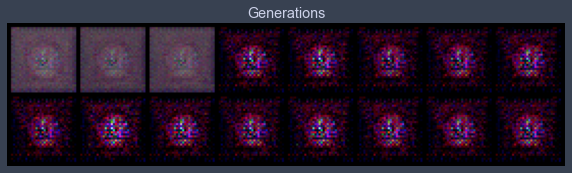

Epoch 1 loss 1.704718871214955, test L1 = 0.7738882973790169
Epoch 2 loss 1.2623570129224115, test L1 = 0.75560437515378
Epoch 3 loss 1.0961667518435474, test L1 = 0.7509198002517223
Epoch 4 loss 0.995862881547397, test L1 = 0.7418278902769089


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 0.9454589914210474, test L1 = 0.7415127344429493
test_fixed_labels=tensor([11, 26, 24, 19, 13, 38, 10, 12, 12, 12, 31, 14,  4,  4,  2,  2],
       device='cuda:0')


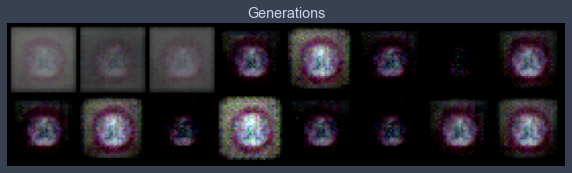

Epoch 6 loss 0.9231445381731512, test L1 = 0.7408033423125744
Epoch 7 loss 0.9060244095284504, test L1 = 0.738241408020258
Epoch 8 loss 0.8988551278294566, test L1 = 0.7392106913030148
Epoch 9 loss 0.8934415677159103, test L1 = 0.7335368022322655


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 0.8896453403115682, test L1 = 0.7340905778110027
test_fixed_labels=tensor([11, 26, 24, 19, 13, 38, 10, 12, 12, 12, 31, 14,  4,  4,  2,  2],
       device='cuda:0')


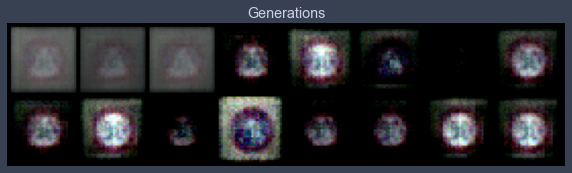

Epoch 11 loss 0.8833164742722135, test L1 = 0.7361102141439915
Epoch 12 loss 0.879355047166962, test L1 = 0.7294288314878941
Epoch 13 loss 0.8769194242061209, test L1 = 0.7274205684661865
Epoch 14 loss 0.8730900799695569, test L1 = 0.7273579053580761


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 0.8711002327732205, test L1 = 0.7283975221216679
test_fixed_labels=tensor([11, 26, 24, 19, 13, 38, 10, 12, 12, 12, 31, 14,  4,  4,  2,  2],
       device='cuda:0')


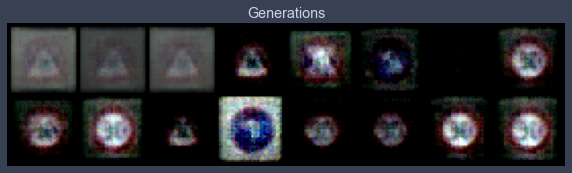

Epoch 16 loss 0.8683100668425413, test L1 = 0.7240035124123096
Epoch 17 loss 0.8659868334576846, test L1 = 0.724083911627531
Epoch 18 loss 0.8642158569748869, test L1 = 0.7222317047417164
Epoch 19 loss 0.8615969624306328, test L1 = 0.7263544164597988


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 0.8601473221664167, test L1 = 0.7244049534201622
test_fixed_labels=tensor([11, 26, 24, 19, 13, 38, 10, 12, 12, 12, 31, 14,  4,  4,  2,  2],
       device='cuda:0')


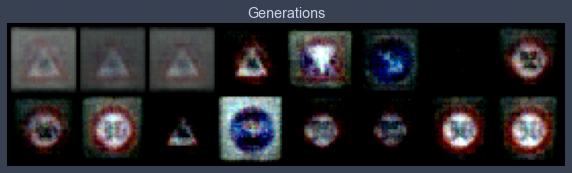

Epoch 21 loss 0.8582911642965992, test L1 = 0.7197375372052193
Epoch 22 loss 0.8564264444551107, test L1 = 0.7230363823473454
Epoch 23 loss 0.8606345587989309, test L1 = 0.723113875836134
Epoch 24 loss 0.8549610232979161, test L1 = 0.7212367355823517


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 0.8526085096945877, test L1 = 0.7197593711316586
test_fixed_labels=tensor([11, 26, 24, 19, 13, 38, 10, 12, 12, 12, 31, 14,  4,  4,  2,  2],
       device='cuda:0')


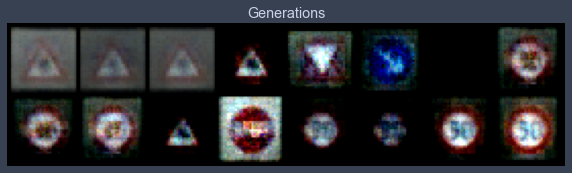

Epoch 26 loss 0.8509666886935938, test L1 = 0.7159378565847874
Epoch 27 loss 0.8503346824154412, test L1 = 0.7161566764116287
Epoch 28 loss 0.8499173351989169, test L1 = 0.7149445377290249
Epoch 29 loss 0.8487310153512201, test L1 = 0.7179923467338085


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 0.8480941286611393, test L1 = 0.7174328565597534
test_fixed_labels=tensor([11, 26, 24, 19, 13, 38, 10, 12, 12, 12, 31, 14,  4,  4,  2,  2],
       device='cuda:0')


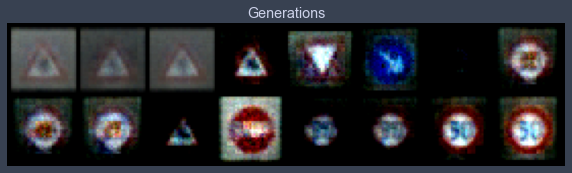

Epoch 31 loss 0.8527881533829207, test L1 = 0.7134056054055691
Epoch 32 loss 0.8463461761622085, test L1 = 0.7163961715996265
Epoch 33 loss 0.846447336509875, test L1 = 0.7148929610848427
Epoch 34 loss 0.8460169117065639, test L1 = 0.7153654284775257


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 0.845404629240331, test L1 = 0.7118768692016602
test_fixed_labels=tensor([11, 26, 24, 19, 13, 38, 10, 12, 12, 12, 31, 14,  4,  4,  2,  2],
       device='cuda:0')


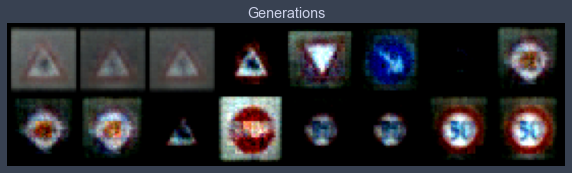

Epoch 36 loss 0.8453739037628436, test L1 = 0.7145861610770226
Epoch 37 loss 0.8450532342560103, test L1 = 0.7152821570634842
Epoch 38 loss 0.843928590263288, test L1 = 0.7123925723135471
Epoch 39 loss 0.8442302086099317, test L1 = 0.715215802192688


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 0.843459802599707, test L1 = 0.7093039564788342
test_fixed_labels=tensor([11, 26, 24, 19, 13, 38, 10, 12, 12, 12, 31, 14,  4,  4,  2,  2],
       device='cuda:0')


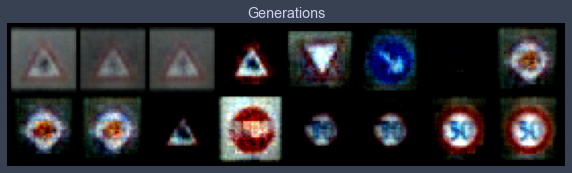

Epoch 41 loss 0.8435040013896641, test L1 = 0.7135806456208229
Epoch 42 loss 0.8423876532983944, test L1 = 0.7118822857737541
Epoch 43 loss 0.8426330321023554, test L1 = 0.7095410488545895
Epoch 44 loss 0.8414060512359199, test L1 = 0.712111234664917


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 0.8419448727184964, test L1 = 0.7113604359328747
test_fixed_labels=tensor([11, 26, 24, 19, 13, 38, 10, 12, 12, 12, 31, 14,  4,  4,  2,  2],
       device='cuda:0')


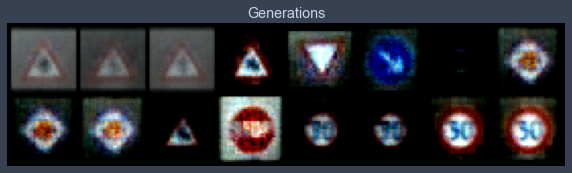

Epoch 46 loss 0.8415264581486941, test L1 = 0.7109781093895435
Epoch 47 loss 0.8408455328433374, test L1 = 0.7122981362044811
Epoch 48 loss 0.8407586372595063, test L1 = 0.7099933885037899
Epoch 49 loss 0.8415380366069755, test L1 = 0.7095676772296429






~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=128 | LR=0.001
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 192.15716847644228, test L1 = 0.7491943500936031
test_fixed_labels=tensor([15, 31,  5, 10,  5, 35, 24,  1, 35,  9, 42, 38, 11,  1, 16, 13],
       device='cuda:0')


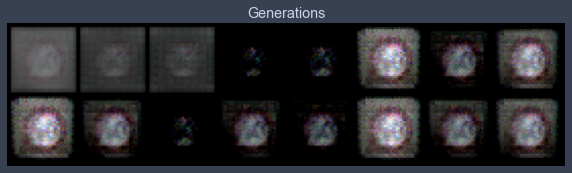

Epoch 1 loss 2078.9219597559613, test L1 = 0.7453707568347454
Epoch 2 loss 410.66577031747585, test L1 = 0.7317020557820797
Epoch 3 loss 2.3824430779902794, test L1 = 0.7310669980943203
Epoch 4 loss 1.414105416163546, test L1 = 0.7239421419799328


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 0.8822730849288993, test L1 = 0.7193334847688675
test_fixed_labels=tensor([15, 31,  5, 10,  5, 35, 24,  1, 35,  9, 42, 38, 11,  1, 16, 13],
       device='cuda:0')


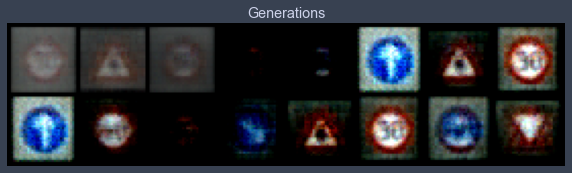

Epoch 6 loss 1.0876999360179573, test L1 = 0.7183580510318279
Epoch 7 loss 0.9082349811222955, test L1 = 0.7151306681334972
Epoch 8 loss 0.8518074580893893, test L1 = 0.7147480770945549
Epoch 9 loss 0.8612999455216005, test L1 = 0.7111418843269348


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 0.8449078212488967, test L1 = 0.7136075124144554
test_fixed_labels=tensor([15, 31,  5, 10,  5, 35, 24,  1, 35,  9, 42, 38, 11,  1, 16, 13],
       device='cuda:0')


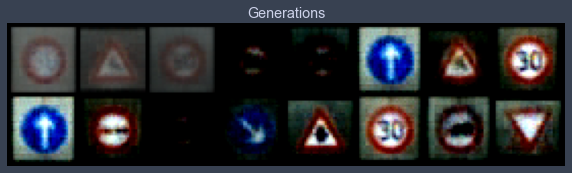

Epoch 11 loss 0.8526530362076775, test L1 = 0.711845837533474
Epoch 12 loss 0.8461417584484795, test L1 = 0.7066822089254856
Epoch 13 loss 0.845243362217015, test L1 = 0.7085815519094467
Epoch 14 loss 0.8400201199390634, test L1 = 0.7050270810723305


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 0.8395563337401426, test L1 = 0.7075022608041763
test_fixed_labels=tensor([15, 31,  5, 10,  5, 35, 24,  1, 35,  9, 42, 38, 11,  1, 16, 13],
       device='cuda:0')


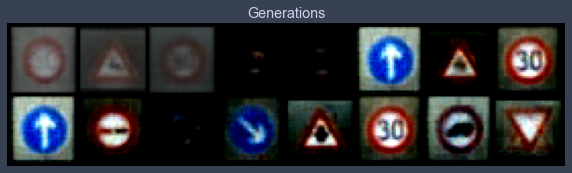

Epoch 16 loss 0.8412587794241627, test L1 = 0.7113574668765068
Epoch 17 loss 0.837639204824913, test L1 = 0.7115434296429157
Epoch 18 loss 0.8391190898377461, test L1 = 0.7048622593283653
Epoch 19 loss 0.8383068577530458, test L1 = 0.7149586901068687


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 0.8380567363856994, test L1 = 0.7093883715569973
test_fixed_labels=tensor([15, 31,  5, 10,  5, 35, 24,  1, 35,  9, 42, 38, 11,  1, 16, 13],
       device='cuda:0')


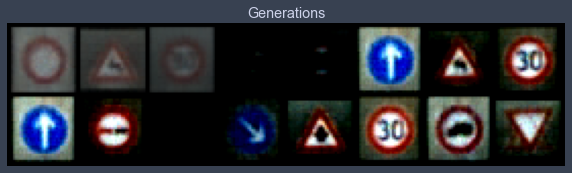

Epoch 21 loss 0.8356434495998002, test L1 = 0.7144851572811604
Epoch 22 loss 0.8364152324568365, test L1 = 0.7107551395893097
Epoch 23 loss 0.8464441147866527, test L1 = 0.7114538997411728
Epoch 24 loss 0.8372060535699641, test L1 = 0.70929891243577


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 0.8348702677746409, test L1 = 0.7099886871874332
test_fixed_labels=tensor([15, 31,  5, 10,  5, 35, 24,  1, 35,  9, 42, 38, 11,  1, 16, 13],
       device='cuda:0')


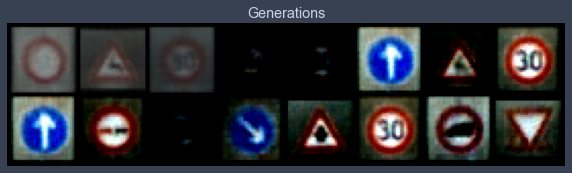

Epoch 26 loss 0.834890915970622, test L1 = 0.7064567692577839
Epoch 27 loss 0.8342923081617585, test L1 = 0.7073336988687515
Epoch 28 loss 0.8341339277647615, test L1 = 0.7119168750941753
Epoch 29 loss 0.8339984087190268, test L1 = 0.7087641321122646


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 0.8347547435268914, test L1 = 0.707048587501049
test_fixed_labels=tensor([15, 31,  5, 10,  5, 35, 24,  1, 35,  9, 42, 38, 11,  1, 16, 13],
       device='cuda:0')


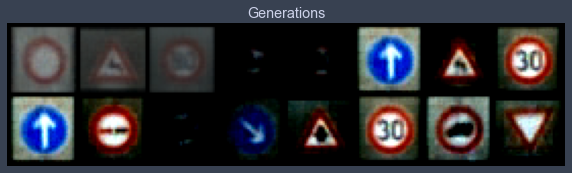

Epoch 31 loss 0.833769952308681, test L1 = 0.7049607187509537
Epoch 32 loss 0.8336004369037667, test L1 = 0.7048190124332905
Epoch 33 loss 0.8330404029269398, test L1 = 0.7085798755288124
Epoch 34 loss 0.8335767212192627, test L1 = 0.7075155787169933


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 0.8331403427107638, test L1 = 0.712182056158781
test_fixed_labels=tensor([15, 31,  5, 10,  5, 35, 24,  1, 35,  9, 42, 38, 11,  1, 16, 13],
       device='cuda:0')


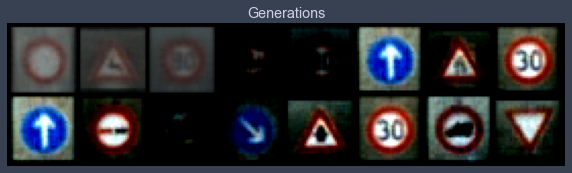

Epoch 36 loss 0.8329884936309762, test L1 = 0.7070722207427025
Epoch 37 loss 0.8333824020890436, test L1 = 0.7105989642441273
Epoch 38 loss 0.8330854990637999, test L1 = 0.7073374018073082
Epoch 39 loss 0.8335287685656466, test L1 = 0.7075523510575294


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 0.8331752317058262, test L1 = 0.7056263498961926
test_fixed_labels=tensor([15, 31,  5, 10,  5, 35, 24,  1, 35,  9, 42, 38, 11,  1, 16, 13],
       device='cuda:0')


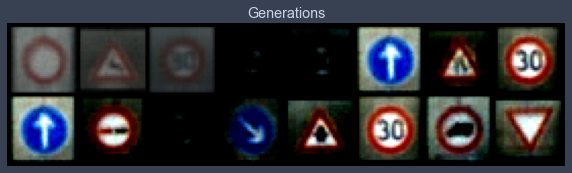

Epoch 41 loss 0.8327055907331381, test L1 = 0.7041207700967789
Epoch 42 loss 0.8333231753500057, test L1 = 0.711062066257
Epoch 43 loss 0.8514338070174673, test L1 = 0.7037205994129181
Epoch 44 loss 0.8319976776326236, test L1 = 0.7068789936602116


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 0.8323340461016521, test L1 = 0.7092253863811493
test_fixed_labels=tensor([15, 31,  5, 10,  5, 35, 24,  1, 35,  9, 42, 38, 11,  1, 16, 13],
       device='cuda:0')


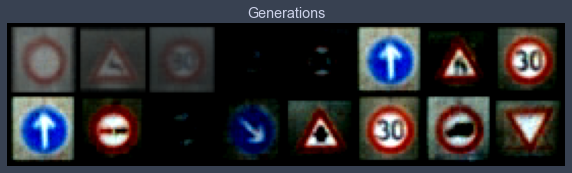

Epoch 46 loss 0.8327196508748425, test L1 = 0.7083884812891483
Epoch 47 loss 0.8316942103130301, test L1 = 0.7073124945163727
Epoch 48 loss 13.27736027748724, test L1 = 0.7099181599915028
Epoch 49 loss 19.663933114087868, test L1 = 0.705919224768877






~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=128 | LR=0.01
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 17495465.07905133, test L1 = 0.7316880896687508
test_fixed_labels=tensor([ 7, 10, 34, 25, 20,  2,  8,  1,  2,  1, 31, 17, 12, 31, 11, 25],
       device='cuda:0')


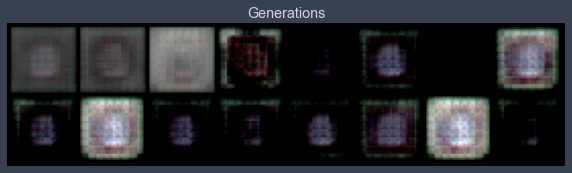

Epoch 1 loss 3844.6500374181164, test L1 = 0.733513031154871
Epoch 2 loss 2272.0359620818567, test L1 = 0.6895107552409172
Epoch 3 loss 1807.5948754798915, test L1 = 0.7122004851698875
Epoch 4 loss 1390.7517257637994, test L1 = 0.7169759459793568


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 1422.6497920190345, test L1 = 0.7158911675214767
test_fixed_labels=tensor([ 7, 10, 34, 25, 20,  2,  8,  1,  2,  1, 31, 17, 12, 31, 11, 25],
       device='cuda:0')


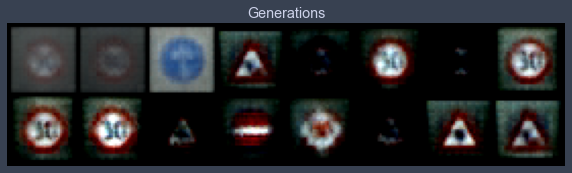

Epoch 6 loss 1272.4570030395928, test L1 = 0.701837096363306
Epoch 7 loss 801.3578812117429, test L1 = 0.712088830769062
Epoch 8 loss 1083.2103306091938, test L1 = 0.7188771367073059
Epoch 9 loss 508.0928444878752, test L1 = 0.7195040993392467


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 265.7894830867597, test L1 = 0.7141832485795021
test_fixed_labels=tensor([ 7, 10, 34, 25, 20,  2,  8,  1,  2,  1, 31, 17, 12, 31, 11, 25],
       device='cuda:0')


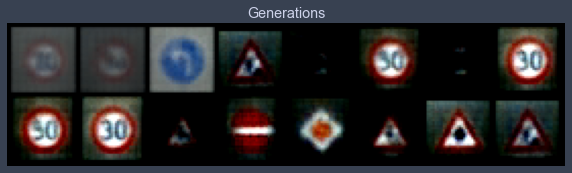

Epoch 11 loss 192.20481380646171, test L1 = 0.7053968235850334
Epoch 12 loss 151.31731062492554, test L1 = 0.718398928642273
Epoch 13 loss 145.6320199786183, test L1 = 0.7124409452080727
Epoch 14 loss 142.16126325777716, test L1 = 0.7051715590059757


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 128.07124478218893, test L1 = 0.7107335887849331
test_fixed_labels=tensor([ 7, 10, 34, 25, 20,  2,  8,  1,  2,  1, 31, 17, 12, 31, 11, 25],
       device='cuda:0')


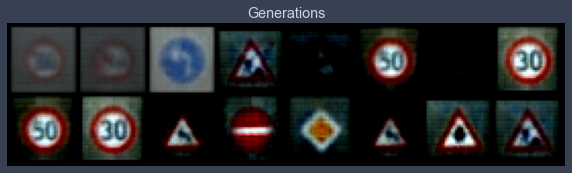

Epoch 16 loss 109.73797539214497, test L1 = 0.7038484252989292
Epoch 17 loss 68.46844350349453, test L1 = 0.7158073671162128
Epoch 18 loss 43.6035198927745, test L1 = 0.705038771033287
Epoch 19 loss 38.456987748850665, test L1 = 0.7165764160454273


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 31.68938218584585, test L1 = 0.7042376883327961
test_fixed_labels=tensor([ 7, 10, 34, 25, 20,  2,  8,  1,  2,  1, 31, 17, 12, 31, 11, 25],
       device='cuda:0')


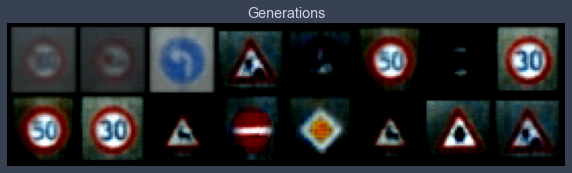

Epoch 21 loss 26.098033293825655, test L1 = 0.6978974863886833
Epoch 22 loss 23.20744324918465, test L1 = 0.7145657353103161
Epoch 23 loss 20.818988203797552, test L1 = 0.7066656462848186
Epoch 24 loss 21.97433803458394, test L1 = 0.7007297575473785


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 21.203293969745896, test L1 = 0.696996908634901
test_fixed_labels=tensor([ 7, 10, 34, 25, 20,  2,  8,  1,  2,  1, 31, 17, 12, 31, 11, 25],
       device='cuda:0')


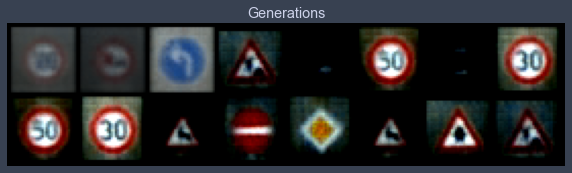

Epoch 26 loss 16.126293138744906, test L1 = 0.6999998763203621
Epoch 27 loss 7.816605887462184, test L1 = 0.709816288203001
Epoch 28 loss 6.128121840994792, test L1 = 0.6989088989794254
Epoch 29 loss 5.262363566156106, test L1 = 0.7115731239318848


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 4.376691440331567, test L1 = 0.7063147202134132
test_fixed_labels=tensor([ 7, 10, 34, 25, 20,  2,  8,  1,  2,  1, 31, 17, 12, 31, 11, 25],
       device='cuda:0')


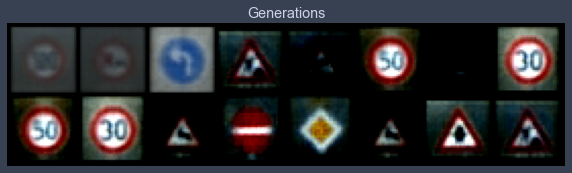

Epoch 31 loss 3.7876639736886695, test L1 = 0.70881212875247
Epoch 32 loss 3.013745583209795, test L1 = 0.6911856196820736
Epoch 33 loss 3.199855768803469, test L1 = 0.6932505331933498
Epoch 34 loss 2.622924790144786, test L1 = 0.7198677361011505


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 2.2504670175490102, test L1 = 0.7104416824877262
test_fixed_labels=tensor([ 7, 10, 34, 25, 20,  2,  8,  1,  2,  1, 31, 17, 12, 31, 11, 25],
       device='cuda:0')


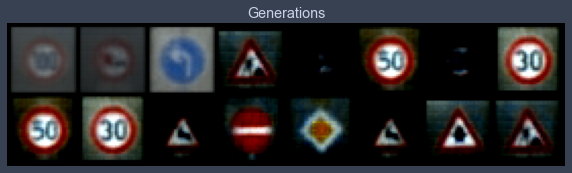

Epoch 36 loss 2.998257732268461, test L1 = 0.7037180438637733
Epoch 37 loss 1991080065.189452, test L1 = 0.792034849524498
Epoch 38 loss 114623021.62159042, test L1 = 0.7104815915226936
Epoch 39 loss 17108.59705722455, test L1 = 0.702777411788702


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 8868.522865321627, test L1 = 0.7148007191717625
test_fixed_labels=tensor([ 7, 10, 34, 25, 20,  2,  8,  1,  2,  1, 31, 17, 12, 31, 11, 25],
       device='cuda:0')


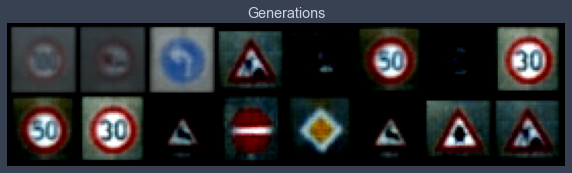

Epoch 41 loss 7419.8452307842035, test L1 = 0.7049620486795902
Epoch 42 loss 3209.048354945232, test L1 = 0.7111785858869553
Epoch 43 loss 2693.0125803734427, test L1 = 0.711311262100935
Epoch 44 loss 2041.1540099468427, test L1 = 0.7012788616120815


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 2034.7114073238831, test L1 = 0.7107036858797073
test_fixed_labels=tensor([ 7, 10, 34, 25, 20,  2,  8,  1,  2,  1, 31, 17, 12, 31, 11, 25],
       device='cuda:0')


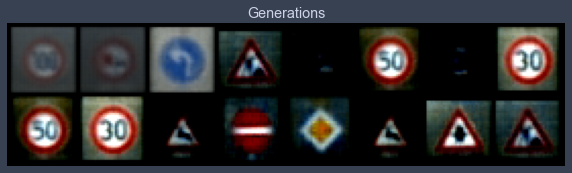

Epoch 46 loss 1370.3599486465716, test L1 = 0.7032503448426723
Epoch 47 loss 1751.985486007638, test L1 = 0.7056125961244106
Epoch 48 loss 508.61380560701247, test L1 = 0.700575690716505
Epoch 49 loss 235.32561553220978, test L1 = 0.7058132067322731






~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=128 | LR=0.1
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 3802537572363.4683, test L1 = 0.7726290225982666
test_fixed_labels=tensor([12,  1, 25,  5, 10,  5, 35, 10, 12,  9, 13, 23, 39, 42,  5,  2],
       device='cuda:0')


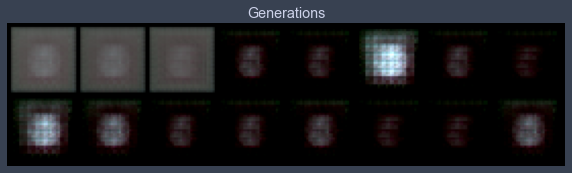

Epoch 1 loss 339256.335588488, test L1 = 0.7388788349926472
Epoch 2 loss 279577.4029209622, test L1 = 0.7380865141749382
Epoch 3 loss 236234.50504725086, test L1 = 0.7257208786904812
Epoch 4 loss 373907.08778994845, test L1 = 0.7062321081757545


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 151372.44657431272, test L1 = 0.7374233864247799
test_fixed_labels=tensor([12,  1, 25,  5, 10,  5, 35, 10, 12,  9, 13, 23, 39, 42,  5,  2],
       device='cuda:0')


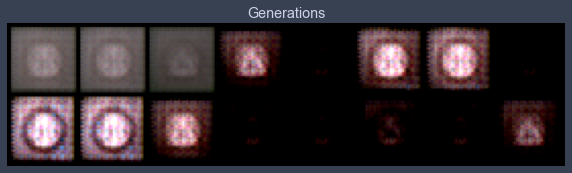

Epoch 6 loss 115300.08787048969, test L1 = 0.7426336742937565
Epoch 7 loss 85514.26361146907, test L1 = 0.7112357802689075
Epoch 8 loss 62318.26869899055, test L1 = 0.706475630402565
Epoch 9 loss 45248.174371778354, test L1 = 0.7135489322245121


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 33357.39654478093, test L1 = 0.7295511588454247
test_fixed_labels=tensor([12,  1, 25,  5, 10,  5, 35, 10, 12,  9, 13, 23, 39, 42,  5,  2],
       device='cuda:0')


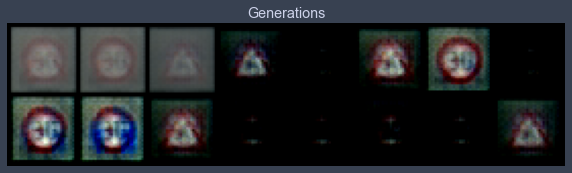

Epoch 11 loss 25359.58531330541, test L1 = 0.6968950033187866
Epoch 12 loss 19983.952225622852, test L1 = 0.7224242649972439
Epoch 13 loss 16294.30203970683, test L1 = 0.7341581881046295
Epoch 14 loss 13599.06155028458, test L1 = 0.7232893891632557


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 11440.72752563896, test L1 = 0.7260433845221996
test_fixed_labels=tensor([12,  1, 25,  5, 10,  5, 35, 10, 12,  9, 13, 23, 39, 42,  5,  2],
       device='cuda:0')


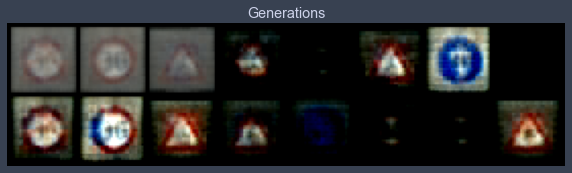

Epoch 16 loss 9699.168572809278, test L1 = 0.7227164767682552
Epoch 17 loss 8287.020454118341, test L1 = 0.7368632294237614
Epoch 18 loss 7156.247712964455, test L1 = 0.7283594533801079
Epoch 19 loss 6292.518009356207, test L1 = 0.7418336309492588


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 5662.00782592354, test L1 = 0.7255922444164753
test_fixed_labels=tensor([12,  1, 25,  5, 10,  5, 35, 10, 12,  9, 13, 23, 39, 42,  5,  2],
       device='cuda:0')


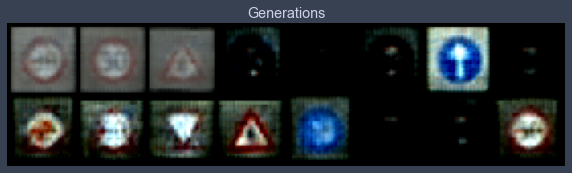

Epoch 21 loss 5222.340617281465, test L1 = 0.7230921350419521
Epoch 22 loss 4927.982052727663, test L1 = 0.714101891964674
Epoch 23 loss 4736.406857415163, test L1 = 0.7417778261005878
Epoch 24 loss 4612.739031290271, test L1 = 0.6956089846789837


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 4531.6599431513105, test L1 = 0.7268328778445721
test_fixed_labels=tensor([12,  1, 25,  5, 10,  5, 35, 10, 12,  9, 13, 23, 39, 42,  5,  2],
       device='cuda:0')


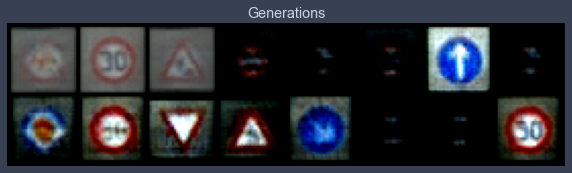

Epoch 26 loss 4476.8092951299395, test L1 = 0.7020896524190903
Epoch 27 loss 4438.582502751826, test L1 = 0.7384012453258038
Epoch 28 loss 4411.607032592354, test L1 = 0.7162187099456787
Epoch 29 loss 4392.746576997422, test L1 = 0.7291549146175385


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 4379.914260497208, test L1 = 0.7138608358800411
test_fixed_labels=tensor([12,  1, 25,  5, 10,  5, 35, 10, 12,  9, 13, 23, 39, 42,  5,  2],
       device='cuda:0')


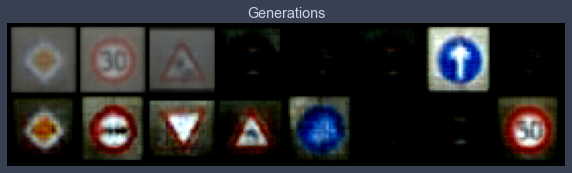

Epoch 31 loss 4371.52246764927, test L1 = 0.6976552158594131
Epoch 32 loss 4366.3035599226805, test L1 = 0.7113605551421642
Epoch 33 loss 4363.237900357066, test L1 = 0.696225568652153
Epoch 34 loss 4361.559327010847, test L1 = 0.7112049199640751


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 4360.705863402062, test L1 = 0.736848920583725
test_fixed_labels=tensor([12,  1, 25,  5, 10,  5, 35, 10, 12,  9, 13, 23, 39, 42,  5,  2],
       device='cuda:0')


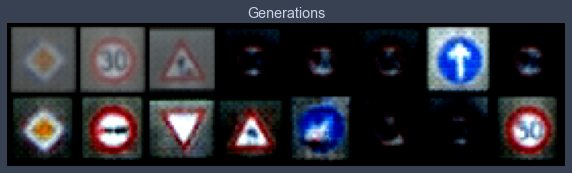

Epoch 36 loss 4360.3118221112545, test L1 = 0.7198582999408245
Epoch 37 loss 4360.144413794029, test L1 = 0.724673755466938
Epoch 38 loss 4360.083387027491, test L1 = 0.7114343754947186
Epoch 39 loss 4360.061902652491, test L1 = 0.7212330214679241


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 4360.055890584729, test L1 = 0.7138893827795982
test_fixed_labels=tensor([12,  1, 25,  5, 10,  5, 35, 10, 12,  9, 13, 23, 39, 42,  5,  2],
       device='cuda:0')


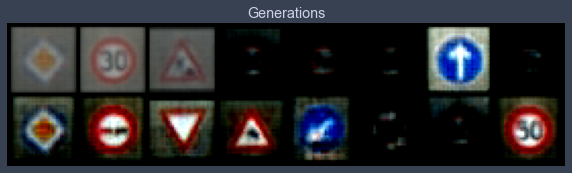

Epoch 41 loss 4360.056081870168, test L1 = 0.7218625284731388
Epoch 42 loss 4360.052507852771, test L1 = 0.7021842487156391
Epoch 43 loss 4360.052970964884, test L1 = 0.7141655199229717
Epoch 44 loss 4360.055028122315, test L1 = 0.6983681581914425


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 4360.05324279156, test L1 = 0.6988643445074558
test_fixed_labels=tensor([12,  1, 25,  5, 10,  5, 35, 10, 12,  9, 13, 23, 39, 42,  5,  2],
       device='cuda:0')


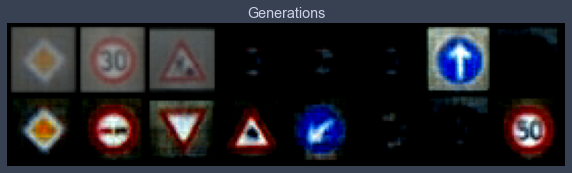

Epoch 46 loss 4360.0525212763105, test L1 = 0.699570145457983
Epoch 47 loss 4360.0521336716065, test L1 = 0.6971610523760319
Epoch 48 loss 4360.052029639175, test L1 = 0.7196302339434624
Epoch 49 loss 4360.0518131846, test L1 = 0.7065057791769505






~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=64 | LR=0.0001
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 8.773456367840062, test L1 = 0.8200556188821793
test_fixed_labels=tensor([10,  1,  5,  5, 20,  8, 11,  8, 14, 18,  1, 23, 13,  4, 13,  8],
       device='cuda:0')


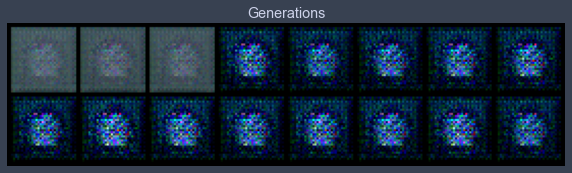

Epoch 1 loss 1.5331739441226029, test L1 = 0.7938032373785973
Epoch 2 loss 1.263467598207218, test L1 = 0.7630981393158436
Epoch 3 loss 1.0998712720739883, test L1 = 0.7486535497009754
Epoch 4 loss 1.0482338671012432, test L1 = 0.7414001747965813


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 1.0331282875791858, test L1 = 0.7365545518696308
test_fixed_labels=tensor([10,  1,  5,  5, 20,  8, 11,  8, 14, 18,  1, 23, 13,  4, 13,  8],
       device='cuda:0')


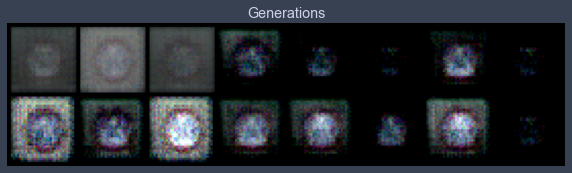

Epoch 6 loss 0.9929778985551133, test L1 = 0.7365776710212231
Epoch 7 loss 0.9486186612922302, test L1 = 0.7421499229967594
Epoch 8 loss 0.9572231421355939, test L1 = 0.7271981947124004
Epoch 9 loss 0.914334237575531, test L1 = 0.7331279329955578


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 0.9034415651432837, test L1 = 0.727476604282856
test_fixed_labels=tensor([10,  1,  5,  5, 20,  8, 11,  8, 14, 18,  1, 23, 13,  4, 13,  8],
       device='cuda:0')


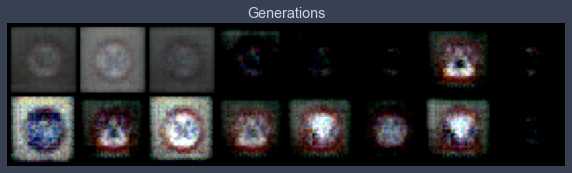

Epoch 11 loss 0.8890293396215668, test L1 = 0.7291031554341316
Epoch 12 loss 0.8805316373245003, test L1 = 0.7221441566944122
Epoch 13 loss 0.8728684098859832, test L1 = 0.7241848967969418
Epoch 14 loss 0.8676931931800449, test L1 = 0.7195284962654114


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 0.8622628128815353, test L1 = 0.7226726189255714
test_fixed_labels=tensor([10,  1,  5,  5, 20,  8, 11,  8, 14, 18,  1, 23, 13,  4, 13,  8],
       device='cuda:0')


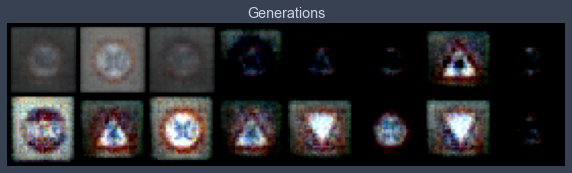

Epoch 16 loss 0.8587364013662043, test L1 = 0.7174748294055462
Epoch 17 loss 0.8558717576908492, test L1 = 0.7183662578463554
Epoch 18 loss 0.8537995604305333, test L1 = 0.7219645045697689
Epoch 19 loss 0.8523843523972633, test L1 = 0.7187623083591461


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 0.8505296117251682, test L1 = 0.716708667576313
test_fixed_labels=tensor([10,  1,  5,  5, 20,  8, 11,  8, 14, 18,  1, 23, 13,  4, 13,  8],
       device='cuda:0')


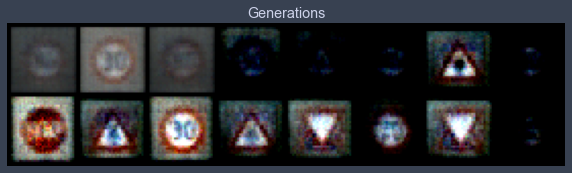

Epoch 21 loss 0.84993455131439, test L1 = 0.7150761038064957
Epoch 22 loss 0.8485130126943293, test L1 = 0.7141851857304573
Epoch 23 loss 0.8479063519087854, test L1 = 0.7155310548841953
Epoch 24 loss 0.846421987330381, test L1 = 0.7144908122718334


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 0.8462065368173868, test L1 = 0.7163368426263332
test_fixed_labels=tensor([10,  1,  5,  5, 20,  8, 11,  8, 14, 18,  1, 23, 13,  4, 13,  8],
       device='cuda:0')


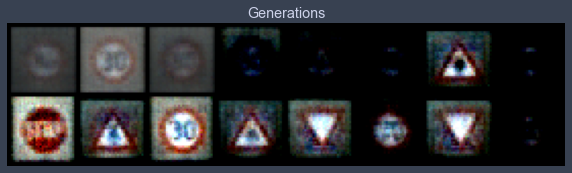

Epoch 26 loss 0.845891364251625, test L1 = 0.7119320817291737
Epoch 27 loss 0.8452634997793899, test L1 = 0.7186114601790905
Epoch 28 loss 0.8446748248490271, test L1 = 0.710044976323843
Epoch 29 loss 0.8435493533553946, test L1 = 0.7149419710040092


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 0.8433548994490371, test L1 = 0.7125454358756542
test_fixed_labels=tensor([10,  1,  5,  5, 20,  8, 11,  8, 14, 18,  1, 23, 13,  4, 13,  8],
       device='cuda:0')


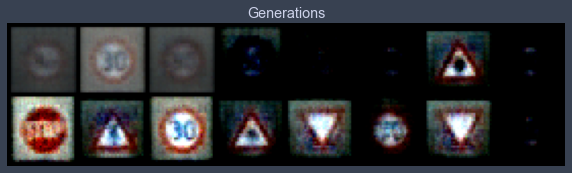

Epoch 31 loss 0.8432557232601127, test L1 = 0.7145014442503452
Epoch 32 loss 0.8427437203856268, test L1 = 0.715528879314661
Epoch 33 loss 0.8420376863676248, test L1 = 0.7100302986800671
Epoch 34 loss 0.842166274683582, test L1 = 0.7121034525334835


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 0.8411014239812634, test L1 = 0.7078858651220798
test_fixed_labels=tensor([10,  1,  5,  5, 20,  8, 11,  8, 14, 18,  1, 23, 13,  4, 13,  8],
       device='cuda:0')


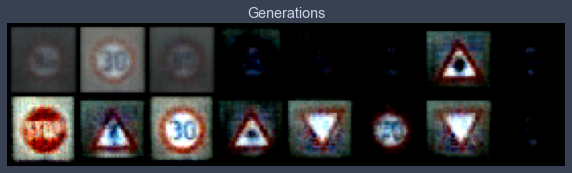

Epoch 36 loss 0.8413346082074535, test L1 = 0.712213259190321
Epoch 37 loss 0.8403836619813008, test L1 = 0.7099212594330311
Epoch 38 loss 0.8401605536028282, test L1 = 0.7094492018222809
Epoch 39 loss 0.8397654665704445, test L1 = 0.7148696184158325


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 0.841184359031035, test L1 = 0.7084091641008854
test_fixed_labels=tensor([10,  1,  5,  5, 20,  8, 11,  8, 14, 18,  1, 23, 13,  4, 13,  8],
       device='cuda:0')


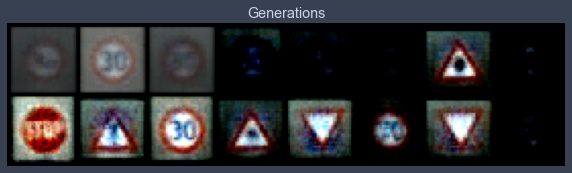

Epoch 41 loss 0.8402583689214438, test L1 = 0.7108150608837605
Epoch 42 loss 0.8389899427538475, test L1 = 0.7127697765827179
Epoch 43 loss 0.8387772342593399, test L1 = 0.7075657323002815
Epoch 44 loss 0.8387621960689112, test L1 = 0.7119894996285439


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 0.8388927111920622, test L1 = 0.7079390436410904
test_fixed_labels=tensor([10,  1,  5,  5, 20,  8, 11,  8, 14, 18,  1, 23, 13,  4, 13,  8],
       device='cuda:0')


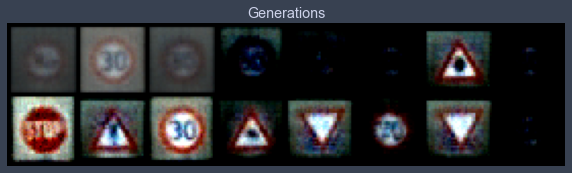

Epoch 46 loss 0.8382907003881186, test L1 = 0.7066253460943699
Epoch 47 loss 0.8378898794298729, test L1 = 0.7147415913641453
Epoch 48 loss 0.8381172377628969, test L1 = 0.71268729865551
Epoch 49 loss 0.8381298221263689, test L1 = 0.7078618071973324






~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=64 | LR=0.001
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 34.523152162938594, test L1 = 0.7492166198790073
test_fixed_labels=tensor([ 5, 41, 15,  1, 38, 10,  8, 13,  4, 13,  2, 13,  7, 12, 14, 18],
       device='cuda:0')


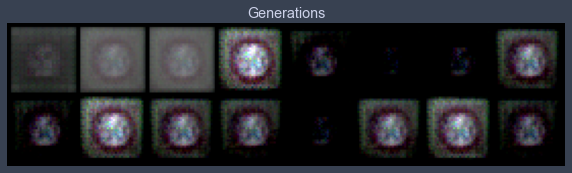

Epoch 1 loss 34232.34670676501, test L1 = 0.7424316182732582
Epoch 2 loss 40.35714402477356, test L1 = 0.7353399768471718
Epoch 3 loss 19.04217526593159, test L1 = 0.7286365665495396
Epoch 4 loss 11.595500527788273, test L1 = 0.7275478467345238


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 12.348632373351002, test L1 = 0.7162445820868015
test_fixed_labels=tensor([ 5, 41, 15,  1, 38, 10,  8, 13,  4, 13,  2, 13,  7, 12, 14, 18],
       device='cuda:0')


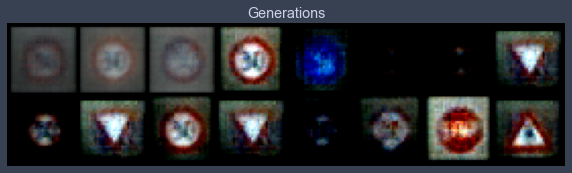

Epoch 6 loss 47.67135936124218, test L1 = 0.7115074805915356
Epoch 7 loss 155.8907041377628, test L1 = 0.7152898870408535
Epoch 8 loss 4.663492407585747, test L1 = 0.7163763307034969
Epoch 9 loss 3.6290067776371933, test L1 = 0.7104826383292675


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 2.8991351762588082, test L1 = 0.710384912788868
test_fixed_labels=tensor([ 5, 41, 15,  1, 38, 10,  8, 13,  4, 13,  2, 13,  7, 12, 14, 18],
       device='cuda:0')


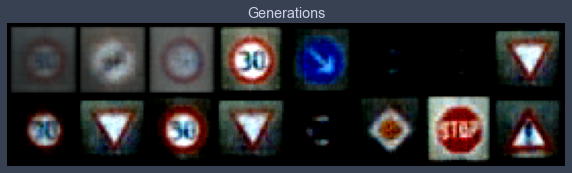

Epoch 11 loss 6.2280964152919465, test L1 = 0.7113708108663559
Epoch 12 loss 5.441556700316491, test L1 = 0.7064726017415524
Epoch 13 loss 1.9233105043365373, test L1 = 0.7030114606022835
Epoch 14 loss 1.6040138102478998, test L1 = 0.7110063657164574


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 1.36058333342018, test L1 = 0.7077287510037422
test_fixed_labels=tensor([ 5, 41, 15,  1, 38, 10,  8, 13,  4, 13,  2, 13,  7, 12, 14, 18],
       device='cuda:0')


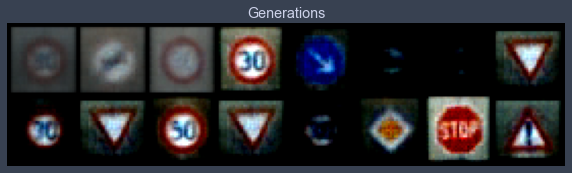

Epoch 16 loss 1.5467511323309435, test L1 = 0.7047873772680759
Epoch 17 loss 1.184375193315683, test L1 = 0.7050597481429577
Epoch 18 loss 1.0828589612675696, test L1 = 0.7094597928225994
Epoch 19 loss 1.1001453256279332, test L1 = 0.7077630832791328


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 1.345209124366852, test L1 = 0.7062166295945644
test_fixed_labels=tensor([ 5, 41, 15,  1, 38, 10,  8, 13,  4, 13,  2, 13,  7, 12, 14, 18],
       device='cuda:0')


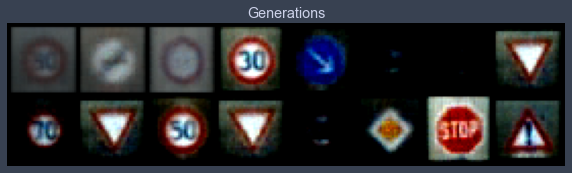

Epoch 21 loss 1.2627627806565196, test L1 = 0.703021202236414
Epoch 22 loss 0.9767389238085534, test L1 = 0.7125189490616322
Epoch 23 loss 1.0409341337754554, test L1 = 0.7061409614980221
Epoch 24 loss 0.9311596765550961, test L1 = 0.7061095759272575


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 1.2333169663484973, test L1 = 0.7057275325059891
test_fixed_labels=tensor([ 5, 41, 15,  1, 38, 10,  8, 13,  4, 13,  2, 13,  7, 12, 14, 18],
       device='cuda:0')


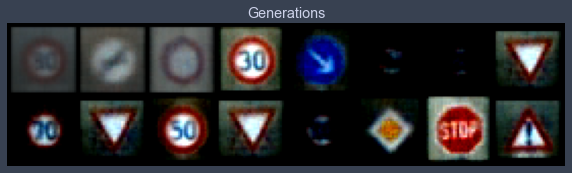

Epoch 26 loss 1.31741428989725, test L1 = 0.7073468789458275
Epoch 27 loss 0.9712162566758513, test L1 = 0.7087303474545479
Epoch 28 loss 0.8798782839807858, test L1 = 0.705370768904686
Epoch 29 loss 0.8873333519267053, test L1 = 0.7058582529425621


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 0.8618306949785894, test L1 = 0.7074655778706074
test_fixed_labels=tensor([ 5, 41, 15,  1, 38, 10,  8, 13,  4, 13,  2, 13,  7, 12, 14, 18],
       device='cuda:0')


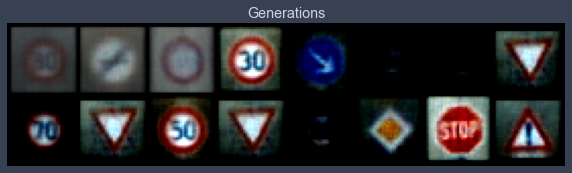

Epoch 31 loss 0.8495415940727156, test L1 = 0.707895215600729
Epoch 32 loss 0.8985110146483195, test L1 = 0.7082547657191753
Epoch 33 loss 0.871901122360295, test L1 = 0.7044733986258507
Epoch 34 loss 0.8487214515708976, test L1 = 0.7084730677306652


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 0.8434890940836615, test L1 = 0.7076137252151966
test_fixed_labels=tensor([ 5, 41, 15,  1, 38, 10,  8, 13,  4, 13,  2, 13,  7, 12, 14, 18],
       device='cuda:0')


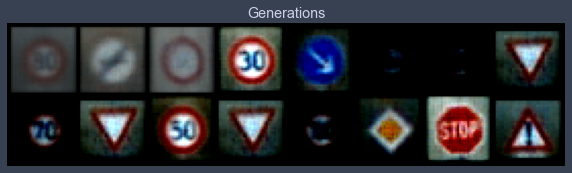

Epoch 36 loss 0.8835111479578969, test L1 = 0.7056330889463425
Epoch 37 loss 0.8906868921522423, test L1 = 0.7038806863129139
Epoch 38 loss 0.8497243161054001, test L1 = 0.7103622369468212
Epoch 39 loss 0.8375906135208419, test L1 = 0.7052427306771278


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 0.8484102174178841, test L1 = 0.7108804099261761
test_fixed_labels=tensor([ 5, 41, 15,  1, 38, 10,  8, 13,  4, 13,  2, 13,  7, 12, 14, 18],
       device='cuda:0')


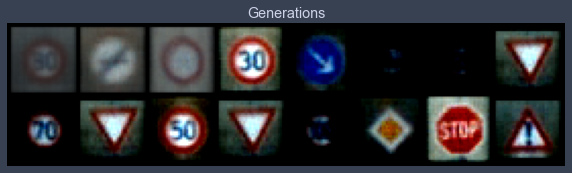

Epoch 41 loss 0.8372556659364209, test L1 = 0.7077824547886848
Epoch 42 loss 0.8360989112214944, test L1 = 0.708090215921402
Epoch 43 loss 0.8372036224787998, test L1 = 0.70547054708004
Epoch 44 loss 0.8330342269845025, test L1 = 0.7075577192008495


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 0.8331142209239841, test L1 = 0.7030831761658192
test_fixed_labels=tensor([ 5, 41, 15,  1, 38, 10,  8, 13,  4, 13,  2, 13,  7, 12, 14, 18],
       device='cuda:0')


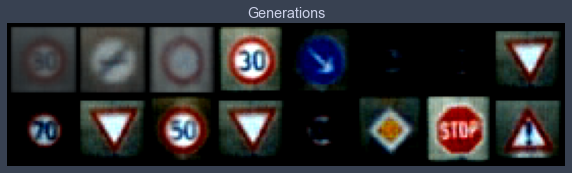

Epoch 46 loss 0.8325622542617247, test L1 = 0.7049580290913582
Epoch 47 loss 0.8328828694894141, test L1 = 0.7084031067788601
Epoch 48 loss 0.8336171757724277, test L1 = 0.7097430042922497
Epoch 49 loss 0.8386531058455661, test L1 = 0.7051240392029285






~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=64 | LR=0.01
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 7264129.144029598, test L1 = 0.7310373745858669
test_fixed_labels=tensor([ 1, 10,  1, 15,  2, 18,  1,  1, 38, 20, 41,  1, 13,  9,  1, 12],
       device='cuda:0')


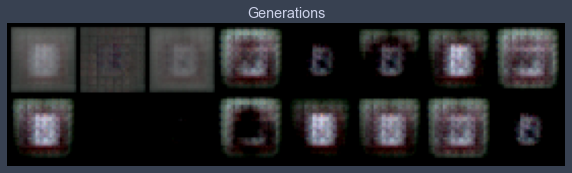

Epoch 1 loss 2954.886047573024, test L1 = 0.7166135609149933
Epoch 2 loss 1282.110968835575, test L1 = 0.7244392484426498
Epoch 3 loss 864.5816334727704, test L1 = 0.7221605405211449
Epoch 4 loss 703.0945985669532, test L1 = 0.7114912383258343


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 686.8641738367245, test L1 = 0.7190080918371677
test_fixed_labels=tensor([ 1, 10,  1, 15,  2, 18,  1,  1, 38, 20, 41,  1, 13,  9,  1, 12],
       device='cuda:0')


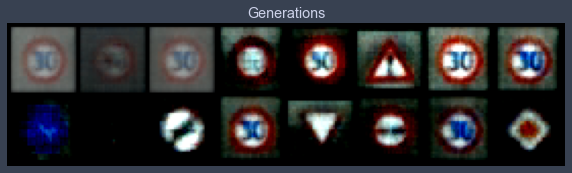

Epoch 6 loss 598.0002663995801, test L1 = 0.7155932933092117
Epoch 7 loss 1056.9085301271418, test L1 = 0.716152984648943
Epoch 8 loss 130.48471227052696, test L1 = 0.7070964649319649
Epoch 9 loss 56.025844058629986, test L1 = 0.7098106369376183


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 50.35141097188406, test L1 = 0.7049776948988438
test_fixed_labels=tensor([ 1, 10,  1, 15,  2, 18,  1,  1, 38, 20, 41,  1, 13,  9,  1, 12],
       device='cuda:0')


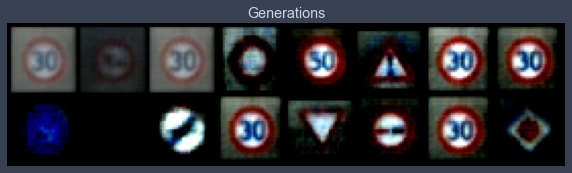

Epoch 11 loss 33.426750231854285, test L1 = 0.7068706043064594
Epoch 12 loss 17.487300900249547, test L1 = 0.7058736570179462
Epoch 13 loss 15.50249041028039, test L1 = 0.7115580216050148
Epoch 14 loss 16.32058839412899, test L1 = 0.6991774253547192


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 14.145442649875719, test L1 = 0.7124400474131107
test_fixed_labels=tensor([ 1, 10,  1, 15,  2, 18,  1,  1, 38, 20, 41,  1, 13,  9,  1, 12],
       device='cuda:0')


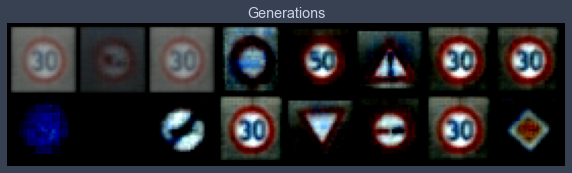

Epoch 16 loss 47.386319741145854, test L1 = 0.7087505981326103
Epoch 17 loss 9.288362032359409, test L1 = 0.7057442851364613
Epoch 18 loss 5.941561427927509, test L1 = 0.7019577510654926
Epoch 19 loss 6.060532277187531, test L1 = 0.7206766046583652


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 3.8533586865847873, test L1 = 0.7051759175956249
test_fixed_labels=tensor([ 1, 10,  1, 15,  2, 18,  1,  1, 38, 20, 41,  1, 13,  9,  1, 12],
       device='cuda:0')


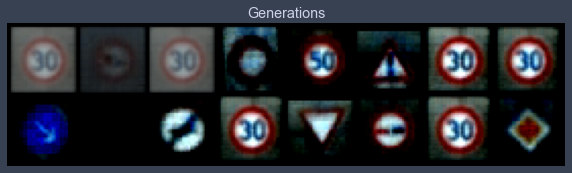

Epoch 21 loss 3.745428244068041, test L1 = 0.7100234590470791
Epoch 22 loss 3.320266101573341, test L1 = 0.7001196630299091
Epoch 23 loss 3.746393580412127, test L1 = 0.706022746860981
Epoch 24 loss 2.3863390962692472, test L1 = 0.6958360485732555


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 2.162977930401609, test L1 = 0.7061997316777706
test_fixed_labels=tensor([ 1, 10,  1, 15,  2, 18,  1,  1, 38, 20, 41,  1, 13,  9,  1, 12],
       device='cuda:0')


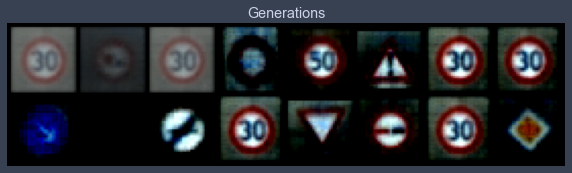

Epoch 26 loss 1.7691848706133997, test L1 = 0.7034097425639629
Epoch 27 loss 1.6228599339416347, test L1 = 0.7044271714985371
Epoch 28 loss 1.4479383451422465, test L1 = 0.7161281332373619
Epoch 29 loss 1.5144322541161501, test L1 = 0.7009237557649612


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 1.3472963264308024, test L1 = 0.7054661586880684
test_fixed_labels=tensor([ 1, 10,  1, 15,  2, 18,  1,  1, 38, 20, 41,  1, 13,  9,  1, 12],
       device='cuda:0')


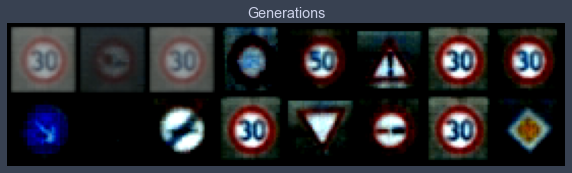

Epoch 31 loss 1.3185712906093532, test L1 = 0.7059098407626152
Epoch 32 loss 1.019279508656243, test L1 = 0.7082987911999226
Epoch 33 loss 1.1203580443392094, test L1 = 0.7030163519084454
Epoch 34 loss 0.9550456806146812, test L1 = 0.7148626819252968


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 0.8918822147592237, test L1 = 0.6931155435740948
test_fixed_labels=tensor([ 1, 10,  1, 15,  2, 18,  1,  1, 38, 20, 41,  1, 13,  9,  1, 12],
       device='cuda:0')


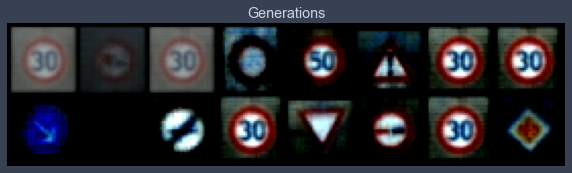

Epoch 36 loss 0.8493721685868358, test L1 = 0.6955463886260986
Epoch 37 loss 1.1743530205025297, test L1 = 0.7060888968408108
Epoch 38 loss 0.910276243367146, test L1 = 0.7017850242555141
Epoch 39 loss 0.8828776999027869, test L1 = 0.713329616934061


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 0.8361149532688442, test L1 = 0.697772741317749
test_fixed_labels=tensor([ 1, 10,  1, 15,  2, 18,  1,  1, 38, 20, 41,  1, 13,  9,  1, 12],
       device='cuda:0')


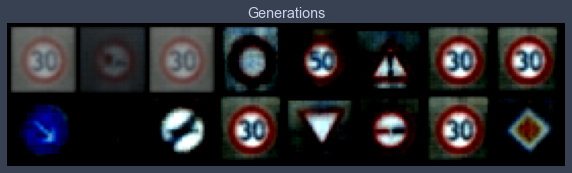

Epoch 41 loss 0.8475244205022595, test L1 = 0.707149613648653
Epoch 42 loss 0.8603440760746854, test L1 = 0.6979294680058956
Epoch 43 loss 0.8754997038349663, test L1 = 0.7045203670859337
Epoch 44 loss 0.9294498915115172, test L1 = 0.7017246559262276


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 0.8375691699817828, test L1 = 0.7066969275474548
test_fixed_labels=tensor([ 1, 10,  1, 15,  2, 18,  1,  1, 38, 20, 41,  1, 13,  9,  1, 12],
       device='cuda:0')


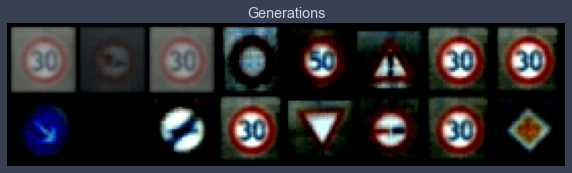

Epoch 46 loss 0.8373379457447537, test L1 = 0.7022482305765152
Epoch 47 loss 0.8344590307511005, test L1 = 0.7040161490440369
Epoch 48 loss 1.2032680757266958, test L1 = 0.7108513750135899
Epoch 49 loss 2.8307368702085567, test L1 = 0.7054400518536568






~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=64 | LR=0.1
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 3517271877809.0283, test L1 = 0.7640644237399101
test_fixed_labels=tensor([26, 18, 25, 35,  1, 12,  2, 10, 23, 10, 37, 31, 11, 26, 25, 34],
       device='cuda:0')


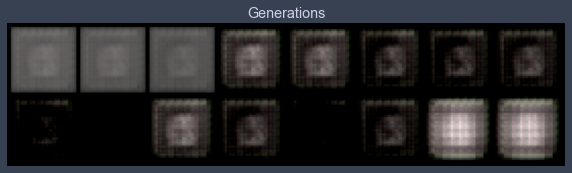

Epoch 1 loss 161293.35422036084, test L1 = 0.7154260352253914
Epoch 2 loss 250082.7337306701, test L1 = 0.7480734884738922
Epoch 3 loss 48596.34875698024, test L1 = 0.7262202575802803
Epoch 4 loss 52609.00796015893, test L1 = 0.7055590823292732


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 47951.72544834622, test L1 = 0.7266178727149963
test_fixed_labels=tensor([26, 18, 25, 35,  1, 12,  2, 10, 23, 10, 37, 31, 11, 26, 25, 34],
       device='cuda:0')


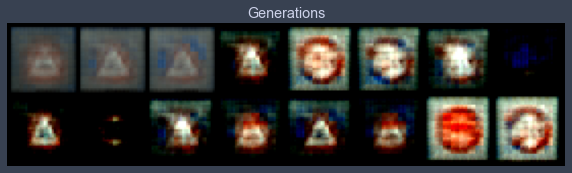

Epoch 6 loss 42910.882987006014, test L1 = 0.7083347849547863
Epoch 7 loss 67677.27123603952, test L1 = 0.7073875404894352
Epoch 8 loss 61826.03764631658, test L1 = 0.7045390568673611
Epoch 9 loss 31002.239871939433, test L1 = 0.724658340215683


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 23098.189681325173, test L1 = 0.7179069854319096
test_fixed_labels=tensor([26, 18, 25, 35,  1, 12,  2, 10, 23, 10, 37, 31, 11, 26, 25, 34],
       device='cuda:0')


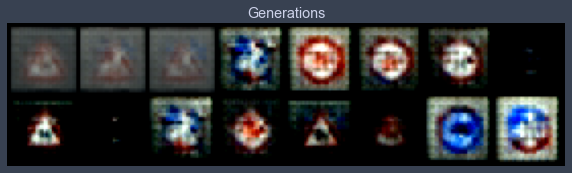

Epoch 11 loss 19520.843300311426, test L1 = 0.6978533938527107
Epoch 12 loss 17060.549230831184, test L1 = 0.6994744725525379
Epoch 13 loss 531463.6457158774, test L1 = 0.6978114917874336
Epoch 14 loss 72491.65260550902, test L1 = 0.6910122334957123


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 105486.21654182774, test L1 = 0.7221440486609936
test_fixed_labels=tensor([26, 18, 25, 35,  1, 12,  2, 10, 23, 10, 37, 31, 11, 26, 25, 34],
       device='cuda:0')


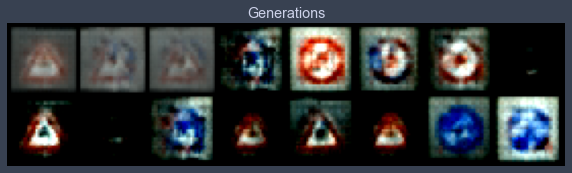

Epoch 16 loss 7988.144623536834, test L1 = 0.7349919378757477
Epoch 17 loss 5863.367169042634, test L1 = 0.7144787050783634
Epoch 18 loss 4768.390641779424, test L1 = 0.6887166276574135
Epoch 19 loss 3946.1297007557455, test L1 = 0.7062502801418304


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 24131.188145168868, test L1 = 0.754906389862299
test_fixed_labels=tensor([26, 18, 25, 35,  1, 12,  2, 10, 23, 10, 37, 31, 11, 26, 25, 34],
       device='cuda:0')


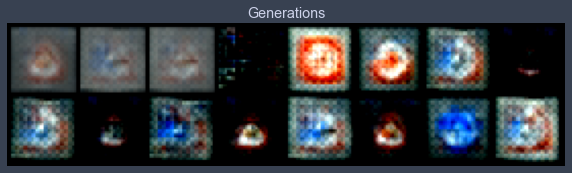

Epoch 21 loss 2955.423806311748, test L1 = 0.7165794521570206
Epoch 22 loss 2675.8502360865014, test L1 = 0.7151097916066647
Epoch 23 loss 2492.0334187406033, test L1 = 0.712376244366169
Epoch 24 loss 2372.7962810083764, test L1 = 0.7128645069897175


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 2295.45505043895, test L1 = 0.7270231507718563
test_fixed_labels=tensor([26, 18, 25, 35,  1, 12,  2, 10, 23, 10, 37, 31, 11, 26, 25, 34],
       device='cuda:0')


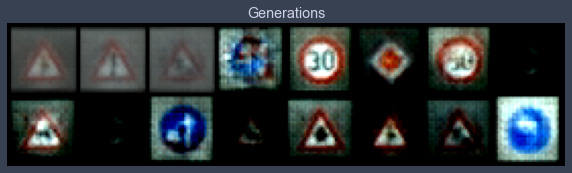

Epoch 26 loss 2244.4286471756873, test L1 = 0.7230629697442055
Epoch 27 loss 2209.8333794767505, test L1 = 0.7155167758464813
Epoch 28 loss 2185.7870305117053, test L1 = 0.7162837348878384
Epoch 29 loss 2168.8856347991837, test L1 = 0.7131180092692375


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 2157.0571918290916, test L1 = 0.6969340890645981
test_fixed_labels=tensor([26, 18, 25, 35,  1, 12,  2, 10, 23, 10, 37, 31, 11, 26, 25, 34],
       device='cuda:0')


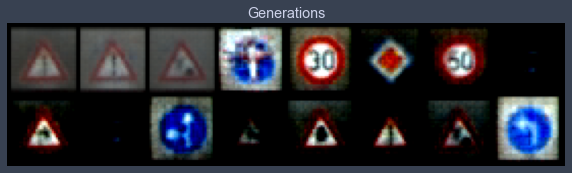

Epoch 31 loss 2148.9434969662802, test L1 = 0.7308995351195335
Epoch 32 loss 2143.547302036351, test L1 = 0.727958045899868
Epoch 33 loss 2140.0908026941042, test L1 = 0.7001443803310394
Epoch 34 loss 2137.9895422237437, test L1 = 0.6897152103483677


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 2136.7821485381764, test L1 = 0.7070373110473156
test_fixed_labels=tensor([26, 18, 25, 35,  1, 12,  2, 10, 23, 10, 37, 31, 11, 26, 25, 34],
       device='cuda:0')


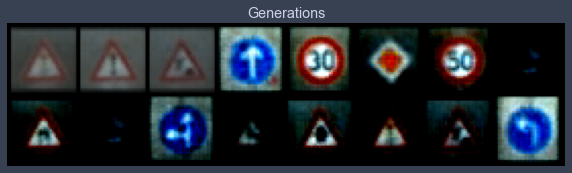

Epoch 36 loss 2136.136165028995, test L1 = 0.7019809074699879
Epoch 37 loss 2135.820511336179, test L1 = 0.6843851841986179
Epoch 38 loss 2135.680403981422, test L1 = 0.6988316215574741
Epoch 39 loss 2135.6228505557347, test L1 = 0.695604357868433


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 2135.602982039304, test L1 = 0.7148954682052135
test_fixed_labels=tensor([26, 18, 25, 35,  1, 12,  2, 10, 23, 10, 37, 31, 11, 26, 25, 34],
       device='cuda:0')


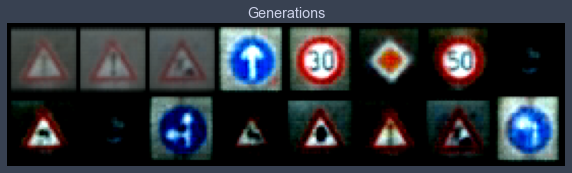

Epoch 41 loss 2135.5943582541345, test L1 = 0.7038416638970375
Epoch 42 loss 2135.592791894867, test L1 = 0.7095077745616436
Epoch 43 loss 2135.5930159001828, test L1 = 0.6884922683238983
Epoch 44 loss 2135.593333870275, test L1 = 0.7231250368058681


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 2135.5924923821412, test L1 = 0.7088732272386551
test_fixed_labels=tensor([26, 18, 25, 35,  1, 12,  2, 10, 23, 10, 37, 31, 11, 26, 25, 34],
       device='cuda:0')


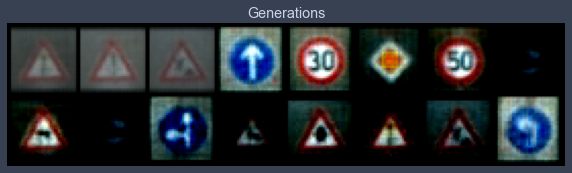

Epoch 46 loss 2135.5936484844824, test L1 = 0.7101679891347885
Epoch 47 loss 2135.591972219985, test L1 = 0.7299578748643398
Epoch 48 loss 2135.591785968374, test L1 = 0.6945413686335087
Epoch 49 loss 2135.5931610422035, test L1 = 0.6937828995287418






~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=32 | LR=0.0001
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 6.036152553722212, test L1 = 0.7910605892539024
test_fixed_labels=tensor([34,  3,  8, 10,  9, 25,  8,  1, 24,  2,  1,  4, 33, 23,  7, 24],
       device='cuda:0')


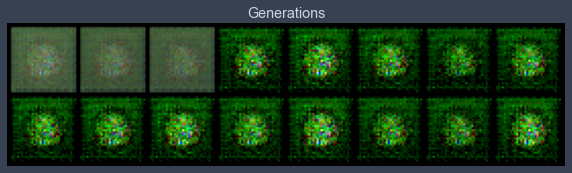

Epoch 1 loss 1.3517292270955352, test L1 = 0.7647545486688614
Epoch 2 loss 1.118926860417697, test L1 = 0.7433316931128502
Epoch 3 loss 1.0230310284804642, test L1 = 0.7341159507632256
Epoch 4 loss 0.9721898112919732, test L1 = 0.7360177002847195


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 0.9500900857227365, test L1 = 0.7302553430199623
test_fixed_labels=tensor([34,  3,  8, 10,  9, 25,  8,  1, 24,  2,  1,  4, 33, 23,  7, 24],
       device='cuda:0')


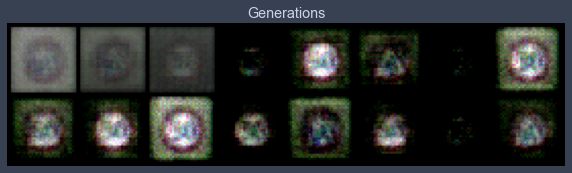

Epoch 6 loss 0.9260269833594253, test L1 = 0.7328675612807274
Epoch 7 loss 0.915488405530805, test L1 = 0.7246165424585342
Epoch 8 loss 0.9018015070879173, test L1 = 0.7271957956254482
Epoch 9 loss 0.8981259735589174, test L1 = 0.7269095815718174


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 0.8909043864286232, test L1 = 0.7273425795137882
test_fixed_labels=tensor([34,  3,  8, 10,  9, 25,  8,  1, 24,  2,  1,  4, 33, 23,  7, 24],
       device='cuda:0')


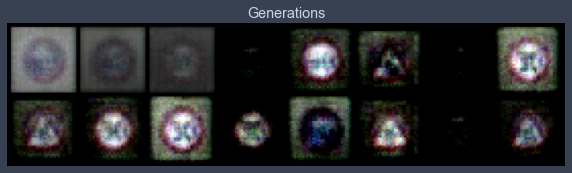

Epoch 11 loss 0.884124180705277, test L1 = 0.720201876014471
Epoch 12 loss 0.8769622129672991, test L1 = 0.7181777991354465
Epoch 13 loss 0.8699696780889714, test L1 = 0.7193985283374786
Epoch 14 loss 0.8621840337707415, test L1 = 0.719424057751894


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 0.8603451845981821, test L1 = 0.7210697457194328
test_fixed_labels=tensor([34,  3,  8, 10,  9, 25,  8,  1, 24,  2,  1,  4, 33, 23,  7, 24],
       device='cuda:0')


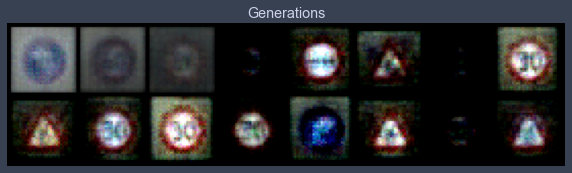

Epoch 16 loss 0.85371679047129, test L1 = 0.7188862264156342
Epoch 17 loss 0.8523930513981691, test L1 = 0.7175133712589741
Epoch 18 loss 0.8492844883109286, test L1 = 0.7138994112610817
Epoch 19 loss 0.8472721554159709, test L1 = 0.7147290855646133


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 0.8459452312836533, test L1 = 0.7125369869172573
test_fixed_labels=tensor([34,  3,  8, 10,  9, 25,  8,  1, 24,  2,  1,  4, 33, 23,  7, 24],
       device='cuda:0')


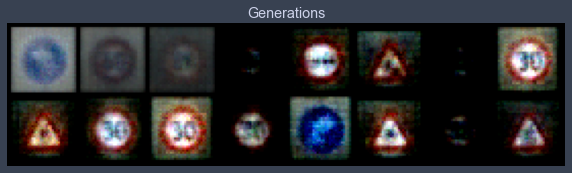

Epoch 21 loss 0.8451572449756242, test L1 = 0.7144556231796741
Epoch 22 loss 0.8440665668228647, test L1 = 0.7119051478803158
Epoch 23 loss 0.8435869223063754, test L1 = 0.7121116369962692
Epoch 24 loss 0.8424292778231434, test L1 = 0.7108110375702381


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 0.8414794276260429, test L1 = 0.7128642573952675
test_fixed_labels=tensor([34,  3,  8, 10,  9, 25,  8,  1, 24,  2,  1,  4, 33, 23,  7, 24],
       device='cuda:0')


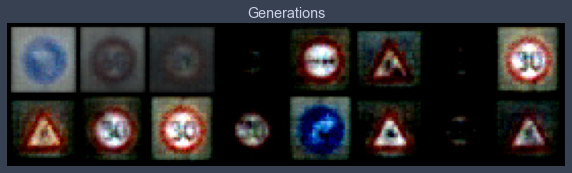

Epoch 26 loss 0.8420057806772056, test L1 = 0.7110812664031982
Epoch 27 loss 0.8406348539791566, test L1 = 0.7104429565370083
Epoch 28 loss 0.8403911707327538, test L1 = 0.7123517207801342
Epoch 29 loss 0.8401795781355134, test L1 = 0.7089340575039387


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 0.8397869396045855, test L1 = 0.7082643248140812
test_fixed_labels=tensor([34,  3,  8, 10,  9, 25,  8,  1, 24,  2,  1,  4, 33, 23,  7, 24],
       device='cuda:0')


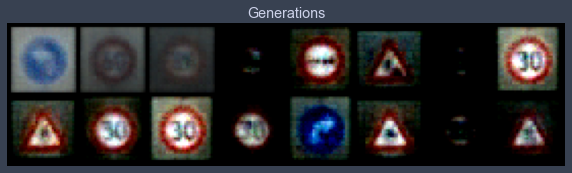

Epoch 31 loss 0.8393113352998426, test L1 = 0.7088082209229469
Epoch 32 loss 0.8388538221313372, test L1 = 0.7105820924043655
Epoch 33 loss 0.8390555424788564, test L1 = 0.7140857465565205
Epoch 34 loss 0.8387195654341445, test L1 = 0.7138015255331993


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 0.8382651265134516, test L1 = 0.7117216475307941
test_fixed_labels=tensor([34,  3,  8, 10,  9, 25,  8,  1, 24,  2,  1,  4, 33, 23,  7, 24],
       device='cuda:0')


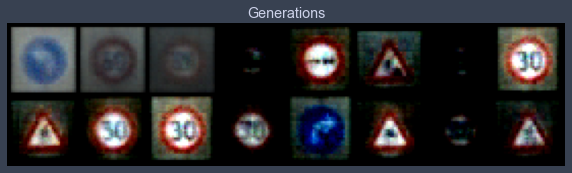

Epoch 36 loss 0.8382491022860471, test L1 = 0.7095991708338261
Epoch 37 loss 0.8380376182470944, test L1 = 0.7088002264499664
Epoch 38 loss 0.8376890687188742, test L1 = 0.7072815038263798
Epoch 39 loss 0.8374465216476074, test L1 = 0.7120210863649845


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 0.8369392121780369, test L1 = 0.7087890990078449
test_fixed_labels=tensor([34,  3,  8, 10,  9, 25,  8,  1, 24,  2,  1,  4, 33, 23,  7, 24],
       device='cuda:0')


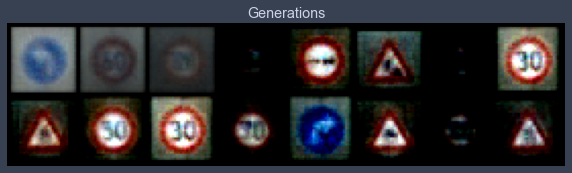

Epoch 41 loss 0.8370142808484867, test L1 = 0.7088179960846901
Epoch 42 loss 0.8365919346252257, test L1 = 0.7120981588959694
Epoch 43 loss 0.8367466123653031, test L1 = 0.7088504582643509
Epoch 44 loss 0.8365795362446317, test L1 = 0.7075898014008999


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 0.8364518561314062, test L1 = 0.7087485641241074
test_fixed_labels=tensor([34,  3,  8, 10,  9, 25,  8,  1, 24,  2,  1,  4, 33, 23,  7, 24],
       device='cuda:0')


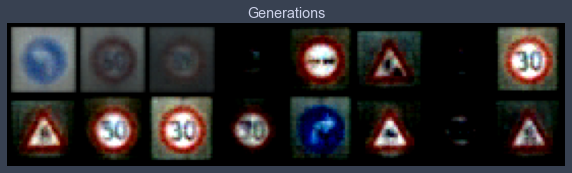

Epoch 46 loss 0.8363208266877636, test L1 = 0.706449382007122
Epoch 47 loss 0.8357028912023171, test L1 = 0.7075834609568119
Epoch 48 loss 0.8359317464107501, test L1 = 0.707880686968565
Epoch 49 loss 0.8357181555217075, test L1 = 0.709609866142273






~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=32 | LR=0.001
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 37.89101720962328, test L1 = 0.7398176193237305
test_fixed_labels=tensor([ 9, 33,  8, 42, 31, 11, 17, 25, 26, 25,  1, 13,  1, 18, 14,  3],
       device='cuda:0')


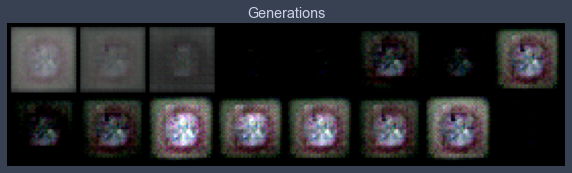

Epoch 1 loss 0.9200976804359672, test L1 = 0.7279982790350914
Epoch 2 loss 0.8638438185056051, test L1 = 0.7142255008220673
Epoch 3 loss 0.8498997073812583, test L1 = 0.7218344956636429
Epoch 4 loss 0.8450875032398709, test L1 = 0.709919910877943


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 0.8417734204698674, test L1 = 0.7119765877723694
test_fixed_labels=tensor([ 9, 33,  8, 42, 31, 11, 17, 25, 26, 25,  1, 13,  1, 18, 14,  3],
       device='cuda:0')


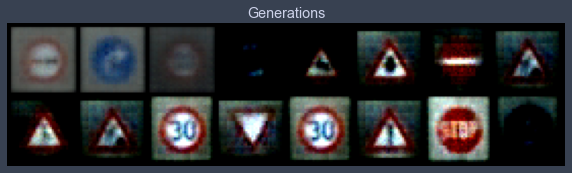

Epoch 6 loss 0.8406706782141092, test L1 = 0.7102015763521194
Epoch 7 loss 0.8388407193508345, test L1 = 0.7087620198726654
Epoch 8 loss 0.8371340497252867, test L1 = 0.7070538550615311
Epoch 9 loss 0.8368177723229137, test L1 = 0.7113274820148945


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 0.8363455966166204, test L1 = 0.7066546157002449
test_fixed_labels=tensor([ 9, 33,  8, 42, 31, 11, 17, 25, 26, 25,  1, 13,  1, 18, 14,  3],
       device='cuda:0')


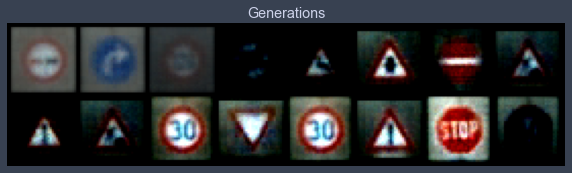

Epoch 11 loss 0.8357389765916411, test L1 = 0.7087828516960144
Epoch 12 loss 0.8355710477763435, test L1 = 0.7099748589098454
Epoch 13 loss 0.8343873990770058, test L1 = 0.7077914513647556
Epoch 14 loss 0.8343743112488711, test L1 = 0.7097575701773167


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 0.8336914843300364, test L1 = 0.7095240689814091
test_fixed_labels=tensor([ 9, 33,  8, 42, 31, 11, 17, 25, 26, 25,  1, 13,  1, 18, 14,  3],
       device='cuda:0')


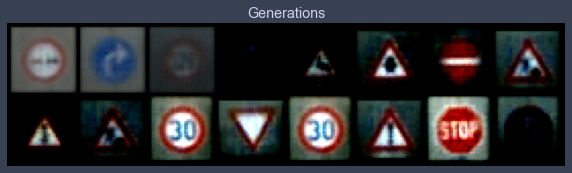

Epoch 16 loss 0.833611854572886, test L1 = 0.7093937546014786
Epoch 17 loss 0.83313333967707, test L1 = 0.709530308842659
Epoch 18 loss 0.8334439122390092, test L1 = 0.7095378898084164
Epoch 19 loss 0.8332148317209224, test L1 = 0.709284283220768


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 0.8334713684734201, test L1 = 0.706192210316658
test_fixed_labels=tensor([ 9, 33,  8, 42, 31, 11, 17, 25, 26, 25,  1, 13,  1, 18, 14,  3],
       device='cuda:0')


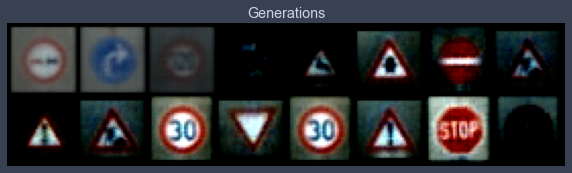

Epoch 21 loss 0.8324897490006542, test L1 = 0.702356606721878
Epoch 22 loss 0.8329421158918401, test L1 = 0.7064968794584274
Epoch 23 loss 0.8324533412136983, test L1 = 0.7035484984517097
Epoch 24 loss 0.8317626202639026, test L1 = 0.7050815522670746


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 0.8321130882014114, test L1 = 0.707329984754324
test_fixed_labels=tensor([ 9, 33,  8, 42, 31, 11, 17, 25, 26, 25,  1, 13,  1, 18, 14,  3],
       device='cuda:0')


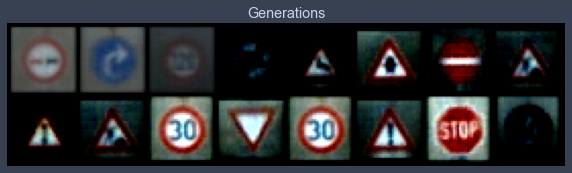

Epoch 26 loss 0.8320297770893451, test L1 = 0.7054347731173038
Epoch 27 loss 0.831990669068602, test L1 = 0.7073797471821308
Epoch 28 loss 0.8321116009528694, test L1 = 0.7049433812499046
Epoch 29 loss 0.8315098994376323, test L1 = 0.7076107859611511


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 0.8316405792416576, test L1 = 0.7036373764276505
test_fixed_labels=tensor([ 9, 33,  8, 42, 31, 11, 17, 25, 26, 25,  1, 13,  1, 18, 14,  3],
       device='cuda:0')


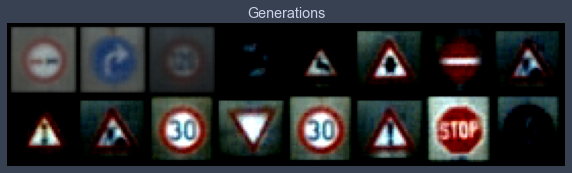

Epoch 31 loss 0.8316579465194256, test L1 = 0.7060787379741669
Epoch 32 loss 0.831543344197814, test L1 = 0.7066036984324455
Epoch 33 loss 0.8310910934435133, test L1 = 0.7037644311785698
Epoch 34 loss 0.8316323093532287, test L1 = 0.7054446898400784


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 0.8308758928194079, test L1 = 0.7076643370091915
test_fixed_labels=tensor([ 9, 33,  8, 42, 31, 11, 17, 25, 26, 25,  1, 13,  1, 18, 14,  3],
       device='cuda:0')


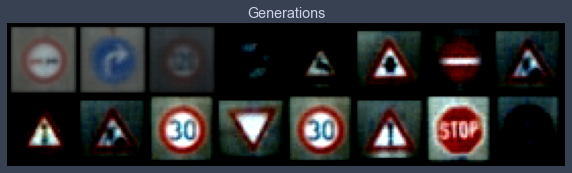

Epoch 36 loss 0.8312261760030005, test L1 = 0.7067012451589108
Epoch 37 loss 12343.15989876756, test L1 = 0.7064149081707001
Epoch 38 loss 24711.58780536373, test L1 = 0.7079008296132088
Epoch 39 loss 25.099620631879958, test L1 = 0.7088330648839474


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 15.823552004864945, test L1 = 0.7077854871749878
test_fixed_labels=tensor([ 9, 33,  8, 42, 31, 11, 17, 25, 26, 25,  1, 13,  1, 18, 14,  3],
       device='cuda:0')


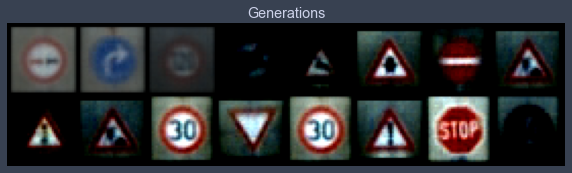

Epoch 41 loss 3.870451256171944, test L1 = 0.7073281183838844
Epoch 42 loss 3.190186043990027, test L1 = 0.7073975205421448
Epoch 43 loss 2.8849173710518277, test L1 = 0.7047216296195984
Epoch 44 loss 2.533974367113867, test L1 = 0.7063468880951405


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 1.8970877470839065, test L1 = 0.7030197232961655
test_fixed_labels=tensor([ 9, 33,  8, 42, 31, 11, 17, 25, 26, 25,  1, 13,  1, 18, 14,  3],
       device='cuda:0')


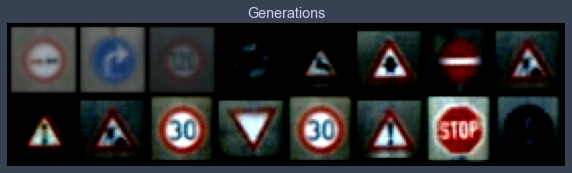

Epoch 46 loss 1.5892294495785768, test L1 = 0.7101809568703175
Epoch 47 loss 1.519590399109621, test L1 = 0.7002718783915043
Epoch 48 loss 1.4307186550291133, test L1 = 0.7030093669891357
Epoch 49 loss 1.2314580097231258, test L1 = 0.7076011672616005






~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=32 | LR=0.01
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 5568816.921905518, test L1 = 0.7410855405032635
test_fixed_labels=tensor([26,  5, 38, 24, 10, 31, 13,  9, 11,  6, 11,  9, 11,  7,  6,  8],
       device='cuda:0')


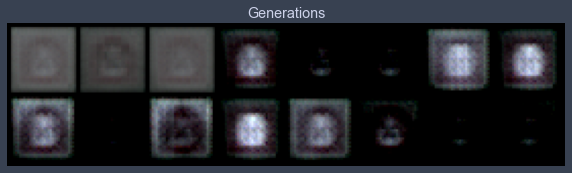

Epoch 1 loss 1216.983813885561, test L1 = 0.7270542979240417
Epoch 2 loss 350.29417891354905, test L1 = 0.7109444178640842
Epoch 3 loss 230.07678840086632, test L1 = 0.7118751145899296
Epoch 4 loss 135.27180931248617, test L1 = 0.720895491540432


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 228.69507314413275, test L1 = 0.7101407498121262
test_fixed_labels=tensor([26,  5, 38, 24, 10, 31, 13,  9, 11,  6, 11,  9, 11,  7,  6,  8],
       device='cuda:0')


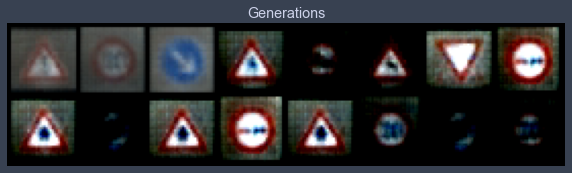

Epoch 6 loss 151.35419501144042, test L1 = 0.7044541761279106
Epoch 7 loss 117.54201166900162, test L1 = 0.7101322300732136
Epoch 8 loss 33.94041819752697, test L1 = 0.7073040455579758
Epoch 9 loss 28.615755438394974, test L1 = 0.708955742418766


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 45.73571946571783, test L1 = 0.7074580229818821
test_fixed_labels=tensor([26,  5, 38, 24, 10, 31, 13,  9, 11,  6, 11,  9, 11,  7,  6,  8],
       device='cuda:0')


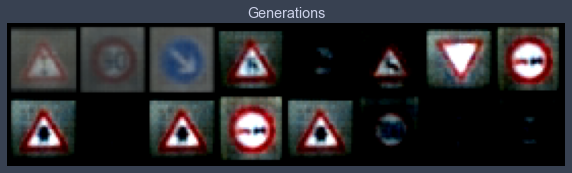

Epoch 11 loss 41.958860563248706, test L1 = 0.7115425877273083
Epoch 12 loss 28.036663810821743, test L1 = 0.7079045809805393
Epoch 13 loss 21.070560027438752, test L1 = 0.7103449702262878
Epoch 14 loss 12.865591339638963, test L1 = 0.7028867416083813


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 8.032120399458712, test L1 = 0.7087664417922497
test_fixed_labels=tensor([26,  5, 38, 24, 10, 31, 13,  9, 11,  6, 11,  9, 11,  7,  6,  8],
       device='cuda:0')


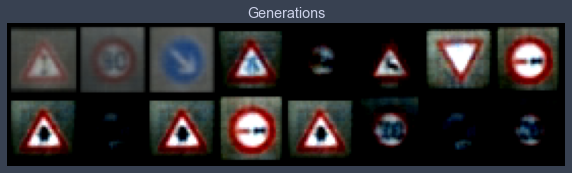

Epoch 16 loss 7.879890898044167, test L1 = 0.6971403881907463
Epoch 17 loss 6.979547944880023, test L1 = 0.7028532885015011
Epoch 18 loss 10.053862310152283, test L1 = 0.7029926851391792
Epoch 19 loss 6.026251827113817, test L1 = 0.7088248506188393


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 4.484399718107636, test L1 = 0.7070547118782997
test_fixed_labels=tensor([26,  5, 38, 24, 10, 31, 13,  9, 11,  6, 11,  9, 11,  7,  6,  8],
       device='cuda:0')


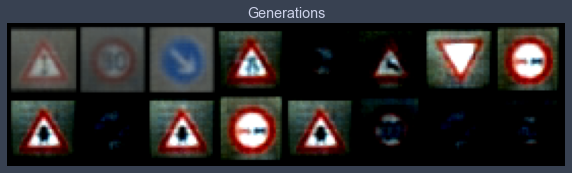

Epoch 21 loss 5.714759424789665, test L1 = 0.7039618827402592
Epoch 22 loss 9.460071567612415, test L1 = 0.6989915370941162
Epoch 23 loss 3.3136035441532985, test L1 = 0.6983993388712406
Epoch 24 loss 2.452687041866001, test L1 = 0.7115920670330524


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 2.1845529657049276, test L1 = 0.7007431909441948
test_fixed_labels=tensor([26,  5, 38, 24, 10, 31, 13,  9, 11,  6, 11,  9, 11,  7,  6,  8],
       device='cuda:0')


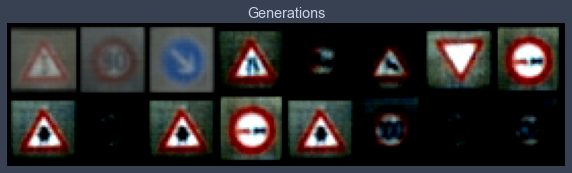

Epoch 26 loss 1.9760734649867946, test L1 = 0.7080620788037777
Epoch 27 loss 1.5589358024171127, test L1 = 0.7028602622449398
Epoch 28 loss 1.6309549902722598, test L1 = 0.7071909457445145
Epoch 29 loss 2.4667843615066554, test L1 = 0.7092447057366371


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 2.363363128142668, test L1 = 0.6985748559236526
test_fixed_labels=tensor([26,  5, 38, 24, 10, 31, 13,  9, 11,  6, 11,  9, 11,  7,  6,  8],
       device='cuda:0')


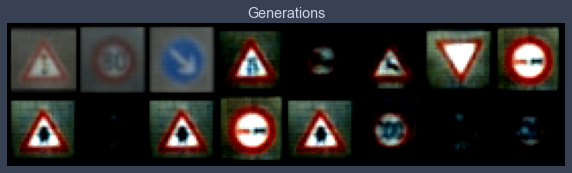

Epoch 31 loss 8.05177365996174, test L1 = 0.712605319917202
Epoch 32 loss 2.148905180369046, test L1 = 0.708572268486023
Epoch 33 loss 1.0713796750786377, test L1 = 0.7025074698030949
Epoch 34 loss 1.0408167963994737, test L1 = 0.7053310759365559


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 1.3634213565551128, test L1 = 0.7009860239923
test_fixed_labels=tensor([26,  5, 38, 24, 10, 31, 13,  9, 11,  6, 11,  9, 11,  7,  6,  8],
       device='cuda:0')


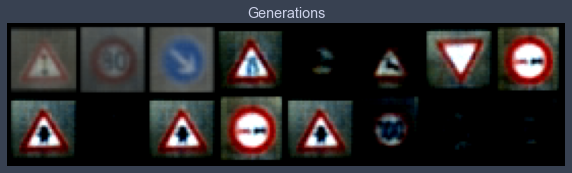

Epoch 36 loss 0.8772596714832529, test L1 = 0.7104115374386311
Epoch 37 loss 0.8693008478154841, test L1 = 0.6973715759813786
Epoch 38 loss 0.8734051400853187, test L1 = 0.7071052826941013
Epoch 39 loss 0.8471895687768549, test L1 = 0.6904294490814209


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 0.8838063990537244, test L1 = 0.701799675822258
test_fixed_labels=tensor([26,  5, 38, 24, 10, 31, 13,  9, 11,  6, 11,  9, 11,  7,  6,  8],
       device='cuda:0')


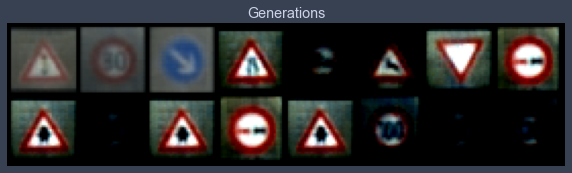

Epoch 41 loss 0.9062610276785913, test L1 = 0.7076451368629932
Epoch 42 loss 0.8645181006582332, test L1 = 0.7146211713552475
Epoch 43 loss 0.8807102560587355, test L1 = 0.7022496573626995
Epoch 44 loss 0.8498236502159092, test L1 = 0.7069347351789474


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 246471239.63786227, test L1 = 0.7440995797514915
test_fixed_labels=tensor([26,  5, 38, 24, 10, 31, 13,  9, 11,  6, 11,  9, 11,  7,  6,  8],
       device='cuda:0')


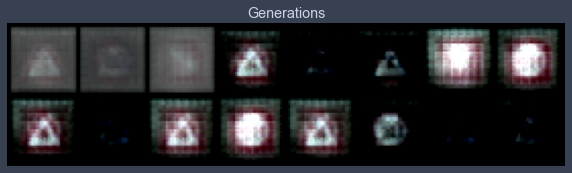

Epoch 46 loss 11353.992672110751, test L1 = 0.7056062296032906
Epoch 47 loss 1107.5531375531068, test L1 = 0.7022393383085728
Epoch 48 loss 183.27673771127394, test L1 = 0.6947513781487942
Epoch 49 loss 100.74976436706753, test L1 = 0.7017454206943512






~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=32 | LR=0.1
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 4356036996436.4087, test L1 = 0.7308325357735157
test_fixed_labels=tensor([35,  8, 41,  1, 34, 12, 33, 17,  7,  4, 23, 36, 37, 14, 24, 12],
       device='cuda:0')


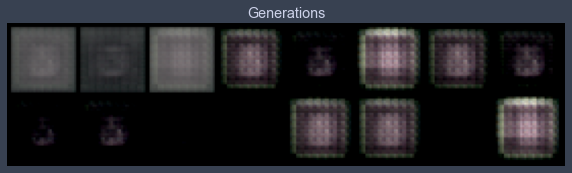

Epoch 1 loss 471795.29435137456, test L1 = 0.7456509210169315
Epoch 2 loss 767769.0432774915, test L1 = 0.7225657477974892
Epoch 3 loss 170861.66076030929, test L1 = 0.7745706588029861
Epoch 4 loss 196058.11920103093, test L1 = 0.7376052439212799


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 5 loss 109524.95304445876, test L1 = 0.7230164110660553
test_fixed_labels=tensor([35,  8, 41,  1, 34, 12, 33, 17,  7,  4, 23, 36, 37, 14, 24, 12],
       device='cuda:0')


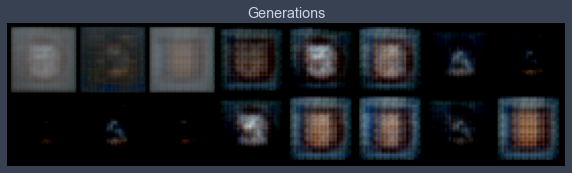

Epoch 6 loss 294514.7181727878, test L1 = 0.7491964884102345
Epoch 7 loss 56339.172767665375, test L1 = 0.7200069762766361
Epoch 8 loss 252557.45970253437, test L1 = 0.7262831851840019
Epoch 9 loss 53865.28029021693, test L1 = 0.7611942812800407


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 81031.18597475032, test L1 = 0.7561305239796638
test_fixed_labels=tensor([35,  8, 41,  1, 34, 12, 33, 17,  7,  4, 23, 36, 37, 14, 24, 12],
       device='cuda:0')


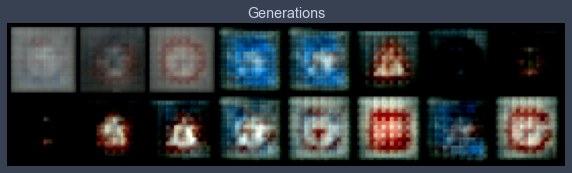

Epoch 11 loss 12569.762129845898, test L1 = 0.7235879339277744
Epoch 12 loss 4974.698231280874, test L1 = 0.744561180472374
Epoch 13 loss 2832.8970171217247, test L1 = 0.7542890049517155
Epoch 14 loss 3056.2894471683044, test L1 = 0.7111211344599724


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 1594.9932152397444, test L1 = 0.7508861310780048
test_fixed_labels=tensor([35,  8, 41,  1, 34, 12, 33, 17,  7,  4, 23, 36, 37, 14, 24, 12],
       device='cuda:0')


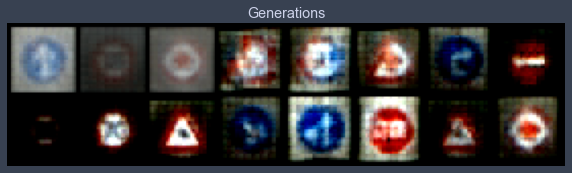

Epoch 16 loss 2828.2160908807186, test L1 = 0.7103181518614292
Epoch 17 loss 1910.092392544566, test L1 = 0.7135250940918922
Epoch 18 loss 8843.410313976588, test L1 = 0.7173689939081669
Epoch 19 loss 1373.4537919821198, test L1 = 0.7269948609173298


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 2540.4920713024862, test L1 = 0.7377876341342926
test_fixed_labels=tensor([35,  8, 41,  1, 34, 12, 33, 17,  7,  4, 23, 36, 37, 14, 24, 12],
       device='cuda:0')


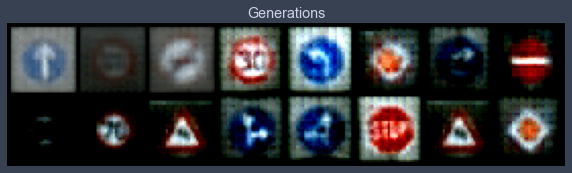

Epoch 21 loss 9125.831731317789, test L1 = 0.7046933993697166
Epoch 22 loss 1466.289085152223, test L1 = 0.6839904114603996
Epoch 23 loss 1209.6864722602556, test L1 = 0.7032054327428341
Epoch 24 loss 1164.5396590085375, test L1 = 0.7342609018087387


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 1175.8805816755262, test L1 = 0.7475605607032776
test_fixed_labels=tensor([35,  8, 41,  1, 34, 12, 33, 17,  7,  4, 23, 36, 37, 14, 24, 12],
       device='cuda:0')


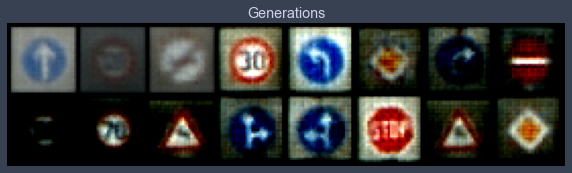

Epoch 26 loss 1147.563409864288, test L1 = 0.7178885638713837
Epoch 27 loss 1785.2434564439702, test L1 = 0.6994106844067574
Epoch 28 loss 1134.940702772632, test L1 = 0.7640525698661804
Epoch 29 loss 1167.7449330333172, test L1 = 0.7114822529256344


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 1130.452856109724, test L1 = 0.7058115303516388
test_fixed_labels=tensor([35,  8, 41,  1, 34, 12, 33, 17,  7,  4, 23, 36, 37, 14, 24, 12],
       device='cuda:0')


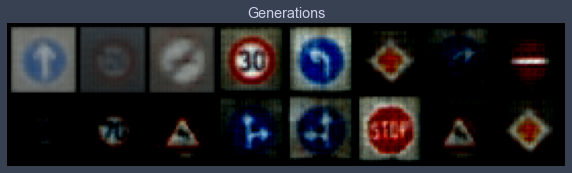

Epoch 31 loss 18129.38926251074, test L1 = 0.711065273731947
Epoch 32 loss 1105.3079632631282, test L1 = 0.7624259144067764
Epoch 33 loss 1099.6889006624517, test L1 = 0.7096771262586117
Epoch 34 loss 1093.1171732374892, test L1 = 0.7183304205536842


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 1091.1905953843159, test L1 = 0.7095952220261097
test_fixed_labels=tensor([35,  8, 41,  1, 34, 12, 33, 17,  7,  4, 23, 36, 37, 14, 24, 12],
       device='cuda:0')


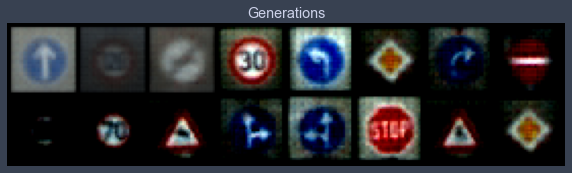

Epoch 36 loss 1091.5167362173809, test L1 = 0.7014697380363941
Epoch 37 loss 1220.8256441621027, test L1 = 0.7036921866238117
Epoch 38 loss 1097.0271000288606, test L1 = 0.7015049569308758
Epoch 39 loss 1094.7975952567924, test L1 = 0.7100891657173634


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 1090.6634991308258, test L1 = 0.6990986764431
test_fixed_labels=tensor([35,  8, 41,  1, 34, 12, 33, 17,  7,  4, 23, 36, 37, 14, 24, 12],
       device='cuda:0')


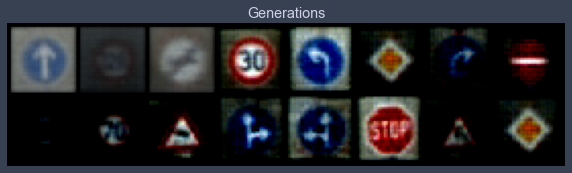

Epoch 41 loss 1090.685324128141, test L1 = 0.6939284019172192
Epoch 42 loss 1090.7617418217085, test L1 = 0.692073218524456
Epoch 43 loss 1105.4181986281142, test L1 = 0.6957239471375942
Epoch 44 loss 1090.978146897149, test L1 = 0.7173075824975967


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 1095.0483415216925, test L1 = 0.7032399587333202
test_fixed_labels=tensor([35,  8, 41,  1, 34, 12, 33, 17,  7,  4, 23, 36, 37, 14, 24, 12],
       device='cuda:0')


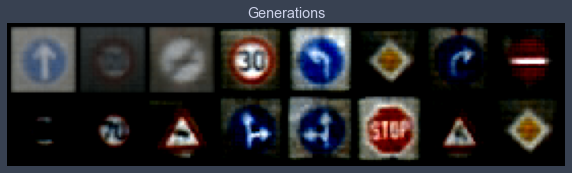

Epoch 46 loss 1090.638900075172, test L1 = 0.6992566920816898
Epoch 47 loss 1090.6398355280821, test L1 = 0.7061494737863541
Epoch 48 loss 1091.2134602864583, test L1 = 0.7026212960481644
Epoch 49 loss 1090.9108081306379, test L1 = 0.7096416801214218








In [24]:
N_OF_CLASSESS = numb_classess

val_models = []
for val_latent_size, val_lr in h_params:
    val_signs_vae = SignsVAE(latent_dim=val_latent_size, classess_size=N_OF_CLASSESS).to(device)
    val_optimizer = optim.Adam(val_signs_vae.parameters(), lr=val_lr)
    val_scheduler = optim.lr_scheduler.ExponentialLR(optimizer=val_optimizer, gamma=0.99)
    val_fixed_noise = torch.randn(16, val_latent_size, device=device)
    val_fixed_labels = next(iter(train_loader))[1]
    val_fixed_labels = val_fixed_labels[:16].to(device)
    val_fixed_labels_one_hot = Functional.one_hot(val_fixed_labels, N_OF_CLASSESS).float()
    print("~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~")
    print(f"LATENT SIZE={val_latent_size} | LR={val_lr}")
    print("~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~")

    perform_vae_training_val(vae_model=val_signs_vae, vae_optimizer=val_optimizer, vae_train_loader=train_loader, vae_valid_loader=valid_loader, vae_scheduler=val_scheduler, test_fixed_noise=val_fixed_noise, test_fixed_labels_one_hot=val_fixed_labels_one_hot, test_fixed_labels=val_fixed_labels)

    print("\n"*5)


    val_models.append(val_signs_vae)

In [29]:
tens_mean = torch.Tensor(mean_dataset)
tens_std = torch.Tensor(stdd_dataset)

In [30]:
denormalize = transforms.Normalize((-1*tens_mean/tens_std).tolist(), (1.0 / tens_std).tolist())

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


val_fixed_labels=tensor([26, 13,  3,  7, 11,  8, 31, 41, 31, 12,  5, 15, 11, 12, 38, 11,  4, 28,
        41, 17,  3, 12, 38, 15,  3, 12, 13,  5, 23,  3, 17, 24, 28,  9,  5, 33,
        13, 25, 14, 12,  1, 18, 17,  3, 26, 11,  4,  2, 25, 38, 39,  5, 23, 41,
        20,  5, 31,  2,  9, 17,  3, 14,  4, 19], device='cuda:0')


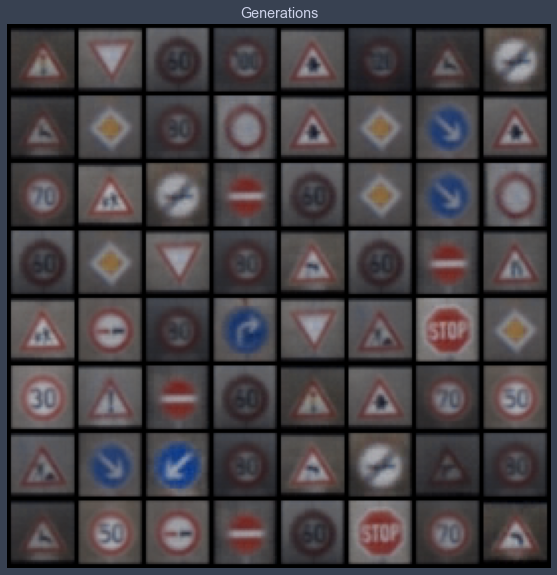

In [31]:
best_model = val_models[6]
val_latent_size = 64
val_fixed_noise = torch.randn(64, val_latent_size, device=device)
val_fixed_labels = next(iter(train_loader))[1]
val_fixed_labels = val_fixed_labels[:64].to(device)
val_fixed_labels_one_hot = Functional.one_hot(val_fixed_labels, N_OF_CLASSESS).float()
with torch.no_grad():
    print(f"{val_fixed_labels=}")
    fake_gens = best_model.decoder(val_fixed_noise, val_fixed_labels_one_hot).detach().cpu()
    fake_gens = denormalize(fake_gens)
    grid = torchvision.utils.make_grid(fake_gens)
    grid = grid.permute(1, 2, 0)
    plt.figure(figsize=(10,10))
    plt.title(f"Generations")
    plt.imshow(grid)
    plt.axis('off')
    plt.show()

In [32]:
state_dict = best_model.state_dict()
torch.save(state_dict, "models/do_wyslania_1.tar")

In [33]:
h_params = [(256, 0.0001), (256, 0.001), (256, 0.01), (256, 0.1), (512, 0.0001), (512, 0.001), (512, 0.01), (512, 0.1)]

In [34]:
BATCH_SIZE = 128
val_train_loader = torch.utils.data.DataLoader(train_subset, batch_size=BATCH_SIZE, shuffle=True)
val_valid_loader = torch.utils.data.DataLoader(valid_subset, batch_size=BATCH_SIZE, shuffle=True)

In [35]:
def perform_vae_training_val2(vae_model, vae_optimizer, vae_train_loader, vae_valid_loader, vae_scheduler,
                             test_fixed_noise, test_fixed_labels_one_hot, test_fixed_labels, num_epochs=50):
    for epoch in range(num_epochs):
        losses_epoch = []
        for x, y in iter(vae_train_loader):
            x = x.to(device)
            y = Functional.one_hot(y, numb_classess).to(device).float()
            out, means, log_var = vae_model(x, y)
            loss = vae_loss_function(x, out, means, log_var)
            losses_epoch.append(loss.item())
            loss.backward()
            vae_optimizer.step()
            vae_optimizer.zero_grad()
        L1_list = []
        with torch.no_grad():
            for x, y in iter(vae_valid_loader):
                x = x.to(device)
                y = Functional.one_hot(y, numb_classess).to(device).float()
                out, _, _ = vae_model(x, y)
                L1_list.append(torch.mean(torch.abs(out - x)).item())
            print(f"Epoch {epoch} loss {np.mean(np.array(losses_epoch))}, test L1 = {np.mean(L1_list)}")
            if epoch % 5 == 0:
                print(f"{test_fixed_labels=}")
                fake_gens = vae_model.decoder(test_fixed_noise, test_fixed_labels_one_hot).detach().cpu()
                fake_gens = denormalize(fake_gens)
                grid = torchvision.utils.make_grid(fake_gens)
                grid = grid.permute(1, 2, 0)
                plt.figure(figsize=(10, 10))
                plt.title(f"Generations")
                plt.imshow(grid)
                plt.axis('off')
                plt.show()

        vae_scheduler.step()


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=256 | LR=0.0001
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Epoch 0 loss 23.665429472513626, test L1 = 0.7622113898396492
test_fixed_labels=tensor([14, 12,  8,  4, 27, 41, 17, 14, 10, 13, 28,  4,  2, 29,  7, 11],
       device='cuda:0')


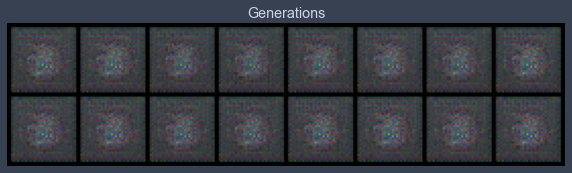

Epoch 1 loss 2.3096179560697365, test L1 = 0.7515080906450748
Epoch 2 loss 1.7082398839013273, test L1 = 0.7397337295114994
Epoch 3 loss 1.3830414994066114, test L1 = 0.7390466406941414
Epoch 4 loss 1.2764066015322184, test L1 = 0.7394237741827965
Epoch 5 loss 1.2150869652168037, test L1 = 0.7420530952513218
test_fixed_labels=tensor([14, 12,  8,  4, 27, 41, 17, 14, 10, 13, 28,  4,  2, 29,  7, 11],
       device='cuda:0')


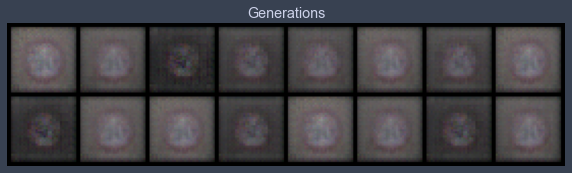

Epoch 6 loss 1.1216653394944889, test L1 = 0.7400760613381863
Epoch 7 loss 1.1552259360801722, test L1 = 0.7434418834745884
Epoch 8 loss 1.0660750495199485, test L1 = 0.7380989603698254
Epoch 9 loss 1.017913437381233, test L1 = 0.7397574596107006
Epoch 10 loss 1.0009864921012694, test L1 = 0.7370182946324348
test_fixed_labels=tensor([14, 12,  8,  4, 27, 41, 17, 14, 10, 13, 28,  4,  2, 29,  7, 11],
       device='cuda:0')


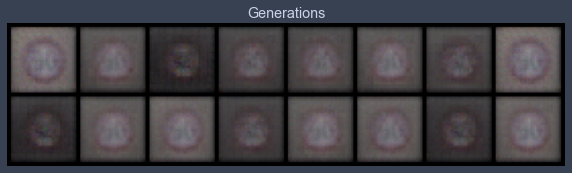

Epoch 11 loss 0.9389990457554453, test L1 = 0.7420704811811447
Epoch 12 loss 0.958460759051477, test L1 = 0.7398509532213211
Epoch 13 loss 0.9150798601383197, test L1 = 0.7360067777335644
Epoch 14 loss 0.8925066782846484, test L1 = 0.7341721318662167
Epoch 15 loss 0.8975261320772859, test L1 = 0.7290426306426525
test_fixed_labels=tensor([14, 12,  8,  4, 27, 41, 17, 14, 10, 13, 28,  4,  2, 29,  7, 11],
       device='cuda:0')


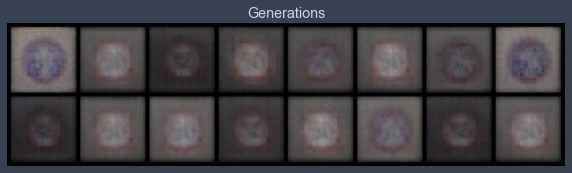

Epoch 16 loss 0.8876580944175982, test L1 = 0.7395424172282219
Epoch 17 loss 0.880740552014092, test L1 = 0.7293483801186085
Epoch 18 loss 0.8771589681045296, test L1 = 0.7334345728158951
Epoch 19 loss 0.8742684908339248, test L1 = 0.7299692258238792
Epoch 20 loss 0.8716662268048709, test L1 = 0.7284245602786541
test_fixed_labels=tensor([14, 12,  8,  4, 27, 41, 17, 14, 10, 13, 28,  4,  2, 29,  7, 11],
       device='cuda:0')


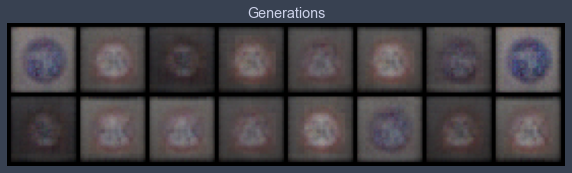

Epoch 21 loss 0.8718665250388208, test L1 = 0.7293881177902222
Epoch 22 loss 0.870574829095008, test L1 = 0.7267302460968494
Epoch 23 loss 0.867294562641288, test L1 = 0.7270540148019791
Epoch 24 loss 0.8653572039915524, test L1 = 0.726008053869009
Epoch 25 loss 0.863863414300676, test L1 = 0.7240580916404724
test_fixed_labels=tensor([14, 12,  8,  4, 27, 41, 17, 14, 10, 13, 28,  4,  2, 29,  7, 11],
       device='cuda:0')


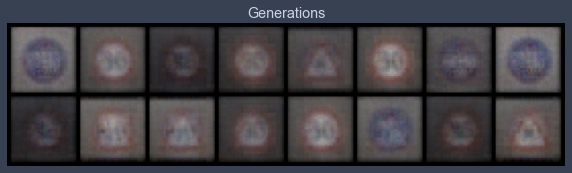

Epoch 26 loss 0.8624668393757745, test L1 = 0.7228770218789577
Epoch 27 loss 0.8615032915806852, test L1 = 0.7241016365587711
Epoch 28 loss 0.8591196078205436, test L1 = 0.7205907329916954
Epoch 29 loss 0.8578119349643537, test L1 = 0.7212919853627682
Epoch 30 loss 0.8703527301037844, test L1 = 0.7218157313764095
test_fixed_labels=tensor([14, 12,  8,  4, 27, 41, 17, 14, 10, 13, 28,  4,  2, 29,  7, 11],
       device='cuda:0')


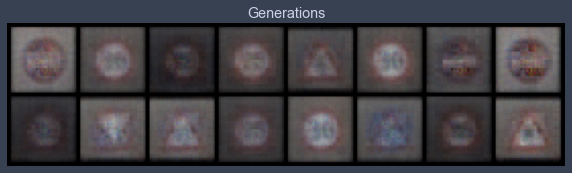

Epoch 31 loss 0.8569412344100139, test L1 = 0.7232453636825085
Epoch 32 loss 0.8542327465060651, test L1 = 0.7248564995825291
Epoch 33 loss 0.854253760932647, test L1 = 0.7186375670135021
Epoch 34 loss 0.853266408762981, test L1 = 0.7197598144412041


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 0.8519618136366618, test L1 = 0.7190457060933113
test_fixed_labels=tensor([14, 12,  8,  4, 27, 41, 17, 14, 10, 13, 28,  4,  2, 29,  7, 11],
       device='cuda:0')


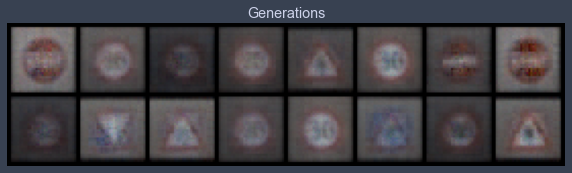

Epoch 36 loss 0.8515327042320749, test L1 = 0.7161045856773853
Epoch 37 loss 0.8506348258031603, test L1 = 0.7163269929587841
Epoch 38 loss 0.8508921486815226, test L1 = 0.7157897464931011
Epoch 39 loss 0.8501733838487736, test L1 = 0.7138416841626167


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 0.8492852215914383, test L1 = 0.7193129919469357
test_fixed_labels=tensor([14, 12,  8,  4, 27, 41, 17, 14, 10, 13, 28,  4,  2, 29,  7, 11],
       device='cuda:0')


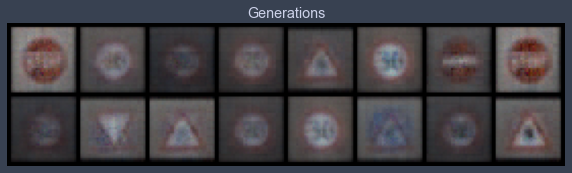

Epoch 41 loss 0.8487206877711713, test L1 = 0.7163010090589523
Epoch 42 loss 0.8477416114299158, test L1 = 0.7139053493738174
Epoch 43 loss 0.8482549577644191, test L1 = 0.7163316570222378
Epoch 44 loss 0.8461790355210451, test L1 = 0.7147206254303455
Epoch 45 loss 0.846363267947718, test L1 = 0.7182434350252151
test_fixed_labels=tensor([14, 12,  8,  4, 27, 41, 17, 14, 10, 13, 28,  4,  2, 29,  7, 11],
       device='cuda:0')


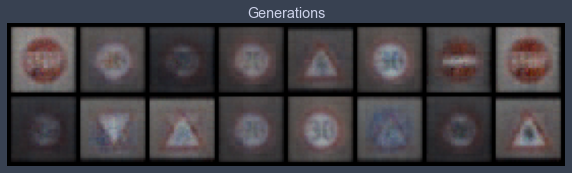

Epoch 46 loss 0.8463489949908044, test L1 = 0.7160387150943279
Epoch 47 loss 0.8458991527967027, test L1 = 0.7144441418349743
Epoch 48 loss 0.8456990204725888, test L1 = 0.7172199040651321
Epoch 49 loss 0.8456949706339755, test L1 = 0.710623063147068
Epoch 50 loss 0.8470480501446936, test L1 = 0.7118365094065666
test_fixed_labels=tensor([14, 12,  8,  4, 27, 41, 17, 14, 10, 13, 28,  4,  2, 29,  7, 11],
       device='cuda:0')


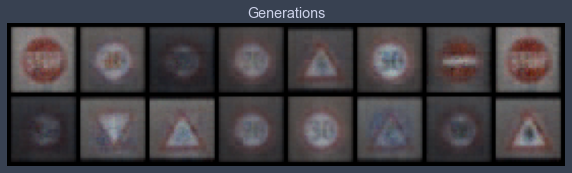

Epoch 51 loss 0.8450121013159605, test L1 = 0.7146511264145374
Epoch 52 loss 0.8444145157984442, test L1 = 0.711592648178339
Epoch 53 loss 0.8436817377293643, test L1 = 0.7120495513081551
Epoch 54 loss 0.8443469433850029, test L1 = 0.7108845859766006
Epoch 55 loss 0.8431337217694705, test L1 = 0.7146380618214607
test_fixed_labels=tensor([14, 12,  8,  4, 27, 41, 17, 14, 10, 13, 28,  4,  2, 29,  7, 11],
       device='cuda:0')


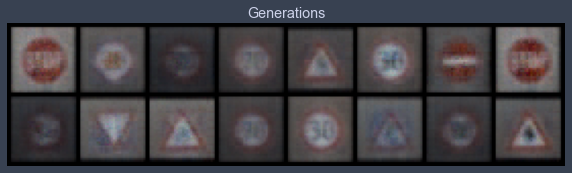

Epoch 56 loss 0.8430602968353587, test L1 = 0.7150560691952705
Epoch 57 loss 0.8428459384597045, test L1 = 0.7075056470930576
Epoch 58 loss 0.8424967152556193, test L1 = 0.713356014341116
Epoch 59 loss 0.8421102721256899, test L1 = 0.7108447216451168
Epoch 60 loss 0.8424353779796063, test L1 = 0.7154504880309105
test_fixed_labels=tensor([14, 12,  8,  4, 27, 41, 17, 14, 10, 13, 28,  4,  2, 29,  7, 11],
       device='cuda:0')


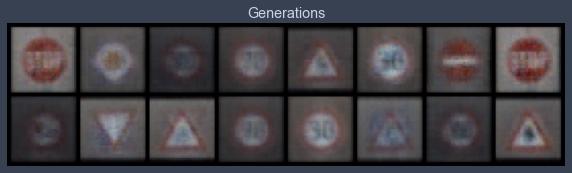

Epoch 61 loss 0.842345187139675, test L1 = 0.7139632254838943
Epoch 62 loss 0.8417897451784193, test L1 = 0.709302294999361
Epoch 63 loss 0.8410139147358662, test L1 = 0.7075396440923214
Epoch 64 loss 0.8415978854054847, test L1 = 0.7139427103102207
Epoch 65 loss 0.8408967723551485, test L1 = 0.7128185443580151
test_fixed_labels=tensor([14, 12,  8,  4, 27, 41, 17, 14, 10, 13, 28,  4,  2, 29,  7, 11],
       device='cuda:0')


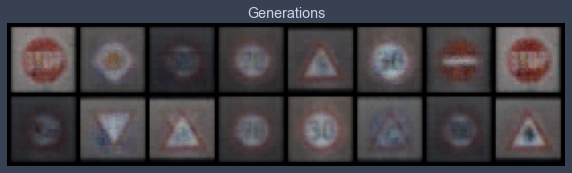

Epoch 66 loss 0.841206796800148, test L1 = 0.7120721377432346
Epoch 67 loss 0.8399011738521537, test L1 = 0.7116258926689625
Epoch 68 loss 0.8403365857822379, test L1 = 0.7086823545396328
Epoch 69 loss 0.8408625488428726, test L1 = 0.7083924524486065
Epoch 70 loss 0.8400993189451211, test L1 = 0.7105730287730694
test_fixed_labels=tensor([14, 12,  8,  4, 27, 41, 17, 14, 10, 13, 28,  4,  2, 29,  7, 11],
       device='cuda:0')


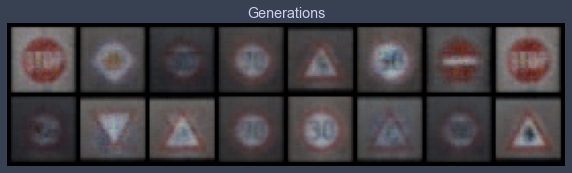

Epoch 71 loss 0.839926482680737, test L1 = 0.7119334936141968
Epoch 72 loss 0.8398932996894076, test L1 = 0.7144366353750229
Epoch 73 loss 0.8399360302797297, test L1 = 0.7143715247511864
Epoch 74 loss 0.8393874526843172, test L1 = 0.7157249450683594
Epoch 75 loss 0.8392352818213787, test L1 = 0.7168307639658451
test_fixed_labels=tensor([14, 12,  8,  4, 27, 41, 17, 14, 10, 13, 28,  4,  2, 29,  7, 11],
       device='cuda:0')


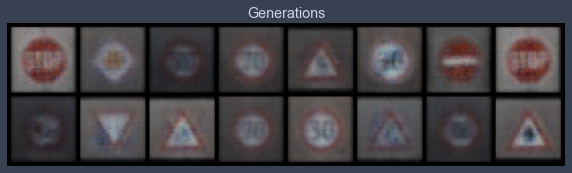

Epoch 76 loss 0.8391261700912029, test L1 = 0.7114395089447498
Epoch 77 loss 0.8392455764242873, test L1 = 0.7071502469480038
Epoch 78 loss 0.838702502734063, test L1 = 0.710662167519331
Epoch 79 loss 0.8386715863578508, test L1 = 0.7083536759018898






~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=256 | LR=0.001
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Epoch 0 loss 87.29616865915122, test L1 = 0.7582299038767815
test_fixed_labels=tensor([10,  7, 38, 40, 13, 34,  4, 12, 35,  9,  4, 17, 13,  2,  9, 31],
       device='cuda:0')


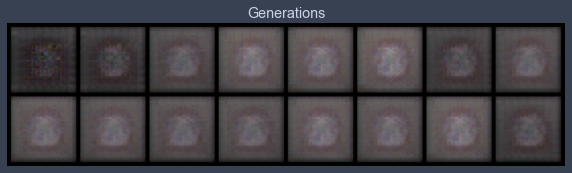

Epoch 1 loss 1.449393630232598, test L1 = 0.7499340139329433
Epoch 2 loss 0.9468274591714656, test L1 = 0.7380352392792702
Epoch 3 loss 0.8940745223428785, test L1 = 0.733790572732687
Epoch 4 loss 0.8814935747700459, test L1 = 0.7319321371614933
Epoch 5 loss 0.8748736670336772, test L1 = 0.7264023274183273
test_fixed_labels=tensor([10,  7, 38, 40, 13, 34,  4, 12, 35,  9,  4, 17, 13,  2,  9, 31],
       device='cuda:0')


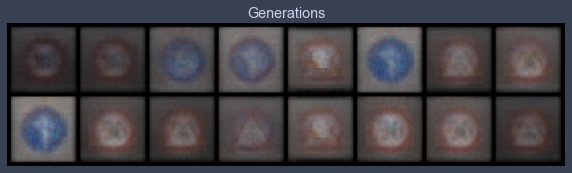

Epoch 6 loss 0.8655012964792678, test L1 = 0.7234594970941544
Epoch 7 loss 0.8580633012699508, test L1 = 0.7163124121725559
Epoch 8 loss 0.8544115542955825, test L1 = 0.7165992520749569
Epoch 9 loss 0.8514422612501583, test L1 = 0.7154143340885639
Epoch 10 loss 0.8492474635851752, test L1 = 0.7123262882232666
test_fixed_labels=tensor([10,  7, 38, 40, 13, 34,  4, 12, 35,  9,  4, 17, 13,  2,  9, 31],
       device='cuda:0')


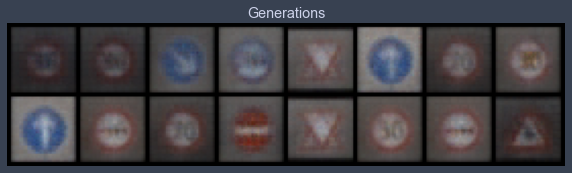

Epoch 11 loss 0.8469800201478282, test L1 = 0.7138627581298351
Epoch 12 loss 0.8454034846672898, test L1 = 0.7150712683796883
Epoch 13 loss 0.8444146819131071, test L1 = 0.7126733623445034
Epoch 14 loss 0.8427638094040126, test L1 = 0.7067987732589245
Epoch 15 loss 0.8415366532057011, test L1 = 0.7137975767254829
test_fixed_labels=tensor([10,  7, 38, 40, 13, 34,  4, 12, 35,  9,  4, 17, 13,  2,  9, 31],
       device='cuda:0')


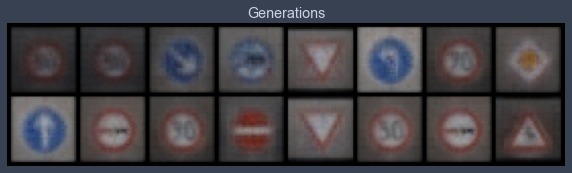

Epoch 16 loss 0.8408277102352417, test L1 = 0.7108139730989933
Epoch 17 loss 0.8402563423635214, test L1 = 0.7091847099363804
Epoch 18 loss 0.839278986978367, test L1 = 0.7078987844288349
Epoch 19 loss 0.8399440183262645, test L1 = 0.7026916556060314
Epoch 20 loss 0.8395201252498168, test L1 = 0.7068908102810383
test_fixed_labels=tensor([10,  7, 38, 40, 13, 34,  4, 12, 35,  9,  4, 17, 13,  2,  9, 31],
       device='cuda:0')


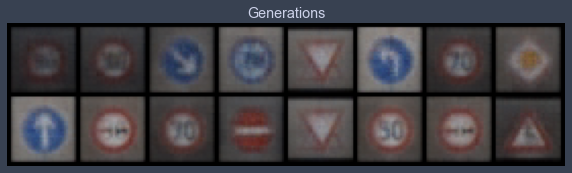

Epoch 21 loss 0.8384877621513052, test L1 = 0.7130356468260288
Epoch 22 loss 0.8385605662549075, test L1 = 0.7080214992165565
Epoch 23 loss 0.8378736849912664, test L1 = 0.7094805352389812
Epoch 24 loss 0.8373700400808013, test L1 = 0.7073492258787155
Epoch 25 loss 0.8371045933556311, test L1 = 0.7155184485018253
test_fixed_labels=tensor([10,  7, 38, 40, 13, 34,  4, 12, 35,  9,  4, 17, 13,  2,  9, 31],
       device='cuda:0')


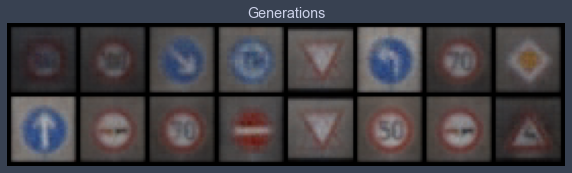

Epoch 26 loss 0.83708953714043, test L1 = 0.7099009081721306
Epoch 27 loss 0.8363527534753596, test L1 = 0.7069163024425507
Epoch 28 loss 0.8362127210676056, test L1 = 0.7075693607330322
Epoch 29 loss 0.8358121905539864, test L1 = 0.7105449922382832
Epoch 30 loss 0.8360611286359964, test L1 = 0.7118013352155685
test_fixed_labels=tensor([10,  7, 38, 40, 13, 34,  4, 12, 35,  9,  4, 17, 13,  2,  9, 31],
       device='cuda:0')


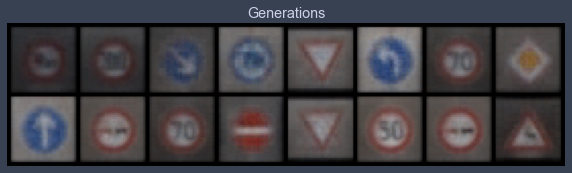

Epoch 31 loss 0.835704232818892, test L1 = 0.7109140604734421
Epoch 32 loss 0.8355748413764325, test L1 = 0.7117257453501225
Epoch 33 loss 0.835085314164047, test L1 = 0.7141772359609604
Epoch 34 loss 0.834922237904211, test L1 = 0.7085575833916664
Epoch 35 loss 0.8348151496595534, test L1 = 0.7071572989225388
test_fixed_labels=tensor([10,  7, 38, 40, 13, 34,  4, 12, 35,  9,  4, 17, 13,  2,  9, 31],
       device='cuda:0')


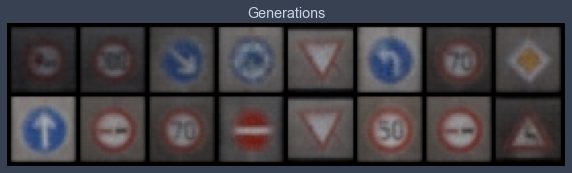

Epoch 36 loss 0.8348408839137283, test L1 = 0.7070397958159447
Epoch 37 loss 0.8350980830766082, test L1 = 0.708816472440958
Epoch 38 loss 0.8346686965411472, test L1 = 0.7030208632349968
Epoch 39 loss 0.8345850073185164, test L1 = 0.7065311931073666
Epoch 40 loss 0.8357871805679348, test L1 = 0.7136463671922684
test_fixed_labels=tensor([10,  7, 38, 40, 13, 34,  4, 12, 35,  9,  4, 17, 13,  2,  9, 31],
       device='cuda:0')


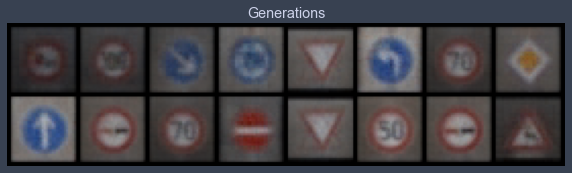

Epoch 41 loss 0.8369992875151618, test L1 = 0.708861593157053
Epoch 42 loss 411762.5534906197, test L1 = 0.7402857206761837
Epoch 43 loss 283182.6424337531, test L1 = 0.7137663476169109
Epoch 44 loss 2808.885041219672, test L1 = 0.7067262269556522
Epoch 45 loss 89.03092860356229, test L1 = 0.70707868039608
test_fixed_labels=tensor([10,  7, 38, 40, 13, 34,  4, 12, 35,  9,  4, 17, 13,  2,  9, 31],
       device='cuda:0')


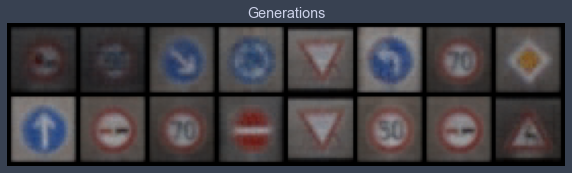

Epoch 46 loss 56.971478039046744, test L1 = 0.7072526849806309
Epoch 47 loss 28.13602563830995, test L1 = 0.7090762369334698
Epoch 48 loss 76.4655031391845, test L1 = 0.7086743488907814
Epoch 49 loss 16.911508057125655, test L1 = 0.7101029343903065


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 50 loss 7.689718359524441, test L1 = 0.7030137367546558
test_fixed_labels=tensor([10,  7, 38, 40, 13, 34,  4, 12, 35,  9,  4, 17, 13,  2,  9, 31],
       device='cuda:0')


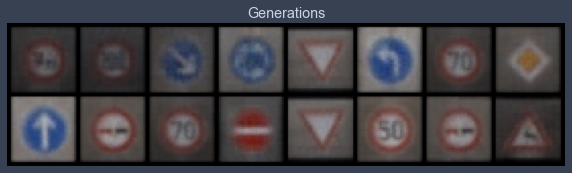

Epoch 51 loss 10.807730055961413, test L1 = 0.7040150240063667
Epoch 52 loss 7.626555315612518, test L1 = 0.7074779905378819
Epoch 53 loss 5.558344020671451, test L1 = 0.7111357823014259
Epoch 54 loss 6.382810188937433, test L1 = 0.706032034009695


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 55 loss 4.085921540497914, test L1 = 0.7106859870254993
test_fixed_labels=tensor([10,  7, 38, 40, 13, 34,  4, 12, 35,  9,  4, 17, 13,  2,  9, 31],
       device='cuda:0')


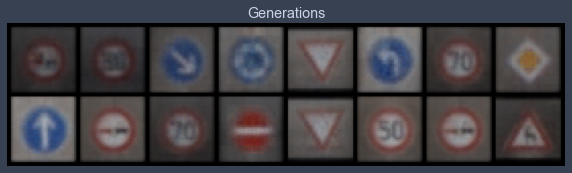

Epoch 56 loss 3.517047642432537, test L1 = 0.7037420645356178
Epoch 57 loss 12.954205754286646, test L1 = 0.7063671946525574
Epoch 58 loss 3.853170683908299, test L1 = 0.7072039283812046
Epoch 59 loss 3.1111156582013026, test L1 = 0.7091093733906746
Epoch 60 loss 3.423717492839315, test L1 = 0.7094911858439445
test_fixed_labels=tensor([10,  7, 38, 40, 13, 34,  4, 12, 35,  9,  4, 17, 13,  2,  9, 31],
       device='cuda:0')


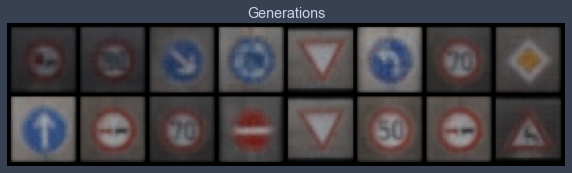

Epoch 61 loss 3.8375917894324076, test L1 = 0.7064266875386238
Epoch 62 loss 9.281866509480166, test L1 = 0.7033784203231335
Epoch 63 loss 27.64965404595706, test L1 = 0.7091038785874844
Epoch 64 loss 3.705995157412237, test L1 = 0.7030565552413464
Epoch 65 loss 1.522589839201203, test L1 = 0.7056757770478725
test_fixed_labels=tensor([10,  7, 38, 40, 13, 34,  4, 12, 35,  9,  4, 17, 13,  2,  9, 31],
       device='cuda:0')


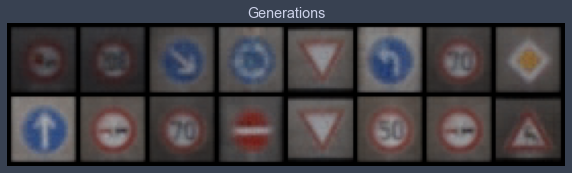

Epoch 66 loss 2.0121129857715463, test L1 = 0.7063529938459396
Epoch 67 loss 1.465396045614354, test L1 = 0.7090575993061066
Epoch 68 loss 1.5566121769934584, test L1 = 0.7018701806664467
Epoch 69 loss 1.3590515317376126, test L1 = 0.7019038870930672
Epoch 70 loss 275.79572049100784, test L1 = 0.7089513540267944
test_fixed_labels=tensor([10,  7, 38, 40, 13, 34,  4, 12, 35,  9,  4, 17, 13,  2,  9, 31],
       device='cuda:0')


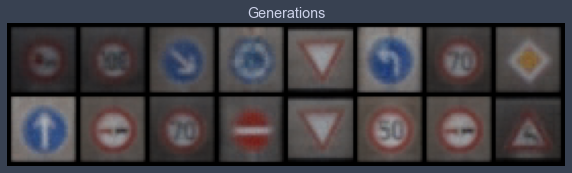

Epoch 71 loss 11.7157861700992, test L1 = 0.7047601044178009
Epoch 72 loss 2.063215371464536, test L1 = 0.7120905853807926
Epoch 73 loss 1.6643789132026463, test L1 = 0.7094492539763451
Epoch 74 loss 1.1861148935413033, test L1 = 0.7079814225435257
Epoch 75 loss 1.3374107457518167, test L1 = 0.7062265872955322
test_fixed_labels=tensor([10,  7, 38, 40, 13, 34,  4, 12, 35,  9,  4, 17, 13,  2,  9, 31],
       device='cuda:0')


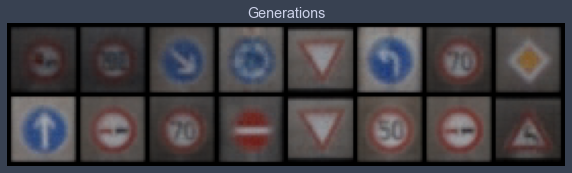

Epoch 76 loss 2.3011319248127364, test L1 = 0.705199621617794
Epoch 77 loss 9.988168884593597, test L1 = 0.7073554880917072
Epoch 78 loss 4.27882306149735, test L1 = 0.7032476216554642
Epoch 79 loss 0.8810179995507309, test L1 = 0.7074575684964657






~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=256 | LR=0.01
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Epoch 0 loss 71303497.35561232, test L1 = 0.6643161252140999
test_fixed_labels=tensor([38, 13, 30,  3, 12, 15,  2,  9, 38, 36,  5, 18,  2, 32,  7,  9],
       device='cuda:0')


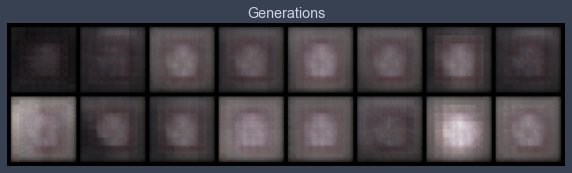

Epoch 1 loss 17119.35723058956, test L1 = 0.6681508384644985
Epoch 2 loss 10204.633849468428, test L1 = 0.660170778632164
Epoch 3 loss 8710.695893068085, test L1 = 0.6845472417771816
Epoch 4 loss 37802.3009591119, test L1 = 0.701614998281002
Epoch 5 loss 4037.297890155176, test L1 = 0.7074281126260757
test_fixed_labels=tensor([38, 13, 30,  3, 12, 15,  2,  9, 38, 36,  5, 18,  2, 32,  7,  9],
       device='cuda:0')


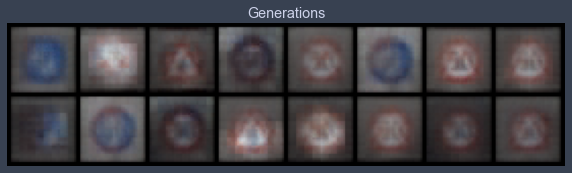

Epoch 6 loss 3108.79037255356, test L1 = 0.6990621648728848
Epoch 7 loss 2461.2761914230296, test L1 = 0.7169240899384022
Epoch 8 loss 2591.665391849898, test L1 = 0.7096712552011013
Epoch 9 loss 3531.7049980032484, test L1 = 0.7157687544822693


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 2512.477518507705, test L1 = 0.7159992009401321
test_fixed_labels=tensor([38, 13, 30,  3, 12, 15,  2,  9, 38, 36,  5, 18,  2, 32,  7,  9],
       device='cuda:0')


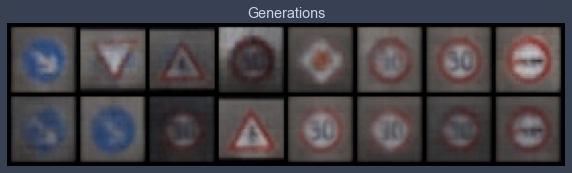

Epoch 11 loss 2146.5183040448483, test L1 = 0.7046906054019928
Epoch 12 loss 1233.50989126094, test L1 = 0.7011473700404167
Epoch 13 loss 960.4779986089857, test L1 = 0.7174761146306992
Epoch 14 loss 1114.6597218726508, test L1 = 0.7148011773824692


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 1088.1319606295976, test L1 = 0.7016775012016296
test_fixed_labels=tensor([38, 13, 30,  3, 12, 15,  2,  9, 38, 36,  5, 18,  2, 32,  7,  9],
       device='cuda:0')


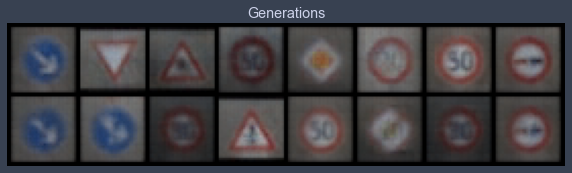

Epoch 16 loss 17659.25136542566, test L1 = 0.7178298197686672
Epoch 17 loss 245.7536579554843, test L1 = 0.6969024837017059
Epoch 18 loss 108.42254575626137, test L1 = 0.7079256437718868
Epoch 19 loss 71.4512428114914, test L1 = 0.7133378200232983


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 61.392514256677266, test L1 = 0.7066669724881649
test_fixed_labels=tensor([38, 13, 30,  3, 12, 15,  2,  9, 38, 36,  5, 18,  2, 32,  7,  9],
       device='cuda:0')


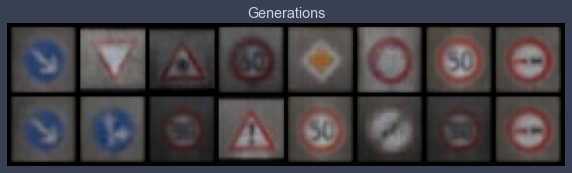

Epoch 21 loss 48.795007982000044, test L1 = 0.713050153106451
Epoch 22 loss 35.88187310458049, test L1 = 0.7161736711859703
Epoch 23 loss 31.963874850895806, test L1 = 0.7077009864151478
Epoch 24 loss 25.100875456103754, test L1 = 0.7056163288652897


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 20.373403569267378, test L1 = 0.7067674547433853
test_fixed_labels=tensor([38, 13, 30,  3, 12, 15,  2,  9, 38, 36,  5, 18,  2, 32,  7,  9],
       device='cuda:0')


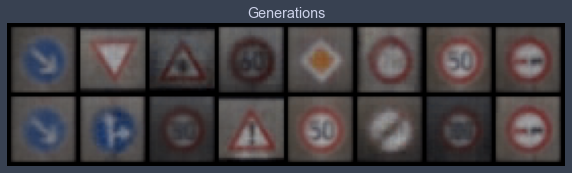

Epoch 26 loss 18.152008334181154, test L1 = 0.7187778130173683
Epoch 27 loss 15.18356981924719, test L1 = 0.7067722529172897
Epoch 28 loss 14.000163500661293, test L1 = 0.7035765908658504
Epoch 29 loss 10.25209788911531, test L1 = 0.7020131386816502


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 8.684639868048048, test L1 = 0.7098358534276485
test_fixed_labels=tensor([38, 13, 30,  3, 12, 15,  2,  9, 38, 36,  5, 18,  2, 32,  7,  9],
       device='cuda:0')


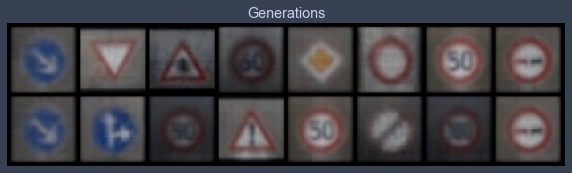

Epoch 31 loss 8.030461582326398, test L1 = 0.7113619111478329
Epoch 32 loss 8.708949150703207, test L1 = 0.7131173834204674
Epoch 33 loss 5.800533518963253, test L1 = 0.7071793898940086
Epoch 34 loss 4.611029015578765, test L1 = 0.7000500410795212


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 4.079562694141545, test L1 = 0.7089649848639965
test_fixed_labels=tensor([38, 13, 30,  3, 12, 15,  2,  9, 38, 36,  5, 18,  2, 32,  7,  9],
       device='cuda:0')


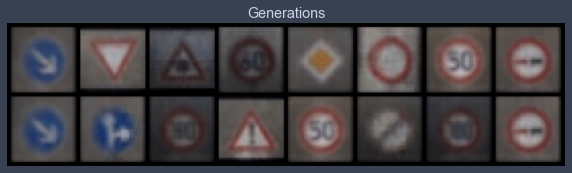

Epoch 36 loss 4.666532466501715, test L1 = 0.7064479850232601
Epoch 37 loss 3.5596331396873055, test L1 = 0.704217366874218
Epoch 38 loss 3.999880754251251, test L1 = 0.7023488245904446
Epoch 39 loss 2.552944502060356, test L1 = 0.7084167823195457


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 2.784921864668528, test L1 = 0.7201872505247593
test_fixed_labels=tensor([38, 13, 30,  3, 12, 15,  2,  9, 38, 36,  5, 18,  2, 32,  7,  9],
       device='cuda:0')


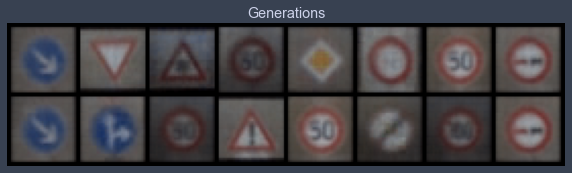

Epoch 41 loss 3.1657875624718943, test L1 = 0.713071420788765
Epoch 42 loss 2.030250990513674, test L1 = 0.7111399099230766
Epoch 43 loss 4.934664312711696, test L1 = 0.7148778550326824
Epoch 44 loss 2.0121709765847196, test L1 = 0.7090006321668625


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 2.45230049243088, test L1 = 0.7040535397827625
test_fixed_labels=tensor([38, 13, 30,  3, 12, 15,  2,  9, 38, 36,  5, 18,  2, 32,  7,  9],
       device='cuda:0')


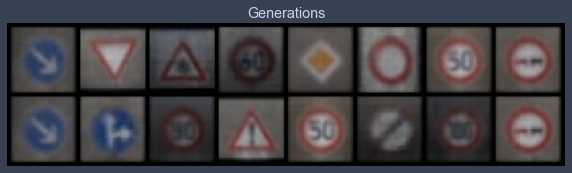

Epoch 46 loss 1.441566639339801, test L1 = 0.7004988864064217
Epoch 47 loss 1.3208409601060795, test L1 = 0.7021834589540958
Epoch 48 loss 1.0380686558399004, test L1 = 0.7013756819069386
Epoch 49 loss 1.6566952540702427, test L1 = 0.7202681787312031


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 50 loss 50.87038021870085, test L1 = 0.7124203108251095
test_fixed_labels=tensor([38, 13, 30,  3, 12, 15,  2,  9, 38, 36,  5, 18,  2, 32,  7,  9],
       device='cuda:0')


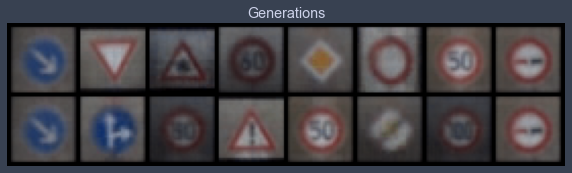

Epoch 51 loss 92.25090349273583, test L1 = 0.7071895226836205
Epoch 52 loss 8.508924379586354, test L1 = 0.7102404423058033
Epoch 53 loss 2.5428710100577048, test L1 = 0.6995595172047615
Epoch 54 loss 3.998907408558626, test L1 = 0.7065754942595959


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 55 loss 1.329952607449797, test L1 = 0.704641055315733
test_fixed_labels=tensor([38, 13, 30,  3, 12, 15,  2,  9, 38, 36,  5, 18,  2, 32,  7,  9],
       device='cuda:0')


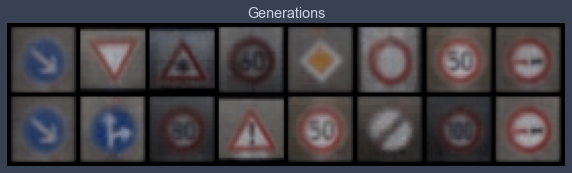

Epoch 56 loss 1.3689383024612243, test L1 = 0.7058137729763985
Epoch 57 loss 168.60989324128914, test L1 = 0.7007849141955376
Epoch 58 loss 20.790825311875427, test L1 = 0.70610062032938
Epoch 59 loss 62.313896419256416, test L1 = 0.7058072835206985


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 60 loss 5.3126805027325945, test L1 = 0.6947505138814449
test_fixed_labels=tensor([38, 13, 30,  3, 12, 15,  2,  9, 38, 36,  5, 18,  2, 32,  7,  9],
       device='cuda:0')


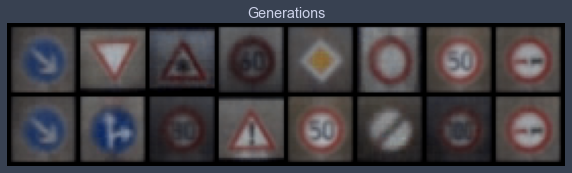

Epoch 61 loss 1.5979712470290588, test L1 = 0.7137854844331741
Epoch 62 loss 1.0666500028875685, test L1 = 0.7185623049736023
Epoch 63 loss 0.9540978090459948, test L1 = 0.704803928732872
Epoch 64 loss 2.78836988460567, test L1 = 0.7080214321613312


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 65 loss 0.8327476894322949, test L1 = 0.7041185460984707
test_fixed_labels=tensor([38, 13, 30,  3, 12, 15,  2,  9, 38, 36,  5, 18,  2, 32,  7,  9],
       device='cuda:0')


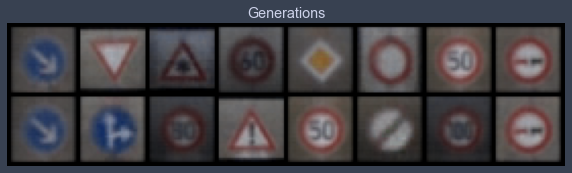

Epoch 66 loss 1.2055727073417086, test L1 = 0.7045277133584023
Epoch 67 loss 0.9392599787089423, test L1 = 0.7064395062625408
Epoch 68 loss 0.910801751097453, test L1 = 0.7126108407974243
Epoch 69 loss 0.9874385310612184, test L1 = 0.7101976089179516


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 70 loss 0.9589183070405652, test L1 = 0.7053268253803253
test_fixed_labels=tensor([38, 13, 30,  3, 12, 15,  2,  9, 38, 36,  5, 18,  2, 32,  7,  9],
       device='cuda:0')


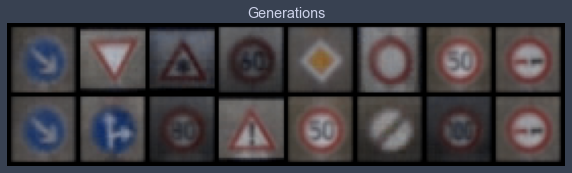

Epoch 71 loss 1.0217558862417424, test L1 = 0.7140885666012764
Epoch 72 loss 1.0289427142372656, test L1 = 0.7005483470857143
Epoch 73 loss 0.8901655649401478, test L1 = 0.7075548097491264
Epoch 74 loss 0.9316560826760387, test L1 = 0.7076669447124004


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 75 loss 1.354651083856104, test L1 = 0.7030475661158562
test_fixed_labels=tensor([38, 13, 30,  3, 12, 15,  2,  9, 38, 36,  5, 18,  2, 32,  7,  9],
       device='cuda:0')


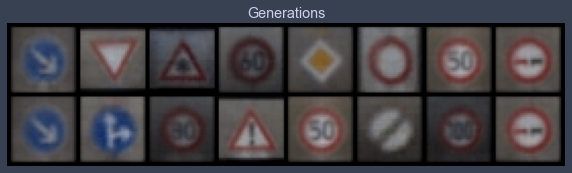

Epoch 76 loss 18.522933334624234, test L1 = 0.7085280679166317
Epoch 77 loss 7200582.370041496, test L1 = 0.7012653090059757
Epoch 78 loss 43.9026668719, test L1 = 0.701490830630064
Epoch 79 loss 26.817519695898103, test L1 = 0.7080472111701965






~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=256 | LR=0.1
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 0 loss 13646736320948.113, test L1 = 0.7636382766067982
test_fixed_labels=tensor([ 7, 33,  6,  7, 38, 11, 38,  0,  4, 18, 38, 38, 36,  5, 28,  9],
       device='cuda:0')


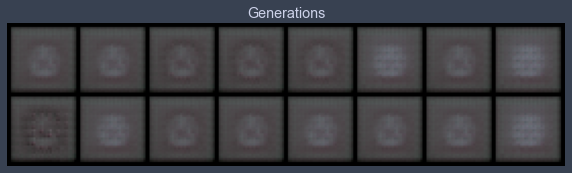

Epoch 1 loss 9488273.137457045, test L1 = 0.8002721071243286
Epoch 2 loss 6167598.259450172, test L1 = 0.7652166672050953
Epoch 3 loss 3500081.412371134, test L1 = 0.7622753120958805
Epoch 4 loss 1735875.4617697594, test L1 = 0.7397542968392372
Epoch 5 loss 753137.2393685566, test L1 = 0.744245108217001
test_fixed_labels=tensor([ 7, 33,  6,  7, 38, 11, 38,  0,  4, 18, 38, 38, 36,  5, 28,  9],
       device='cuda:0')


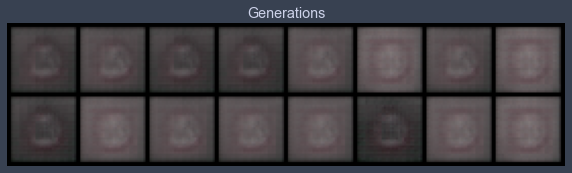

Epoch 6 loss 291061.0447809278, test L1 = 0.7555412277579308
Epoch 7 loss 108727.30973475086, test L1 = 0.7449408248066902
Epoch 8 loss 48525.46716602234, test L1 = 0.7509914897382259
Epoch 9 loss 31439.88251047036, test L1 = 0.7342569679021835


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 26396.11412693299, test L1 = 0.7402439303696156
test_fixed_labels=tensor([ 7, 33,  6,  7, 38, 11, 38,  0,  4, 18, 38, 38, 36,  5, 28,  9],
       device='cuda:0')


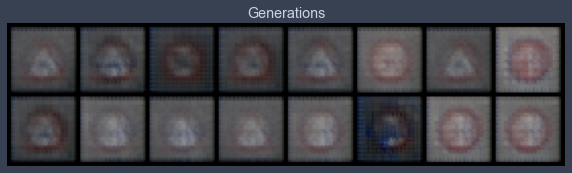

Epoch 11 loss 24018.14254456615, test L1 = 0.7045469395816326
Epoch 12 loss 22163.546727341065, test L1 = 0.7361644394695759
Epoch 13 loss 20471.894954091495, test L1 = 0.7230756655335426
Epoch 14 loss 18905.542116355242, test L1 = 0.7542245946824551


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 17464.462440936426, test L1 = 0.7284861765801907
test_fixed_labels=tensor([ 7, 33,  6,  7, 38, 11, 38,  0,  4, 18, 38, 38, 36,  5, 28,  9],
       device='cuda:0')


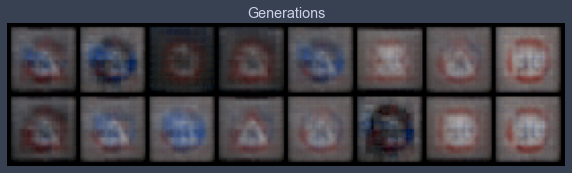

Epoch 16 loss 16154.04196534042, test L1 = 0.7207767590880394
Epoch 17 loss 14980.468531867482, test L1 = 0.7033231928944588
Epoch 18 loss 13912.740314916236, test L1 = 0.7233845368027687
Epoch 19 loss 12966.464773276417, test L1 = 0.7395604252815247


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 12139.158934707904, test L1 = 0.7382938973605633
test_fixed_labels=tensor([ 7, 33,  6,  7, 38, 11, 38,  0,  4, 18, 38, 38, 36,  5, 28,  9],
       device='cuda:0')


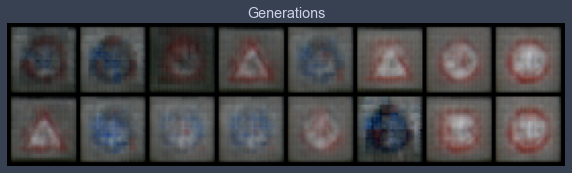

Epoch 21 loss 11426.919693674829, test L1 = 0.715768851339817
Epoch 22 loss 10824.027216226375, test L1 = 0.7182087749242783
Epoch 23 loss 10323.051190667955, test L1 = 0.7385000362992287
Epoch 24 loss 9915.276088649054, test L1 = 0.694374080747366


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 25 loss 9591.018769464132, test L1 = 0.7117894515395164
test_fixed_labels=tensor([ 7, 33,  6,  7, 38, 11, 38,  0,  4, 18, 38, 38, 36,  5, 28,  9],
       device='cuda:0')


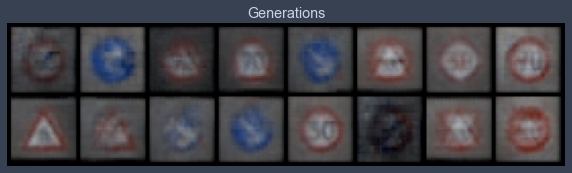

Epoch 26 loss 9339.902360529424, test L1 = 0.7398738600313663
Epoch 27 loss 9148.750090608892, test L1 = 0.7185700759291649
Epoch 28 loss 8991.044827910224, test L1 = 0.7396570891141891
Epoch 29 loss 8894.006785599227, test L1 = 0.7206861451268196
Epoch 30 loss 8827.795831319803, test L1 = 0.7217565625905991
test_fixed_labels=tensor([ 7, 33,  6,  7, 38, 11, 38,  0,  4, 18, 38, 38, 36,  5, 28,  9],
       device='cuda:0')


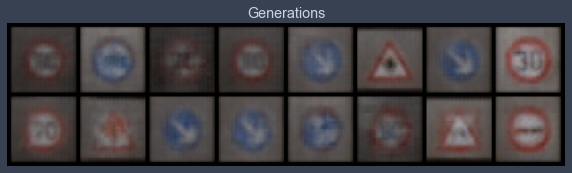

Epoch 31 loss 8784.110734133375, test L1 = 0.7409527413547039
Epoch 32 loss 8756.309056862114, test L1 = 0.7031490057706833
Epoch 33 loss 8739.328450520834, test L1 = 0.7019192092120647
Epoch 34 loss 8729.46651498067, test L1 = 0.7507657371461391


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 8724.077618261383, test L1 = 0.6932903602719307
test_fixed_labels=tensor([ 7, 33,  6,  7, 38, 11, 38,  0,  4, 18, 38, 38, 36,  5, 28,  9],
       device='cuda:0')


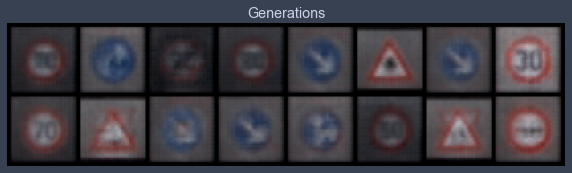

Epoch 36 loss 8721.346562231529, test L1 = 0.7088487595319748
Epoch 37 loss 8720.079081427191, test L1 = 0.7011853791773319
Epoch 38 loss 8719.55122758269, test L1 = 0.7101381421089172
Epoch 39 loss 8719.354401578608, test L1 = 0.7150329202413559


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 8719.292314352448, test L1 = 0.6985866501927376
test_fixed_labels=tensor([ 7, 33,  6,  7, 38, 11, 38,  0,  4, 18, 38, 38, 36,  5, 28,  9],
       device='cuda:0')


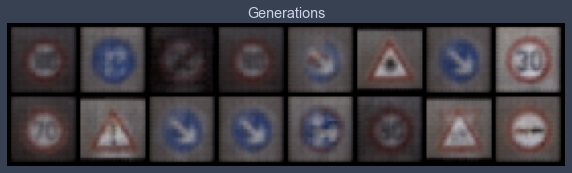

Epoch 41 loss 8719.274917445233, test L1 = 0.7249790988862514
Epoch 42 loss 8719.270293035868, test L1 = 0.7213351354002953
Epoch 43 loss 8719.269292982173, test L1 = 0.7169798016548157
Epoch 44 loss 8719.269037934922, test L1 = 0.7048578523099422
Epoch 45 loss 8719.266447191796, test L1 = 0.7141726687550545
test_fixed_labels=tensor([ 7, 33,  6,  7, 38, 11, 38,  0,  4, 18, 38, 38, 36,  5, 28,  9],
       device='cuda:0')


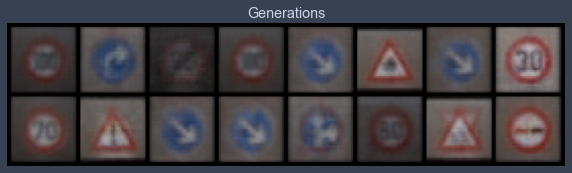

Epoch 46 loss 8719.267306298325, test L1 = 0.7283966839313507
Epoch 47 loss 8719.267809681056, test L1 = 0.7200493551790714
Epoch 48 loss 8719.268903699527, test L1 = 0.7118388526141644
Epoch 49 loss 8719.267135148197, test L1 = 0.7155348248779774
Epoch 50 loss 8719.26689688037, test L1 = 0.711492795497179
test_fixed_labels=tensor([ 7, 33,  6,  7, 38, 11, 38,  0,  4, 18, 38, 38, 36,  5, 28,  9],
       device='cuda:0')


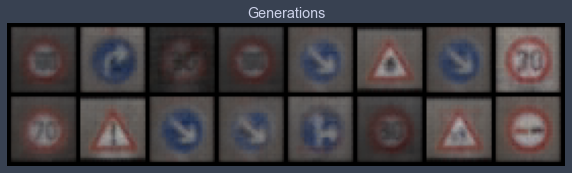

Epoch 51 loss 8719.265430358677, test L1 = 0.7127475701272488
Epoch 52 loss 13871.662552351803, test L1 = 0.7264034226536751
Epoch 53 loss 10005.580752657861, test L1 = 0.6876947395503521
Epoch 54 loss 15156.670324581186, test L1 = 0.714446447789669
Epoch 55 loss 17012.95097723368, test L1 = 0.7313502132892609
test_fixed_labels=tensor([ 7, 33,  6,  7, 38, 11, 38,  0,  4, 18, 38, 38, 36,  5, 28,  9],
       device='cuda:0')


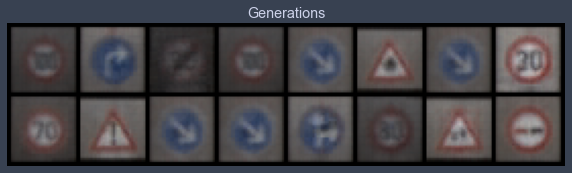

Epoch 56 loss 16072.136503973368, test L1 = 0.714466031640768
Epoch 57 loss 8989.806224495274, test L1 = 0.7000997327268124
Epoch 58 loss 15264.578507570875, test L1 = 0.6909101568162441
Epoch 59 loss 29244.50100340958, test L1 = 0.7093623615801334


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 60 loss 8831.422062929554, test L1 = 0.7101265490055084
test_fixed_labels=tensor([ 7, 33,  6,  7, 38, 11, 38,  0,  4, 18, 38, 38, 36,  5, 28,  9],
       device='cuda:0')


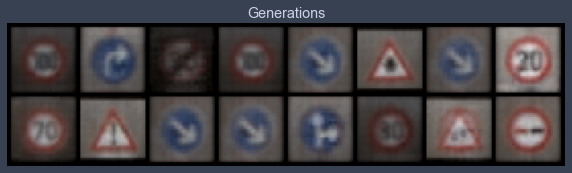

Epoch 61 loss 8831.392695580971, test L1 = 0.7346784695982933
Epoch 62 loss 17394.647326702107, test L1 = 0.7107601203024387
Epoch 63 loss 15812.52272940829, test L1 = 0.7176315449178219
Epoch 64 loss 14559.150742992912, test L1 = 0.7062788382172585


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 65 loss 10358.687872503222, test L1 = 0.7197923362255096
test_fixed_labels=tensor([ 7, 33,  6,  7, 38, 11, 38,  0,  4, 18, 38, 38, 36,  5, 28,  9],
       device='cuda:0')


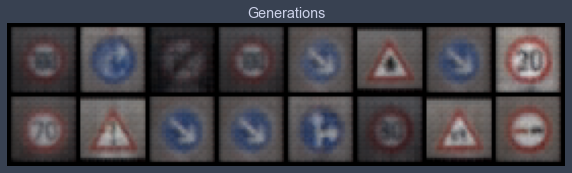

Epoch 66 loss 18407.4738543009, test L1 = 0.7164792120456696
Epoch 67 loss 8831.395390356529, test L1 = 0.7199665792286396
Epoch 68 loss 14707.60116986147, test L1 = 0.6892787329852581
Epoch 69 loss 15807.340665941796, test L1 = 0.698768325150013


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 70 loss 8832.169837977877, test L1 = 0.7187217622995377
test_fixed_labels=tensor([ 7, 33,  6,  7, 38, 11, 38,  0,  4, 18, 38, 38, 36,  5, 28,  9],
       device='cuda:0')


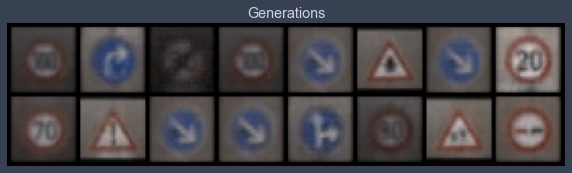

Epoch 71 loss 28329.7751020189, test L1 = 0.715354435145855
Epoch 72 loss 8831.390074634879, test L1 = 0.7182828262448311
Epoch 73 loss 8831.672072997208, test L1 = 0.6870850510895252
Epoch 74 loss 15505.046445446735, test L1 = 0.6959237791597843


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 75 loss 14994.735891859966, test L1 = 0.7050734348595142
test_fixed_labels=tensor([ 7, 33,  6,  7, 38, 11, 38,  0,  4, 18, 38, 38, 36,  5, 28,  9],
       device='cuda:0')


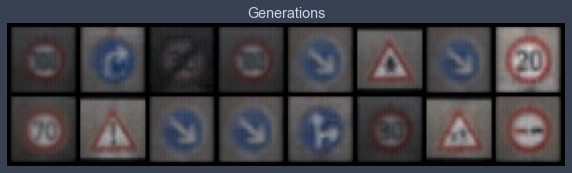

Epoch 76 loss 16419.663475220146, test L1 = 0.6940254978835583
Epoch 77 loss 8982.677905525128, test L1 = 0.711200475692749
Epoch 78 loss 8831.391708950816, test L1 = 0.7066298350691795
Epoch 79 loss 29739.388869872208, test L1 = 0.709980770945549






~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=512 | LR=0.0001
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Epoch 0 loss 45.392532295377805, test L1 = 0.8595508225262165
test_fixed_labels=tensor([21, 23, 31,  7, 17,  7,  3, 25, 10, 17, 14, 34, 38, 38, 41, 10],
       device='cuda:0')


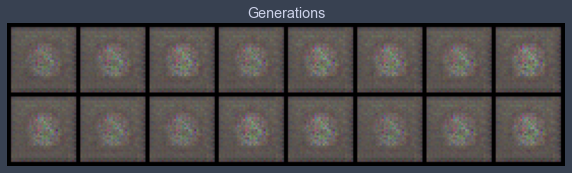

Epoch 1 loss 4.233637488584748, test L1 = 0.8239648230373859
Epoch 2 loss 2.33449131885345, test L1 = 0.7902372181415558
Epoch 3 loss 1.6952231684091574, test L1 = 0.7664533704519272
Epoch 4 loss 1.3262676086622416, test L1 = 0.7542328797280788
Epoch 5 loss 1.113220809251582, test L1 = 0.7529895789921284
test_fixed_labels=tensor([21, 23, 31,  7, 17,  7,  3, 25, 10, 17, 14, 34, 38, 38, 41, 10],
       device='cuda:0')


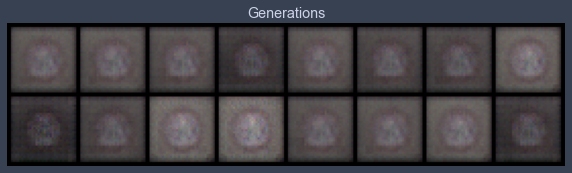

Epoch 6 loss 1.0146732844437931, test L1 = 0.7517988309264183
Epoch 7 loss 0.963211057522043, test L1 = 0.740922138094902
Epoch 8 loss 0.9426778235386327, test L1 = 0.7400012537837029
Epoch 9 loss 0.9258533171362074, test L1 = 0.73663629591465
Epoch 10 loss 0.9297734331019556, test L1 = 0.7423679605126381
test_fixed_labels=tensor([21, 23, 31,  7, 17,  7,  3, 25, 10, 17, 14, 34, 38, 38, 41, 10],
       device='cuda:0')


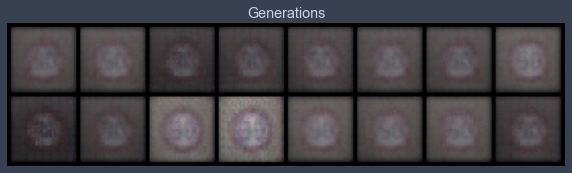

Epoch 11 loss 0.9144881382021298, test L1 = 0.7394140288233757
Epoch 12 loss 0.899136508248516, test L1 = 0.7414249740540981
Epoch 13 loss 0.8943826646329611, test L1 = 0.7380375675857067
Epoch 14 loss 0.8911039411407156, test L1 = 0.7386188805103302
Epoch 15 loss 0.887766386430288, test L1 = 0.7352791242301464
test_fixed_labels=tensor([21, 23, 31,  7, 17,  7,  3, 25, 10, 17, 14, 34, 38, 38, 41, 10],
       device='cuda:0')


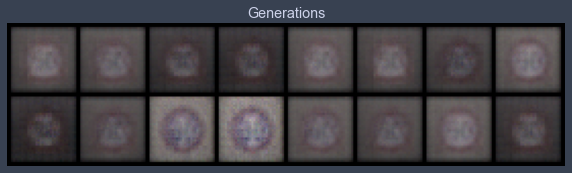

Epoch 16 loss 0.8851073863580055, test L1 = 0.7323346845805645
Epoch 17 loss 0.8868171085197082, test L1 = 0.737383272498846
Epoch 18 loss 0.8831947312731923, test L1 = 0.7363974079489708
Epoch 19 loss 0.8810018006059313, test L1 = 0.729290246963501
Epoch 20 loss 0.8810009323444563, test L1 = 0.7352704145014286
test_fixed_labels=tensor([21, 23, 31,  7, 17,  7,  3, 25, 10, 17, 14, 34, 38, 38, 41, 10],
       device='cuda:0')


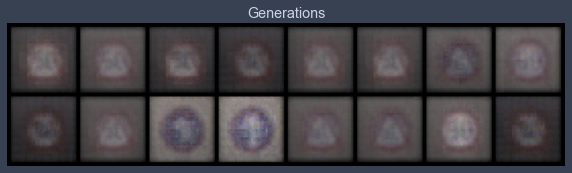

Epoch 21 loss 0.8796824204553034, test L1 = 0.7317162677645683
Epoch 22 loss 0.8781048903350568, test L1 = 0.7283863089978695
Epoch 23 loss 0.8770753489327185, test L1 = 0.736016321927309
Epoch 24 loss 0.8761012914664147, test L1 = 0.7306573837995529
Epoch 25 loss 0.8780252257573236, test L1 = 0.7330667302012444
test_fixed_labels=tensor([21, 23, 31,  7, 17,  7,  3, 25, 10, 17, 14, 34, 38, 38, 41, 10],
       device='cuda:0')


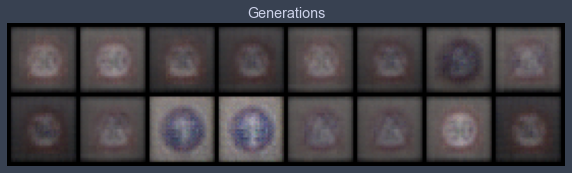

Epoch 26 loss 0.8758607582537988, test L1 = 0.7327778823673725
Epoch 27 loss 0.8757966381987345, test L1 = 0.7308061309158802
Epoch 28 loss 0.871098060583331, test L1 = 0.7271661348640919
Epoch 29 loss 0.8691923468792971, test L1 = 0.7282262332737446
Epoch 30 loss 0.8675575325988822, test L1 = 0.727232214063406
test_fixed_labels=tensor([21, 23, 31,  7, 17,  7,  3, 25, 10, 17, 14, 34, 38, 38, 41, 10],
       device='cuda:0')


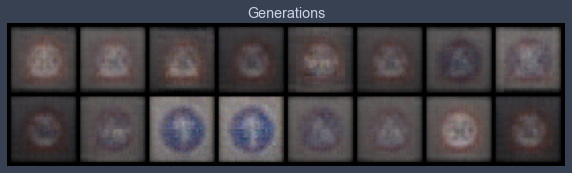

Epoch 31 loss 0.8660229110635843, test L1 = 0.7249831892549992
Epoch 32 loss 0.8660797870036253, test L1 = 0.7246874757111073
Epoch 33 loss 0.8647978764629036, test L1 = 0.7324631363153458
Epoch 34 loss 0.8637189166652378, test L1 = 0.722205400466919


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 0.861941591980531, test L1 = 0.7221303395926952
test_fixed_labels=tensor([21, 23, 31,  7, 17,  7,  3, 25, 10, 17, 14, 34, 38, 38, 41, 10],
       device='cuda:0')


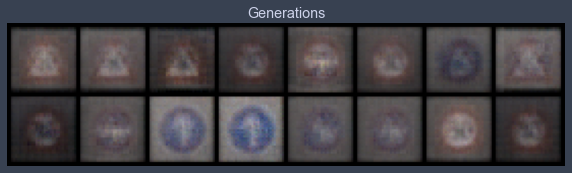

Epoch 36 loss 0.8616867450504369, test L1 = 0.7279906794428825
Epoch 37 loss 0.8625099407028907, test L1 = 0.7216827385127544
Epoch 38 loss 0.8597802743059663, test L1 = 0.7182301841676235
Epoch 39 loss 0.8589800487678895, test L1 = 0.7199455238878727


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 0.8571964643665195, test L1 = 0.7180332988500595
test_fixed_labels=tensor([21, 23, 31,  7, 17,  7,  3, 25, 10, 17, 14, 34, 38, 38, 41, 10],
       device='cuda:0')


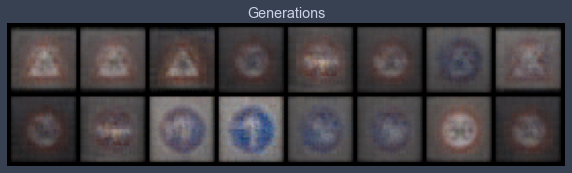

Epoch 41 loss 0.8564214384842574, test L1 = 0.719185758382082
Epoch 42 loss 0.8556584500774895, test L1 = 0.7220819257199764
Epoch 43 loss 0.8549677875033769, test L1 = 0.7208385802805424
Epoch 44 loss 0.8537420202366675, test L1 = 0.7141941525042057


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 0.8531496180701501, test L1 = 0.7140143141150475
test_fixed_labels=tensor([21, 23, 31,  7, 17,  7,  3, 25, 10, 17, 14, 34, 38, 38, 41, 10],
       device='cuda:0')


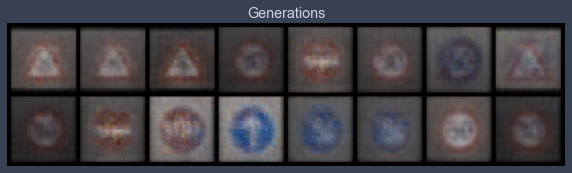

Epoch 46 loss 0.8522316026933414, test L1 = 0.7175465598702431
Epoch 47 loss 0.8523018523999506, test L1 = 0.7166940867900848
Epoch 48 loss 0.8527924051809147, test L1 = 0.7164952456951141
Epoch 49 loss 0.8507311026664943, test L1 = 0.7141810022294521


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 50 loss 0.8494837214446969, test L1 = 0.717226903885603
test_fixed_labels=tensor([21, 23, 31,  7, 17,  7,  3, 25, 10, 17, 14, 34, 38, 38, 41, 10],
       device='cuda:0')


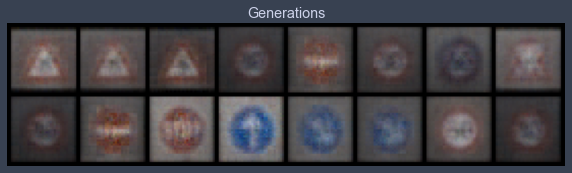

Epoch 51 loss 0.8492319561361857, test L1 = 0.7198187075555325
Epoch 52 loss 0.8488455074759284, test L1 = 0.7150094173848629
Epoch 53 loss 0.8482350053656142, test L1 = 0.7169774882495403
Epoch 54 loss 0.8478857967042431, test L1 = 0.7129574939608574


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 55 loss 0.8474000680077937, test L1 = 0.7162721417844296
test_fixed_labels=tensor([21, 23, 31,  7, 17,  7,  3, 25, 10, 17, 14, 34, 38, 38, 41, 10],
       device='cuda:0')


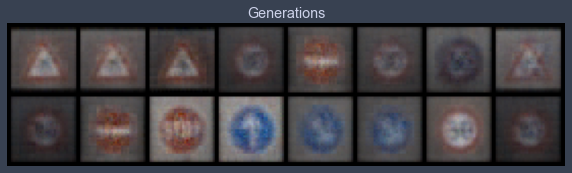

Epoch 56 loss 0.8478443452582736, test L1 = 0.7157517224550247
Epoch 57 loss 0.8470900128387504, test L1 = 0.7192468382418156
Epoch 58 loss 0.8472307082713675, test L1 = 0.716410968452692
Epoch 59 loss 0.84671774332466, test L1 = 0.7154611125588417
Epoch 60 loss 0.8457927431437567, test L1 = 0.7126043476164341
test_fixed_labels=tensor([21, 23, 31,  7, 17,  7,  3, 25, 10, 17, 14, 34, 38, 38, 41, 10],
       device='cuda:0')


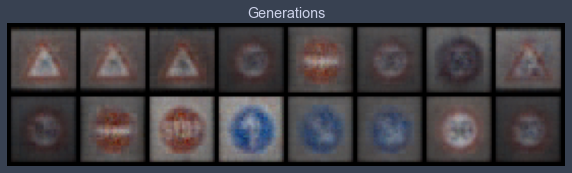

Epoch 61 loss 0.8459656156625125, test L1 = 0.7087219879031181
Epoch 62 loss 0.8456242987790059, test L1 = 0.7185595519840717
Epoch 63 loss 0.8452913490767332, test L1 = 0.7168017216026783
Epoch 64 loss 0.8450623836713967, test L1 = 0.7165080532431602


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 65 loss 0.8443397523201618, test L1 = 0.712325181812048
test_fixed_labels=tensor([21, 23, 31,  7, 17,  7,  3, 25, 10, 17, 14, 34, 38, 38, 41, 10],
       device='cuda:0')


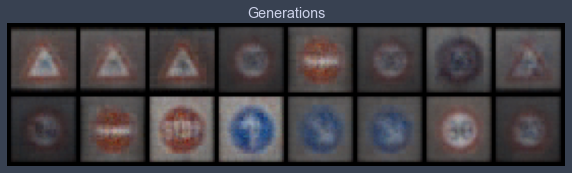

Epoch 66 loss 0.8449039999971685, test L1 = 0.7115750834345818
Epoch 67 loss 0.8444596445027905, test L1 = 0.7130111828446388
Epoch 68 loss 0.8436008888421599, test L1 = 0.7115854807198048
Epoch 69 loss 0.8437527690556451, test L1 = 0.7129144296050072
Epoch 70 loss 0.8433611454422941, test L1 = 0.7150419652462006
test_fixed_labels=tensor([21, 23, 31,  7, 17,  7,  3, 25, 10, 17, 14, 34, 38, 38, 41, 10],
       device='cuda:0')


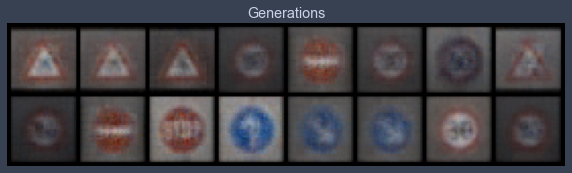

Epoch 71 loss 0.8433398762109763, test L1 = 0.7115039899945259
Epoch 72 loss 0.843525776953222, test L1 = 0.7134049944579601
Epoch 73 loss 0.8431926035799112, test L1 = 0.7121797502040863
Epoch 74 loss 0.8425785346129506, test L1 = 0.7146417051553726


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 75 loss 0.8420841478809868, test L1 = 0.7136423848569393
test_fixed_labels=tensor([21, 23, 31,  7, 17,  7,  3, 25, 10, 17, 14, 34, 38, 38, 41, 10],
       device='cuda:0')


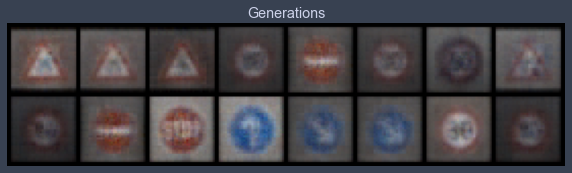

Epoch 76 loss 0.8427848379636548, test L1 = 0.714531421661377
Epoch 77 loss 0.8421768593214631, test L1 = 0.7098512127995491
Epoch 78 loss 0.8420873571097646, test L1 = 0.7083238326013088
Epoch 79 loss 0.8416727316338581, test L1 = 0.7112364619970322






~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=512 | LR=0.001
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Epoch 0 loss 60.856435744213485, test L1 = 0.7658237852156162
test_fixed_labels=tensor([20, 38, 35,  5, 40,  5,  7, 17,  4,  2, 25, 12, 13, 21, 11, 23],
       device='cuda:0')


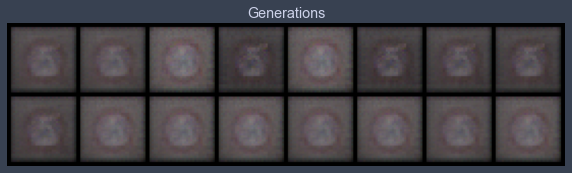

Epoch 1 loss 0.9863731340854028, test L1 = 0.7483186423778534
Epoch 2 loss 0.9084122649992454, test L1 = 0.7458124570548534
Epoch 3 loss 0.8971564669379664, test L1 = 0.7402550503611565
Epoch 4 loss 0.8911811776996887, test L1 = 0.7384042404592037
Epoch 5 loss 0.8849841425918632, test L1 = 0.7347138039767742
test_fixed_labels=tensor([20, 38, 35,  5, 40,  5,  7, 17,  4,  2, 25, 12, 13, 21, 11, 23],
       device='cuda:0')


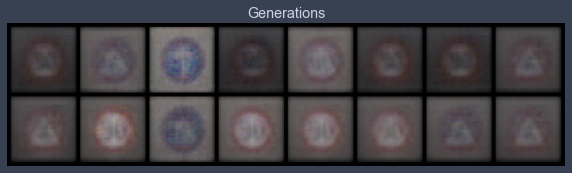

Epoch 6 loss 0.8804377710696348, test L1 = 0.7306309826672077
Epoch 7 loss 0.8751588312211315, test L1 = 0.7257849536836147
Epoch 8 loss 0.8695850519789863, test L1 = 0.7270975671708584
Epoch 9 loss 0.8628848762446663, test L1 = 0.7230424210429192
Epoch 10 loss 0.8584114917365137, test L1 = 0.7269195206463337
test_fixed_labels=tensor([20, 38, 35,  5, 40,  5,  7, 17,  4,  2, 25, 12, 13, 21, 11, 23],
       device='cuda:0')


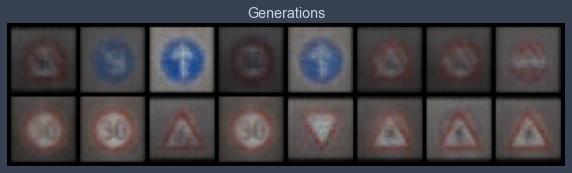

Epoch 11 loss 0.8554975593212953, test L1 = 0.7196725681424141
Epoch 12 loss 0.8536903239607402, test L1 = 0.7216763272881508
Epoch 13 loss 0.8515614779134796, test L1 = 0.7158758416771889
Epoch 14 loss 0.8496375905279442, test L1 = 0.7164928466081619
Epoch 15 loss 0.8476371035952748, test L1 = 0.7147955670952797
test_fixed_labels=tensor([20, 38, 35,  5, 40,  5,  7, 17,  4,  2, 25, 12, 13, 21, 11, 23],
       device='cuda:0')


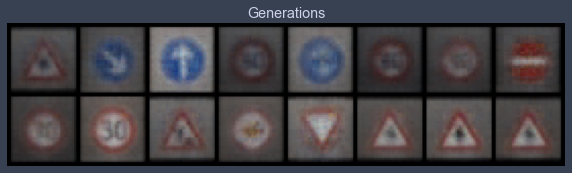

Epoch 16 loss 0.8475516100519711, test L1 = 0.7149502784013748
Epoch 17 loss 0.846276123089479, test L1 = 0.7121697030961514
Epoch 18 loss 0.8448548212493818, test L1 = 0.709768284112215
Epoch 19 loss 0.8448020141968613, test L1 = 0.7166164591908455
Epoch 20 loss 0.8431481501900453, test L1 = 0.7143561318516731
test_fixed_labels=tensor([20, 38, 35,  5, 40,  5,  7, 17,  4,  2, 25, 12, 13, 21, 11, 23],
       device='cuda:0')


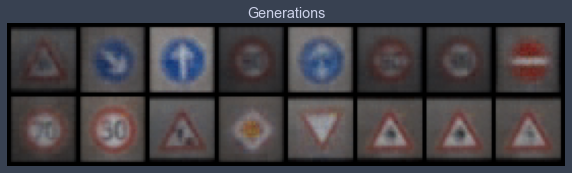

Epoch 21 loss 0.8421992262204488, test L1 = 0.7113769352436066
Epoch 22 loss 0.8424234547975546, test L1 = 0.7124663032591343
Epoch 23 loss 0.841183553651436, test L1 = 0.712938267737627
Epoch 24 loss 0.8411235424251491, test L1 = 0.7114501819014549
Epoch 25 loss 0.8399070679526968, test L1 = 0.7074911296367645
test_fixed_labels=tensor([20, 38, 35,  5, 40,  5,  7, 17,  4,  2, 25, 12, 13, 21, 11, 23],
       device='cuda:0')


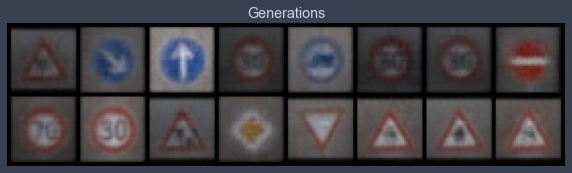

Epoch 26 loss 0.8401436244499233, test L1 = 0.712138082832098
Epoch 27 loss 0.8398203739185923, test L1 = 0.7107411697506905
Epoch 28 loss 0.8394218554201814, test L1 = 0.7111280746757984
Epoch 29 loss 0.8408154568721339, test L1 = 0.7151626199483871
Epoch 30 loss 0.8379555670256468, test L1 = 0.7130883149802685
test_fixed_labels=tensor([20, 38, 35,  5, 40,  5,  7, 17,  4,  2, 25, 12, 13, 21, 11, 23],
       device='cuda:0')


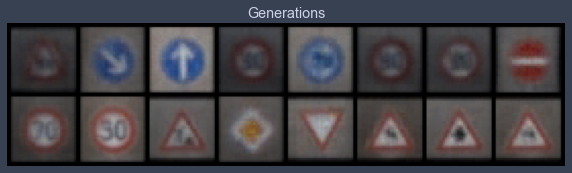

Epoch 31 loss 0.838039941599279, test L1 = 0.7112341150641441
Epoch 32 loss 0.838296841919627, test L1 = 0.708200816065073
Epoch 33 loss 0.8380138839233372, test L1 = 0.7070229090750217
Epoch 34 loss 0.8381183757814755, test L1 = 0.7083185091614723
Epoch 35 loss 0.8377072850043831, test L1 = 0.7108492627739906
test_fixed_labels=tensor([20, 38, 35,  5, 40,  5,  7, 17,  4,  2, 25, 12, 13, 21, 11, 23],
       device='cuda:0')


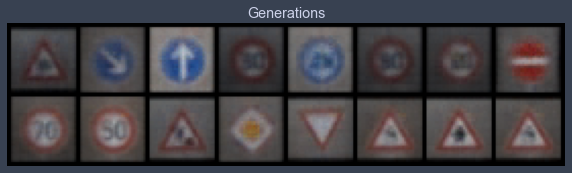

Epoch 36 loss 0.8376594337401112, test L1 = 0.7115472294390202
Epoch 37 loss 0.8371511804279184, test L1 = 0.7078578025102615
Epoch 38 loss 0.8369251559280448, test L1 = 0.7131636403501034
Epoch 39 loss 236.93252929420404, test L1 = 0.7096698209643364


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 62170.2104651592, test L1 = 0.7076493799686432
test_fixed_labels=tensor([20, 38, 35,  5, 40,  5,  7, 17,  4,  2, 25, 12, 13, 21, 11, 23],
       device='cuda:0')


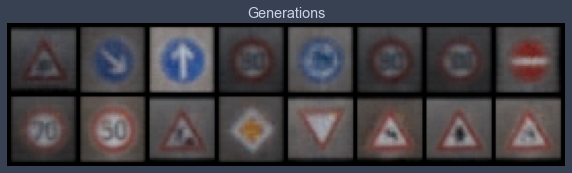

Epoch 41 loss 158.32025082496435, test L1 = 0.7052547447383404
Epoch 42 loss 26.369727489260054, test L1 = 0.7087202183902264
Epoch 43 loss 14.83085712104319, test L1 = 0.7051265947520733
Epoch 44 loss 11.075801450976801, test L1 = 0.7078217230737209
Epoch 45 loss 7.225670373521719, test L1 = 0.7074242308735847
test_fixed_labels=tensor([20, 38, 35,  5, 40,  5,  7, 17,  4,  2, 25, 12, 13, 21, 11, 23],
       device='cuda:0')


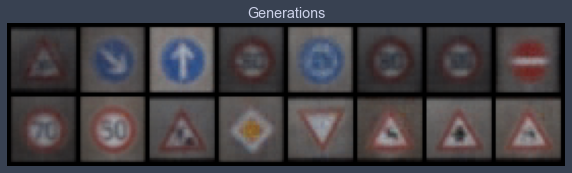

Epoch 46 loss 7.778373649235034, test L1 = 0.7046124264597893
Epoch 47 loss 6.014173371685329, test L1 = 0.7124288752675056
Epoch 48 loss 4.762025625845001, test L1 = 0.7072262577712536
Epoch 49 loss 3.9936427107381656, test L1 = 0.7100779227912426
Epoch 50 loss 6.000497978167846, test L1 = 0.7068643495440483
test_fixed_labels=tensor([20, 38, 35,  5, 40,  5,  7, 17,  4,  2, 25, 12, 13, 21, 11, 23],
       device='cuda:0')


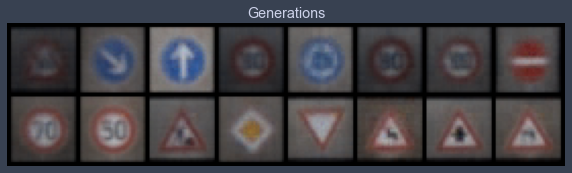

Epoch 51 loss 4.238521200275094, test L1 = 0.7140419520437717
Epoch 52 loss 3.965669466252999, test L1 = 0.7096482366323471
Epoch 53 loss 29.582786731498757, test L1 = 0.70758206397295
Epoch 54 loss 20.84363934592283, test L1 = 0.7114057131111622


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 55 loss 4.222347879123032, test L1 = 0.7075558193027973
test_fixed_labels=tensor([20, 38, 35,  5, 40,  5,  7, 17,  4,  2, 25, 12, 13, 21, 11, 23],
       device='cuda:0')


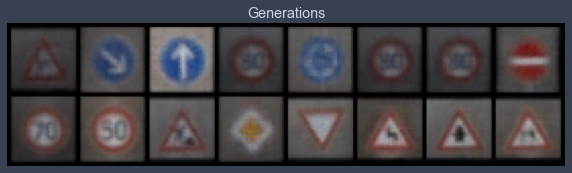

Epoch 56 loss 1.4780633629802167, test L1 = 0.7056610360741615
Epoch 57 loss 1.3376417706922157, test L1 = 0.7078013196587563
Epoch 58 loss 1.1152358194397078, test L1 = 0.7060943692922592
Epoch 59 loss 1.5437020782342892, test L1 = 0.7026147246360779


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 60 loss 1.0759370877980368, test L1 = 0.707834605127573
test_fixed_labels=tensor([20, 38, 35,  5, 40,  5,  7, 17,  4,  2, 25, 12, 13, 21, 11, 23],
       device='cuda:0')


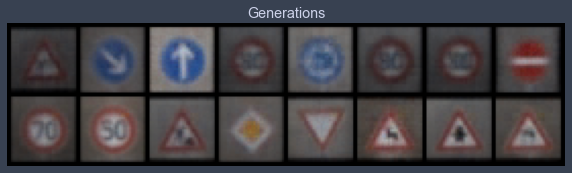

Epoch 61 loss 0.9908060593293705, test L1 = 0.7079868279397488
Epoch 62 loss 0.9379657414770618, test L1 = 0.7117657214403152
Epoch 63 loss 0.9396419965524444, test L1 = 0.7105821073055267
Epoch 64 loss 0.9129044339828885, test L1 = 0.7037938795983791


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 65 loss 0.9986677995252445, test L1 = 0.7062410078942776
test_fixed_labels=tensor([20, 38, 35,  5, 40,  5,  7, 17,  4,  2, 25, 12, 13, 21, 11, 23],
       device='cuda:0')


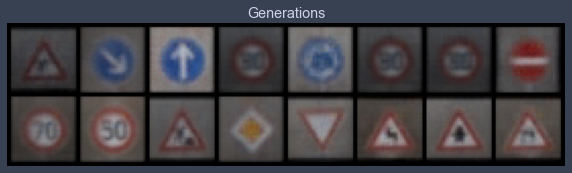

Epoch 66 loss 0.8553272135478934, test L1 = 0.7087262906134129
Epoch 67 loss 0.890842216121372, test L1 = 0.7050457447767258
Epoch 68 loss 0.8691447686493602, test L1 = 0.7064598463475704
Epoch 69 loss 0.8654896340419337, test L1 = 0.7074043899774551
Epoch 70 loss 0.8782800007931555, test L1 = 0.7080797217786312
test_fixed_labels=tensor([20, 38, 35,  5, 40,  5,  7, 17,  4,  2, 25, 12, 13, 21, 11, 23],
       device='cuda:0')


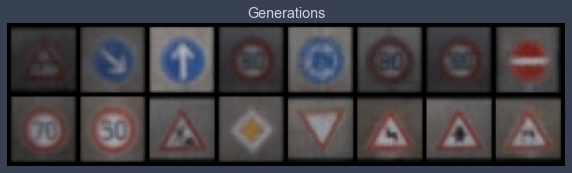

Epoch 71 loss 0.8733559742416304, test L1 = 0.705916952341795
Epoch 72 loss 0.9437328349683702, test L1 = 0.7055161669850349
Epoch 73 loss 0.8409806748026425, test L1 = 0.7095166482031345
Epoch 74 loss 0.8500923745820612, test L1 = 0.7029139436781406


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 75 loss 0.8363309494408545, test L1 = 0.7075854688882828
test_fixed_labels=tensor([20, 38, 35,  5, 40,  5,  7, 17,  4,  2, 25, 12, 13, 21, 11, 23],
       device='cuda:0')


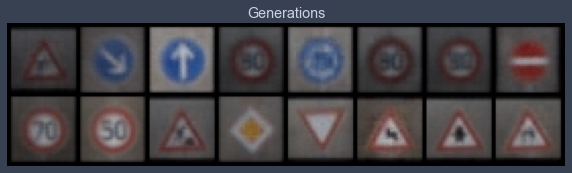

Epoch 76 loss 0.8350791830787134, test L1 = 0.7100570574402809
Epoch 77 loss 0.8375683738193971, test L1 = 0.7066099047660828
Epoch 78 loss 0.8349947532018026, test L1 = 0.7063278704881668
Epoch 79 loss 0.8349264133017498, test L1 = 0.7039761692285538






~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=512 | LR=0.01
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Epoch 0 loss 63054961.58974999, test L1 = 0.6875261887907982
test_fixed_labels=tensor([ 8, 18,  5, 25, 13,  4, 22,  2,  8, 30, 29, 11, 12, 35, 38,  3],
       device='cuda:0')


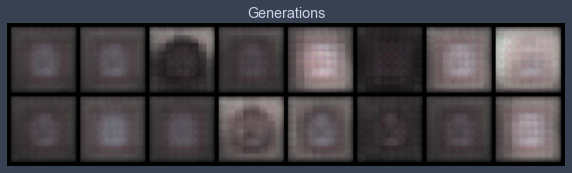

Epoch 1 loss 14474.378604220361, test L1 = 0.713335432112217
Epoch 2 loss 6117.297357408452, test L1 = 0.722472433000803
Epoch 3 loss 4910.154517104946, test L1 = 0.7346098385751247
Epoch 4 loss 2948.451255562379, test L1 = 0.7280311696231365
Epoch 5 loss 2238.9942908008484, test L1 = 0.7193021737039089
test_fixed_labels=tensor([ 8, 18,  5, 25, 13,  4, 22,  2,  8, 30, 29, 11, 12, 35, 38,  3],
       device='cuda:0')


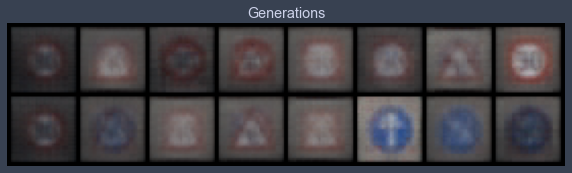

Epoch 6 loss 1822.599393130168, test L1 = 0.7280835509300232
Epoch 7 loss 1559.9923090983912, test L1 = 0.7227353230118752
Epoch 8 loss 6204.872201742585, test L1 = 0.7153930030763149
Epoch 9 loss 1246.3441892276514, test L1 = 0.7258674241602421
Epoch 10 loss 354.8806445000508, test L1 = 0.7132805287837982
test_fixed_labels=tensor([ 8, 18,  5, 25, 13,  4, 22,  2,  8, 30, 29, 11, 12, 35, 38,  3],
       device='cuda:0')


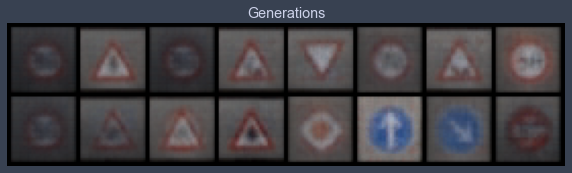

Epoch 11 loss 246.05698546675063, test L1 = 0.717632457613945
Epoch 12 loss 178.53625817479136, test L1 = 0.7076147757470608
Epoch 13 loss 126.20710344453857, test L1 = 0.719909131526947
Epoch 14 loss 128.5763134608154, test L1 = 0.7232589945197105
Epoch 15 loss 84.88681072344895, test L1 = 0.7068844102323055
test_fixed_labels=tensor([ 8, 18,  5, 25, 13,  4, 22,  2,  8, 30, 29, 11, 12, 35, 38,  3],
       device='cuda:0')


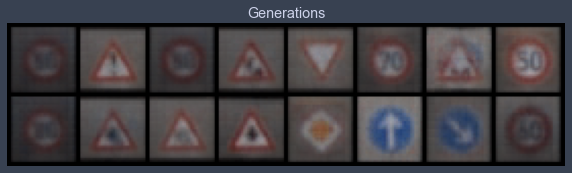

Epoch 16 loss 74.8730469950286, test L1 = 0.71585538610816
Epoch 17 loss 71.76175208804534, test L1 = 0.7133729197084904
Epoch 18 loss 58.536453687038616, test L1 = 0.7154330648481846
Epoch 19 loss 45.90142514554086, test L1 = 0.7122395858168602
Epoch 20 loss 49.98511711449148, test L1 = 0.709103737026453
test_fixed_labels=tensor([ 8, 18,  5, 25, 13,  4, 22,  2,  8, 30, 29, 11, 12, 35, 38,  3],
       device='cuda:0')


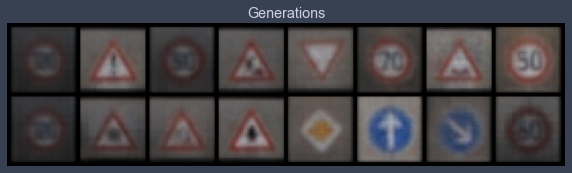

Epoch 21 loss 30.497007285811236, test L1 = 0.7079168371856213
Epoch 22 loss 20.35403501270563, test L1 = 0.7052037678658962
Epoch 23 loss 57.85462813360994, test L1 = 0.7176543287932873
Epoch 24 loss 14.761667150607224, test L1 = 0.7091949917376041
Epoch 25 loss 10.373642189601034, test L1 = 0.7012798003852367
test_fixed_labels=tensor([ 8, 18,  5, 25, 13,  4, 22,  2,  8, 30, 29, 11, 12, 35, 38,  3],
       device='cuda:0')


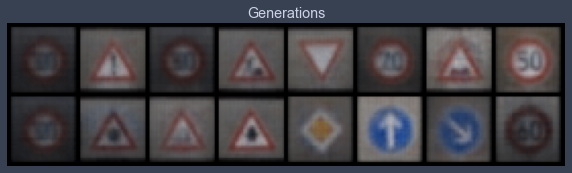

Epoch 26 loss 11.637881689260096, test L1 = 0.719587005674839
Epoch 27 loss 8.065701937757407, test L1 = 0.6991928443312645
Epoch 28 loss 5.949831815314867, test L1 = 0.7081644348800182
Epoch 29 loss 6.849904237129434, test L1 = 0.7148538529872894
Epoch 30 loss 7.65097655156224, test L1 = 0.7018156982958317
test_fixed_labels=tensor([ 8, 18,  5, 25, 13,  4, 22,  2,  8, 30, 29, 11, 12, 35, 38,  3],
       device='cuda:0')


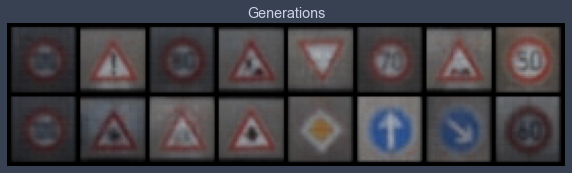

Epoch 31 loss 4.788500695908602, test L1 = 0.7130053006112576
Epoch 32 loss 4.445086748739288, test L1 = 0.703597903251648
Epoch 33 loss 9.384784101210919, test L1 = 0.710896871984005
Epoch 34 loss 5.304439823856878, test L1 = 0.712666716426611
Epoch 35 loss 3.915158050166782, test L1 = 0.7131142467260361
test_fixed_labels=tensor([ 8, 18,  5, 25, 13,  4, 22,  2,  8, 30, 29, 11, 12, 35, 38,  3],
       device='cuda:0')


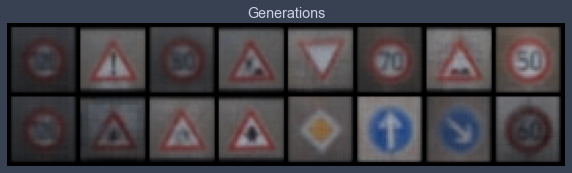

Epoch 36 loss 2.790777793045306, test L1 = 0.7041848711669445
Epoch 37 loss 1.5504216131885438, test L1 = 0.7012328021228313
Epoch 38 loss 5.0347610466259045, test L1 = 0.7153577655553818
Epoch 39 loss 5.919726599942368, test L1 = 0.7183501608669758


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 40 loss 4.552840281802764, test L1 = 0.7075990848243237
test_fixed_labels=tensor([ 8, 18,  5, 25, 13,  4, 22,  2,  8, 30, 29, 11, 12, 35, 38,  3],
       device='cuda:0')


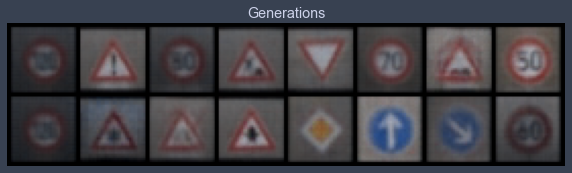

Epoch 41 loss 1.4193199213427776, test L1 = 0.7065222077071667
Epoch 42 loss 2.6198404644363116, test L1 = 0.7161180302500725
Epoch 43 loss 1.4083165620610476, test L1 = 0.7120280414819717
Epoch 44 loss 0.9206648907300943, test L1 = 0.7080926932394505
Epoch 45 loss 1.390421279312409, test L1 = 0.7027038410305977
test_fixed_labels=tensor([ 8, 18,  5, 25, 13,  4, 22,  2,  8, 30, 29, 11, 12, 35, 38,  3],
       device='cuda:0')


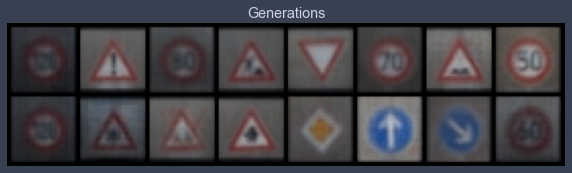

Epoch 46 loss 0.9203568088639643, test L1 = 0.7111611813306808
Epoch 47 loss 1.0459836463338321, test L1 = 0.7097734957933426
Epoch 48 loss 0.9685434651948333, test L1 = 0.7035862952470779
Epoch 49 loss 2.3658595396481017, test L1 = 0.7068575322628021
Epoch 50 loss 6.338860498466033, test L1 = 0.7031609080731869
test_fixed_labels=tensor([ 8, 18,  5, 25, 13,  4, 22,  2,  8, 30, 29, 11, 12, 35, 38,  3],
       device='cuda:0')


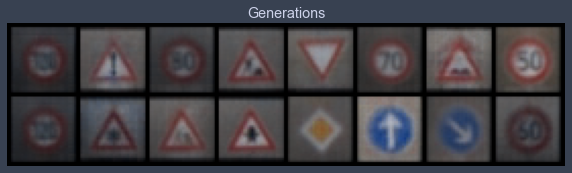

Epoch 51 loss 9962129123.385424, test L1 = 0.693794246762991
Epoch 52 loss 419069.0125510094, test L1 = 0.6877957321703434
Epoch 53 loss 352475.3617778136, test L1 = 0.6922090500593185
Epoch 54 loss 87286.55517745919, test L1 = 0.6838794350624084
Epoch 55 loss 75780.4360569695, test L1 = 0.6749333254992962
test_fixed_labels=tensor([ 8, 18,  5, 25, 13,  4, 22,  2,  8, 30, 29, 11, 12, 35, 38,  3],
       device='cuda:0')


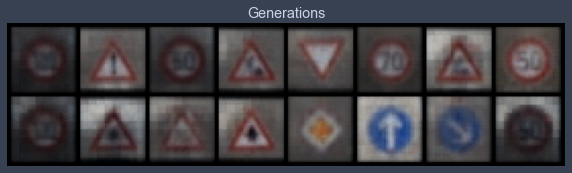

Epoch 56 loss 31219.610589830325, test L1 = 0.6762280240654945
Epoch 57 loss 28273.26465514927, test L1 = 0.6803242936730385
Epoch 58 loss 21160.69183915915, test L1 = 0.6823295839130878
Epoch 59 loss 60146.44003704897, test L1 = 0.6843185238540173


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 60 loss 23760.75651377255, test L1 = 0.6865625791251659
test_fixed_labels=tensor([ 8, 18,  5, 25, 13,  4, 22,  2,  8, 30, 29, 11, 12, 35, 38,  3],
       device='cuda:0')


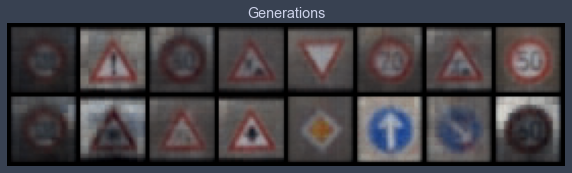

Epoch 61 loss 25191.434915968643, test L1 = 0.681839507073164
Epoch 62 loss 80209.5616576729, test L1 = 0.6795665174722672
Epoch 63 loss 16384.690859240764, test L1 = 0.6845437362790108
Epoch 64 loss 14801.028796848153, test L1 = 0.6827899403870106


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 65 loss 148236.60801586663, test L1 = 0.6729698851704597
test_fixed_labels=tensor([ 8, 18,  5, 25, 13,  4, 22,  2,  8, 30, 29, 11, 12, 35, 38,  3],
       device='cuda:0')


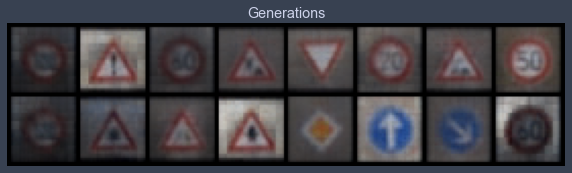

Epoch 66 loss 11865.393943970146, test L1 = 0.6797221787273884
Epoch 67 loss 12581.595599092569, test L1 = 0.6817695945501328
Epoch 68 loss 11419.146823319374, test L1 = 0.6767387129366398
Epoch 69 loss 11124.291925069803, test L1 = 0.6802797205746174
Epoch 70 loss 10935.952282672895, test L1 = 0.6767983213067055
test_fixed_labels=tensor([ 8, 18,  5, 25, 13,  4, 22,  2,  8, 30, 29, 11, 12, 35, 38,  3],
       device='cuda:0')


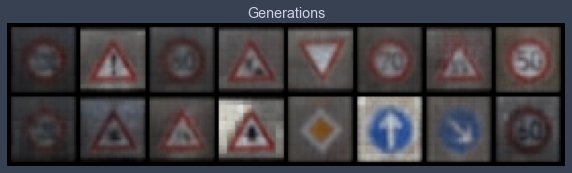

Epoch 71 loss 11057.112445634664, test L1 = 0.6819960251450539
Epoch 72 loss 10608.885993878866, test L1 = 0.6816505305469036
Epoch 73 loss 10388.1223589186, test L1 = 0.6786345355212688
Epoch 74 loss 9945.229052566581, test L1 = 0.6815149150788784


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 75 loss 11499.472975059063, test L1 = 0.679383996874094
test_fixed_labels=tensor([ 8, 18,  5, 25, 13,  4, 22,  2,  8, 30, 29, 11, 12, 35, 38,  3],
       device='cuda:0')


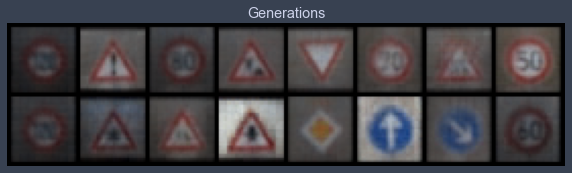

Epoch 76 loss 9605.006174828179, test L1 = 0.6769797466695309
Epoch 77 loss 9470.24399632195, test L1 = 0.6825103722512722
Epoch 78 loss 9284.146548136812, test L1 = 0.6869995258748531
Epoch 79 loss 19245.24891940507, test L1 = 0.6924152597784996






~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
LATENT SIZE=512 | LR=0.1
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Epoch 0 loss 7860753137165.498, test L1 = 0.7968683540821075
test_fixed_labels=tensor([11, 31,  9,  3,  3,  4,  9, 38, 25, 18,  3, 14, 25, 12,  2, 15],
       device='cuda:0')


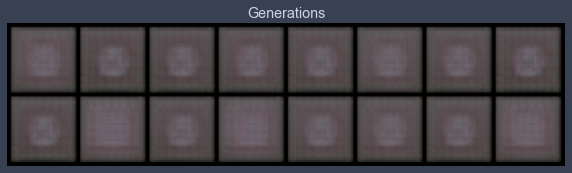

Epoch 1 loss 243865.61214024914, test L1 = 0.7574660331010818
Epoch 2 loss 999891.2315963273, test L1 = 0.7576482221484184
Epoch 3 loss 46871.577507517184, test L1 = 0.8063097074627876
Epoch 4 loss 43559.04063305412, test L1 = 0.7335640266537666
Epoch 5 loss 40809.654652598794, test L1 = 0.7476999387145042
test_fixed_labels=tensor([11, 31,  9,  3,  3,  4,  9, 38, 25, 18,  3, 14, 25, 12,  2, 15],
       device='cuda:0')


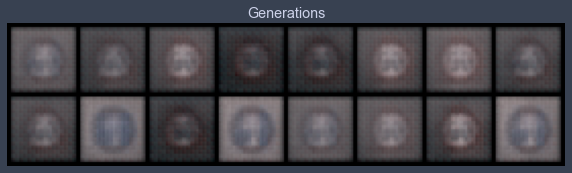

Epoch 6 loss 38554.94394329897, test L1 = 0.7085414901375771
Epoch 7 loss 36657.96760899914, test L1 = 0.7331034913659096
Epoch 8 loss 34949.82106421822, test L1 = 0.716010469943285
Epoch 9 loss 33329.991643846646, test L1 = 0.7327796556055546


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 10 loss 31767.72441473368, test L1 = 0.7180897109210491
test_fixed_labels=tensor([11, 31,  9,  3,  3,  4,  9, 38, 25, 18,  3, 14, 25, 12,  2, 15],
       device='cuda:0')


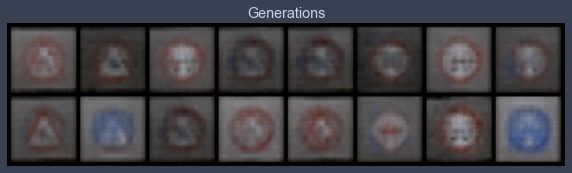

Epoch 11 loss 30202.377053801545, test L1 = 0.7281770445406437
Epoch 12 loss 28658.71229327749, test L1 = 0.6861479915678501
Epoch 13 loss 27154.407719877578, test L1 = 0.6922013200819492
Epoch 14 loss 25712.942184815292, test L1 = 0.7137679308652878


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 15 loss 24358.77769276203, test L1 = 0.7188826762139797
test_fixed_labels=tensor([11, 31,  9,  3,  3,  4,  9, 38, 25, 18,  3, 14, 25, 12,  2, 15],
       device='cuda:0')


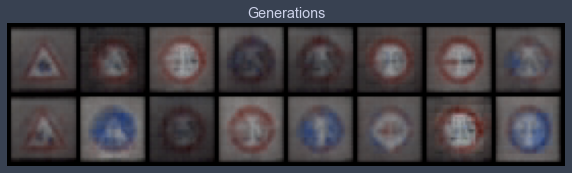

Epoch 16 loss 23114.40513584622, test L1 = 0.6958781480789185
Epoch 17 loss 21998.022685781787, test L1 = 0.7533284611999989
Epoch 18 loss 21021.647826728953, test L1 = 0.7183651365339756
Epoch 19 loss 20189.90131013746, test L1 = 0.7074452005326748


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 20 loss 19499.84100488617, test L1 = 0.7109866626560688
test_fixed_labels=tensor([11, 31,  9,  3,  3,  4,  9, 38, 25, 18,  3, 14, 25, 12,  2, 15],
       device='cuda:0')


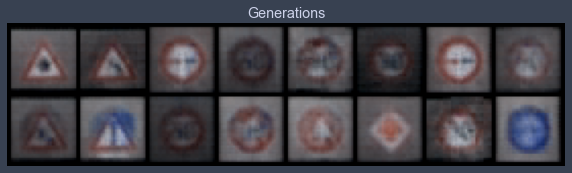

Epoch 21 loss 18942.026598743556, test L1 = 0.7033133246004581
Epoch 22 loss 18502.259362918816, test L1 = 0.719515971839428
Epoch 23 loss 18163.800606743986, test L1 = 0.6930589377880096
Epoch 24 loss 17909.377349119415, test L1 = 0.7117604948580265
Epoch 25 loss 17722.733079628437, test L1 = 0.7097795717418194
test_fixed_labels=tensor([11, 31,  9,  3,  3,  4,  9, 38, 25, 18,  3, 14, 25, 12,  2, 15],
       device='cuda:0')


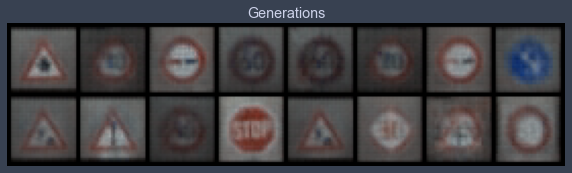

Epoch 26 loss 17589.453111576462, test L1 = 0.733940564095974
Epoch 27 loss 17497.248107280928, test L1 = 0.7236557826399803
Epoch 28 loss 17435.85348877792, test L1 = 0.7292907536029816
Epoch 29 loss 17396.84662263746, test L1 = 0.7045988105237484


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 30 loss 17373.416814325603, test L1 = 0.7269444838166237
test_fixed_labels=tensor([11, 31,  9,  3,  3,  4,  9, 38, 25, 18,  3, 14, 25, 12,  2, 15],
       device='cuda:0')


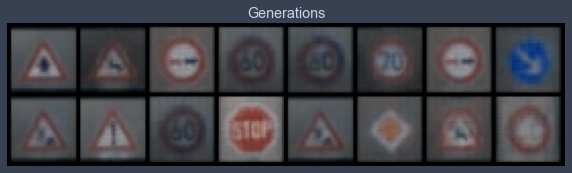

Epoch 31 loss 17360.254959997852, test L1 = 0.7166732288897038
Epoch 32 loss 17353.41414304124, test L1 = 0.6927047334611416
Epoch 33 loss 17350.16378060567, test L1 = 0.6972489804029465
Epoch 34 loss 17348.768464078606, test L1 = 0.7067682296037674


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 35 loss 17348.23695231959, test L1 = 0.7263398878276348
test_fixed_labels=tensor([11, 31,  9,  3,  3,  4,  9, 38, 25, 18,  3, 14, 25, 12,  2, 15],
       device='cuda:0')


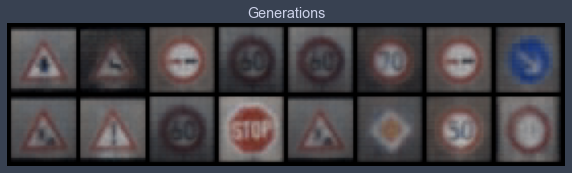

Epoch 36 loss 17348.057607119845, test L1 = 0.7066028080880642
Epoch 37 loss 17348.006597669675, test L1 = 0.710920974612236
Epoch 38 loss 17347.99385873067, test L1 = 0.7184424698352814
Epoch 39 loss 17347.989160491838, test L1 = 0.7164247073233128
Epoch 40 loss 17347.988395350087, test L1 = 0.7268988154828548
test_fixed_labels=tensor([11, 31,  9,  3,  3,  4,  9, 38, 25, 18,  3, 14, 25, 12,  2, 15],
       device='cuda:0')


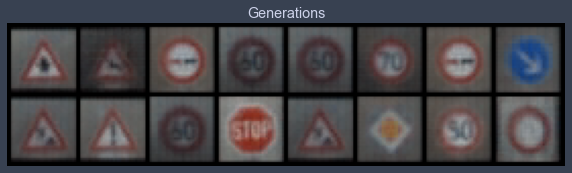

Epoch 41 loss 17347.98909337414, test L1 = 0.7288766838610172
Epoch 42 loss 17347.987603361253, test L1 = 0.7211811989545822
Epoch 43 loss 17347.989777974657, test L1 = 0.7018671706318855
Epoch 44 loss 17347.987751020188, test L1 = 0.7132285386323929


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 45 loss 17347.987589937715, test L1 = 0.7227318063378334
test_fixed_labels=tensor([11, 31,  9,  3,  3,  4,  9, 38, 25, 18,  3, 14, 25, 12,  2, 15],
       device='cuda:0')


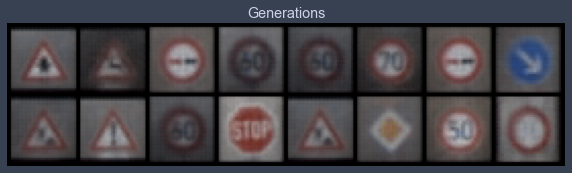

Epoch 46 loss 17347.989241033076, test L1 = 0.701818436384201
Epoch 47 loss 17347.98689191366, test L1 = 0.7107714228332043
Epoch 48 loss 17347.988355079466, test L1 = 0.7132719121873379
Epoch 49 loss 17347.985918707043, test L1 = 0.6962164118885994
Epoch 50 loss 17347.988730938574, test L1 = 0.7071107812225819
test_fixed_labels=tensor([11, 31,  9,  3,  3,  4,  9, 38, 25, 18,  3, 14, 25, 12,  2, 15],
       device='cuda:0')


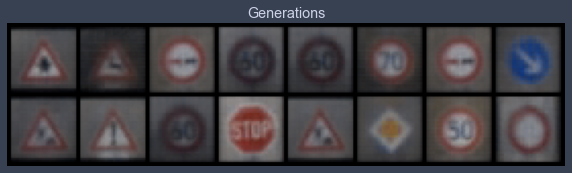

Epoch 51 loss 17347.987945661513, test L1 = 0.7364402562379837
Epoch 52 loss 17347.987079843213, test L1 = 0.7153571136295795
Epoch 53 loss 17347.98714024914, test L1 = 0.681864757090807
Epoch 54 loss 17347.986388530928, test L1 = 0.730207335203886
Epoch 55 loss 17347.984985771047, test L1 = 0.7067308127880096
test_fixed_labels=tensor([11, 31,  9,  3,  3,  4,  9, 38, 25, 18,  3, 14, 25, 12,  2, 15],
       device='cuda:0')


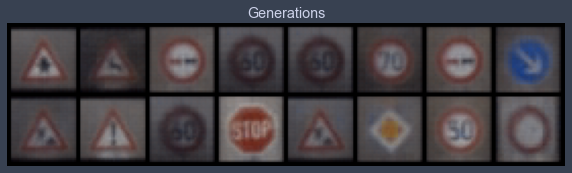

Epoch 56 loss 17347.985596542097, test L1 = 0.686729833483696
Epoch 57 loss 17347.984482388318, test L1 = 0.6886785626411438
Epoch 58 loss 17347.985328071307, test L1 = 0.6944649145007133
Epoch 59 loss 17347.98720065507, test L1 = 0.6919696256518364


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 60 loss 17347.986462360393, test L1 = 0.6960524246096611
test_fixed_labels=tensor([11, 31,  9,  3,  3,  4,  9, 38, 25, 18,  3, 14, 25, 12,  2, 15],
       device='cuda:0')


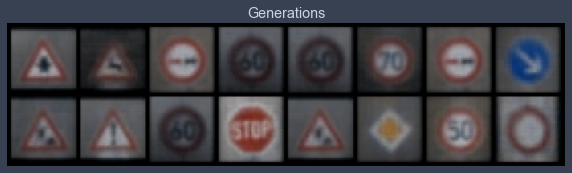

Epoch 61 loss 17347.983643417097, test L1 = 0.7037808410823345
Epoch 62 loss 53457.6462628866, test L1 = 0.6931755505502224
Epoch 63 loss 18310.91427727663, test L1 = 0.7066694870591164
Epoch 64 loss 17392.83560862328, test L1 = 0.7091123908758163


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 65 loss 17392.834675687285, test L1 = 0.7136309817433357
test_fixed_labels=tensor([11, 31,  9,  3,  3,  4,  9, 38, 25, 18,  3, 14, 25, 12,  2, 15],
       device='cuda:0')


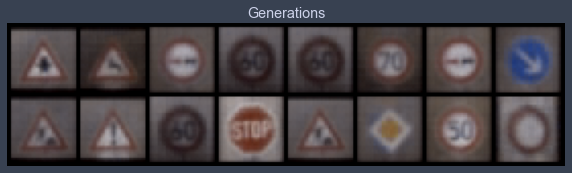

Epoch 66 loss 20162.746946144758, test L1 = 0.7549380026757717
Epoch 67 loss 17399.5857160116, test L1 = 0.7078952044248581
Epoch 68 loss 17392.83574285868, test L1 = 0.6966517232358456
Epoch 69 loss 31099.101602770617, test L1 = 0.7066932767629623


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 70 loss 17392.83419915163, test L1 = 0.6972723603248596
test_fixed_labels=tensor([11, 31,  9,  3,  3,  4,  9, 38, 25, 18,  3, 14, 25, 12,  2, 15],
       device='cuda:0')


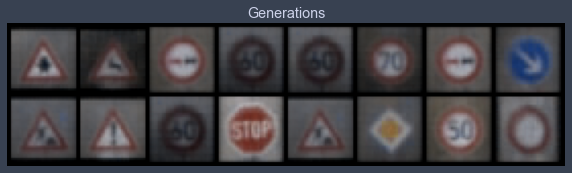

Epoch 71 loss 17392.835897229383, test L1 = 0.7130628302693367
Epoch 72 loss 17392.836655659365, test L1 = 0.6952833980321884
Epoch 73 loss 19253.37386571091, test L1 = 0.7068441286683083
Epoch 74 loss 19982.925096649484, test L1 = 0.7103394716978073


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Epoch 75 loss 18250.086655659365, test L1 = 0.7157250456511974
test_fixed_labels=tensor([11, 31,  9,  3,  3,  4,  9, 38, 25, 18,  3, 14, 25, 12,  2, 15],
       device='cuda:0')


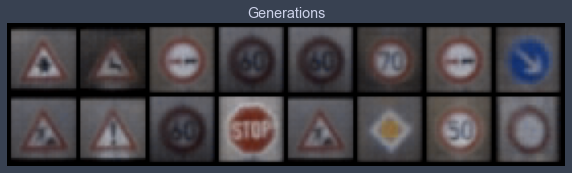

Epoch 76 loss 17392.835024699314, test L1 = 0.7068353928625584
Epoch 77 loss 21518.119798378437, test L1 = 0.6991326622664928
Epoch 78 loss 17392.83372261598, test L1 = 0.7035587690770626
Epoch 79 loss 19034.62089910868, test L1 = 0.6979721076786518








In [36]:
N_OF_CLASSESS = numb_classess
val_models2 = []
for val_latent_size, val_lr in h_params:
    val_signs_vae = SignsVAE(latent_dim=val_latent_size, classess_size=N_OF_CLASSESS).to(device)
    val_optimizer = optim.Adam(val_signs_vae.parameters(), lr=val_lr)
    val_scheduler = optim.lr_scheduler.ExponentialLR(optimizer=val_optimizer, gamma=0.99)
    val_fixed_noise = torch.randn(16, val_latent_size, device=device)
    val_fixed_labels = next(iter(train_loader))[1]
    val_fixed_labels = val_fixed_labels[:16].to(device)
    val_fixed_labels_one_hot = Functional.one_hot(val_fixed_labels, N_OF_CLASSESS).float()
    print("~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~")
    print(f"LATENT SIZE={val_latent_size} | LR={val_lr}")
    print("~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~")

    perform_vae_training_val2(vae_model=val_signs_vae, vae_optimizer=val_optimizer, vae_train_loader=val_train_loader,
                             vae_valid_loader=val_valid_loader, vae_scheduler=val_scheduler,
                             test_fixed_noise=val_fixed_noise, test_fixed_labels_one_hot=val_fixed_labels_one_hot,
                             test_fixed_labels=val_fixed_labels, num_epochs=80)

    print("\n" * 5)

    val_models2.append(val_signs_vae)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


val_fixed_labels=tensor([12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12,
        12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12,
        12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12,
        12, 12, 12, 12, 12, 12, 12, 12, 12, 12], device='cuda:0')


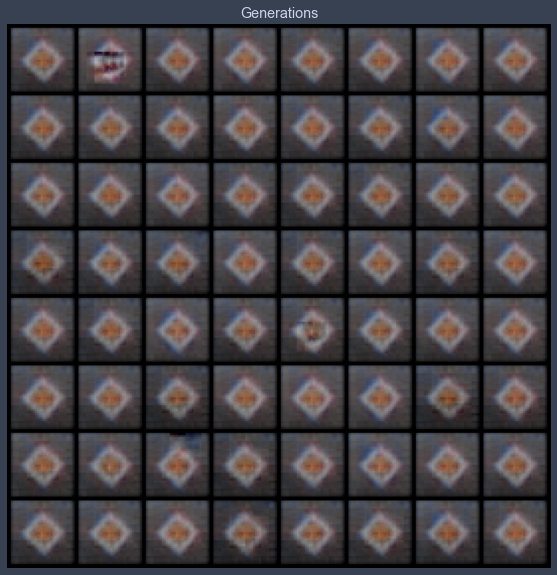

In [37]:
val_latent_size = 64
val_fixed_noise = torch.randn(64, val_latent_size, device=device)
# val_fixed_labels = next(iter(train_loader))[1]
val_fixed_labels = torch.ones_like(next(iter(train_loader))[1]) * 12
val_fixed_labels = val_fixed_labels[:64].to(device)
val_fixed_labels_one_hot = Functional.one_hot(val_fixed_labels, N_OF_CLASSESS).float()
with torch.no_grad():
    print(f"{val_fixed_labels=}")
    fake_gens = best_model.decoder(val_fixed_noise, val_fixed_labels_one_hot).detach().cpu()
    fake_gens = denormalize(fake_gens)
    grid = torchvision.utils.make_grid(fake_gens)
    grid = grid.permute(1, 2, 0)
    plt.figure(figsize=(10,10))
    plt.title(f"Generations")
    plt.imshow(grid)
    plt.axis('off')
    plt.show()

In [40]:
classes = [label for _, label in full_dataset]
classes_amount = Counter(classes)

In [43]:
classes_amount = dict(classes_amount)
sample_classes_amount = {}
for key in classes_amount.keys():
    sample_classes_amount[key] = round((classes_amount[key] * 1000) / len(full_dataset))
sample_classes_amount[13] += 1
sum(sample_classes_amount.values())

1000

In [53]:
N_OF_IMAGES = 1000
val_latent_size = 64
val_fixed_noise = torch.randn(N_OF_IMAGES, val_latent_size, device=device)
val_fixed_labels = torch.empty(0, dtype=torch.int64)
for key, value in sample_classes_amount.items():
    temp_tens = torch.LongTensor([key for _ in range(value)])
    val_fixed_labels = torch.cat([val_fixed_labels, temp_tens], dim=0)
val_fixed_labels = val_fixed_labels.to(device)
val_fixed_labels_one_hot = Functional.one_hot(val_fixed_labels, N_OF_CLASSESS).float()
with torch.no_grad():
    new_images = best_model.decoder(val_fixed_noise, val_fixed_labels_one_hot).detach().cpu()
    denormalize(new_images)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


val_fixed_labels=tensor([ 0,  0,  0,  0,  0,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
         1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
         1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
         1,  1,  1,  1,  1,  1,  1,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
         2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
         2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,
         2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  3,  3,  3,  3,  3,  3,  3,
         3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
         3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  3,  4,  4,  4,  4,  4,  4,  4,
         4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,
         4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,  4,
         4,  4,  4,  4,  4,  4,  4,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,  5,
         5,  5,  5,  5,

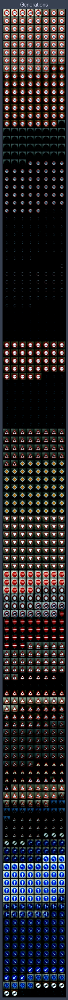

In [59]:
with torch.no_grad():
    print(f"{val_fixed_labels=}")
    grid = torchvision.utils.make_grid(new_images[:1000])
    grid = grid.permute(1, 2, 0)
    plt.figure(figsize=(20,50))
    plt.title(f"Generations")
    plt.imshow(grid)
    plt.axis('off')
    plt.show()

In [60]:
torch.save(new_images.cpu().detach(), "piatek_Staniszewski_Topolski.pt")

In [62]:
new_images.size()

torch.Size([1000, 3, 32, 32])

In [61]:
import numpy as np
from scipy import linalg


def calculate_frechet_distance(distribution_1, distribution_2, eps=1e-6):
    mu1 = np.mean(distribution_1, axis=0)
    sigma1 = np.cov(distribution_1, rowvar=False)

    mu2 = np.mean(distribution_2, axis=0)
    sigma2 = np.cov(distribution_2, rowvar=False)

    """Numpy implementation of the Frechet Distance.
    The Frechet distance between two multivariate Gaussians X_1 ~ N(mu_1, C_1)
    and X_2 ~ N(mu_2, C_2) is
            d^2 = ||mu_1 - mu_2||^2 + Tr(C_1 + C_2 - 2*sqrt(C_1*C_2)).
    Stable version by Dougal J. Sutherland.
    Params:
    -- mu1   : Numpy array containing the activations of a layer of the
               inception net (like returned by the function 'get_predictions')
               for generated samples.
    -- mu2   : The sample mean over activations, precalculated on an
               representative data set.
    -- sigma1: The covariance matrix over activations for generated samples.
    -- sigma2: The covariance matrix over activations, precalculated on an
               representative data set.
    Returns:
    --   : The Frechet Distance.
    """

    mu1 = np.atleast_1d(mu1)
    mu2 = np.atleast_1d(mu2)

    sigma1 = np.atleast_2d(sigma1)
    sigma2 = np.atleast_2d(sigma2)

    assert mu1.shape == mu2.shape, 'Training and test mean vectors have different lengths'
    assert sigma1.shape == sigma2.shape,'Training and test covariances have different dimensions'

    diff = mu1 - mu2

    # Product might be almost singular
    covmean, _ = linalg.sqrtm(sigma1.dot(sigma2), disp=False)
    if not np.isfinite(covmean).all():
        msg = ('fid calculation produces singular product; '
               'adding %s to diagonal of cov estimates') % eps
        print(msg)
        offset = np.eye(sigma1.shape[0]) * eps
        covmean = linalg.sqrtm((sigma1 + offset).dot(sigma2 + offset))

    # Numerical error might give slight imaginary component
    if np.iscomplexobj(covmean):
        if not np.allclose(np.diagonal(covmean).imag, 0, atol=1e-3):
            m = np.max(np.abs(covmean.imag))
            raise ValueError('Imaginary component {}'.format(m))
        covmean = covmean.real

    tr_covmean = np.trace(covmean)

    return (diff.dot(diff) + np.trace(sigma1) +
            np.trace(sigma2) - 2 * tr_covmean)

In [72]:
not_normalized_loader = torch.utils.data.DataLoader(dataset_not_normalized, batch_size=128, shuffle=False)

In [73]:
from inception import InceptionV3
dims = 2048
block_idx = InceptionV3.BLOCK_INDEX_BY_DIM[dims]
model = InceptionV3([block_idx])

generated_dist = model(new_images)[0] #Zakładam że wygenerowane obrazki są już zdenormalizowane

pred_arr = np.empty((len(dataset_not_normalized), dims))
start_idx = 0
for batch, _ in iter(not_normalized_loader):
    batch = batch.cpu()
    with torch.no_grad():
        pred = model(batch)[0]
        pred = pred.squeeze(3).squeeze(2).cpu().numpy()
    pred_arr[start_idx:start_idx + pred.shape[0]] = pred

fid = calculate_frechet_distance(pred_arr.squeeze().numpy(), generated_dist.squeeze().numpy())

ValueError: could not broadcast input array from shape (128,2048,1,1) into shape (128,2048)

In [74]:
pred_arr = np.empty((len(dataset_not_normalized), dims))
start_idx = 0
for batch, _ in iter(not_normalized_loader):
    batch = batch.cpu()
    with torch.no_grad():
        pred = model(batch)[0]
        pred = pred.squeeze(3).squeeze(2).cpu().numpy()
    pred_arr[start_idx:start_idx + pred.shape[0]] = pred

KeyboardInterrupt: 

In [ ]:
pred_arr

latent 128, lr 0.001; latent 64, lr 0.01; latent 64, lr 0.001; Latent 256 lr 0.001; Latent 512 lr 0.1

In [ ]:
fid